In [27]:
import torch, torchvision
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as opt
import torchvision.transforms as transforms
import numpy as np
from PIL import Image
import os, glob
os.environ['CUDA_VISIBLE_DEVICES'] = '0, 1'
from torch.autograd import Variable
from torchvision.datasets import ImageFolder
device = "cuda"

In [95]:
class Mydatasets(torch.utils.data.Dataset):
    def __init__(self, folder, transform = None):
        self.transform = transform
        self.files = glob.glob(os.path.join(folder,'*.jpg'))
        self.images = []
        for fn in self.files:
            try:
                image = Image.open(fn)
            except IOError:
                continue
            self.images.append(image)
    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        out_data = self.images[idx]
        if self.transform:
            out_data = self.transform(out_data)
        return out_data

In [102]:

transform = transforms.Compose([
    transforms.Resize((64, 64)),
    transforms.ToTensor(),
    #transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
])

dataset = Mydatasets(folder="/export/data/dataset/UECFOOD/UECFOOD100/23/", transform=transform)
#dataset = torchvision.datasets.MNIST(root="dataset",download=True)v
#dataset = ImageFolder(root="/export/data/dataset/UECFOOD/UECFOOD100",transform=transform)

In [103]:
dataset[0]


tensor([[[0.1490, 0.4000, 0.7451,  ..., 0.0353, 0.0314, 0.0196],
         [0.1255, 0.3373, 0.7255,  ..., 0.0157, 0.0118, 0.0118],
         [0.1255, 0.2471, 0.6784,  ..., 0.0118, 0.0118, 0.0118],
         ...,
         [0.0314, 0.0392, 0.0471,  ..., 0.1843, 0.2118, 0.1255],
         [0.0471, 0.0588, 0.0745,  ..., 0.1647, 0.2157, 0.1373],
         [0.0627, 0.0745, 0.0824,  ..., 0.1608, 0.2196, 0.1529]],

        [[0.1137, 0.3333, 0.6863,  ..., 0.0314, 0.0275, 0.0118],
         [0.1020, 0.2745, 0.6588,  ..., 0.0078, 0.0039, 0.0039],
         [0.0941, 0.1961, 0.6078,  ..., 0.0039, 0.0039, 0.0039],
         ...,
         [0.0235, 0.0314, 0.0431,  ..., 0.1647, 0.1922, 0.1098],
         [0.0392, 0.0510, 0.0667,  ..., 0.1451, 0.2000, 0.1216],
         [0.0588, 0.0706, 0.0667,  ..., 0.1373, 0.2000, 0.1412]],

        [[0.0941, 0.1922, 0.4941,  ..., 0.0235, 0.0235, 0.0118],
         [0.0784, 0.1608, 0.4588,  ..., 0.0157, 0.0157, 0.0157],
         [0.0745, 0.1255, 0.4000,  ..., 0.0157, 0.0157, 0.

In [104]:
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()        
        self.main = nn.Sequential(

            nn.ConvTranspose2d(100, 256, 4, 1, 0, bias=False),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.1),

            nn.ConvTranspose2d(256, 128, 4, 2, 1, bias=False),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.1),

            nn.ConvTranspose2d(128, 64, 4, 2, 1, bias=False),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.1),

            nn.ConvTranspose2d(64, 32, 4, 2, 1, bias=False),
            nn.BatchNorm2d(32),
            nn.LeakyReLU(0.1),

            nn.ConvTranspose2d(32, 3, 4, 2, 1, bias=False),
            nn.Tanh()
        )
    def forward(self, x):
        return self.main(x)

In [105]:
g = Generator()
t=Variable(torch.zeros((1,100,1,1)))
fake = g(t)
print(fake.shape)

torch.Size([1, 3, 64, 64])


In [110]:
from torch.nn.utils.spectral_norm import spectral_norm

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()        
        self.main = nn.Sequential(
            spectral_norm(nn.Conv2d(3, 64, stride=2, kernel_size=3, padding=True)),
            nn.LeakyReLU(0.1),
            spectral_norm(nn.Conv2d(64, 128, stride=2, kernel_size=3, padding=True)),
            nn.LeakyReLU(0.1),
            spectral_norm(nn.Conv2d(128, 256, stride=2, kernel_size=3, padding=True)),
            nn.LeakyReLU(0.1),
            spectral_norm(nn.Conv2d(256, 512, stride=2, kernel_size=3, padding=True)),
            nn.LeakyReLU(0.1),
            nn.AdaptiveAvgPool2d(output_size=(1,1)),
            nn.Flatten(),
            nn.Linear(512,1),
            
        )
    def forward(self, x):
        return self.main(x).squeeze_(1)
#d=Discriminator()
#out = d(fake)
#lossfunc = nn.CrossEntropyLoss()
#lossfunc = nn.BCEWithLogitsLoss()
lossfunc = nn.HingeEmbeddingLoss()
#loss = lossfunc(out, Variable(torch.zeros((1),dtype=torch.long)))
#loss.backward()

tensor(-9.8530e-05, device='cuda:0', grad_fn=<NegBackward>) tensor(2.0242, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


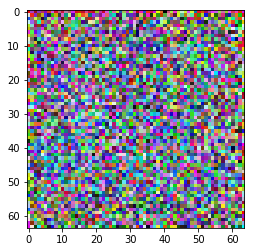

tensor(0.8550, device='cuda:0', grad_fn=<NegBackward>) tensor(0.1909, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


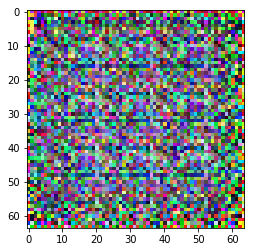

tensor(0.6302, device='cuda:0', grad_fn=<NegBackward>) tensor(0.6779, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


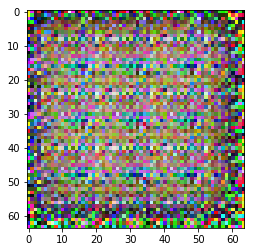

tensor(0.5430, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1788, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


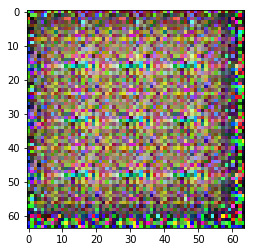

tensor(0.6138, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3032, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


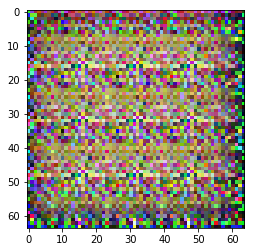

tensor(0.8730, device='cuda:0', grad_fn=<NegBackward>) tensor(1.9377, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


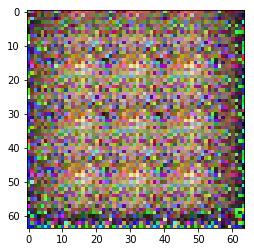

tensor(0.2719, device='cuda:0', grad_fn=<NegBackward>) tensor(1.8816, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


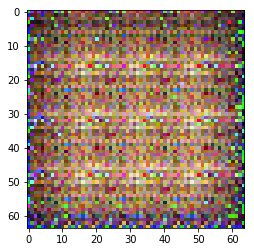

tensor(-0.0957, device='cuda:0', grad_fn=<NegBackward>) tensor(1.9218, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


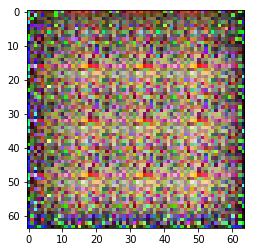

tensor(0.4034, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5834, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


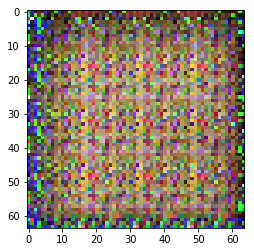

tensor(0.8154, device='cuda:0', grad_fn=<NegBackward>) tensor(1.8622, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


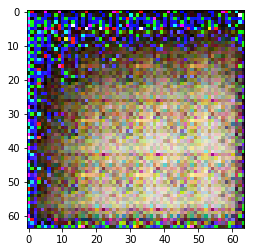

tensor(-0.1583, device='cuda:0', grad_fn=<NegBackward>) tensor(1.8632, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


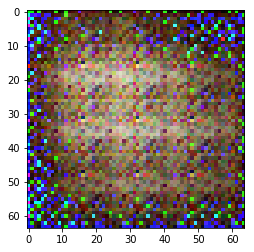

tensor(0.7146, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4830, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


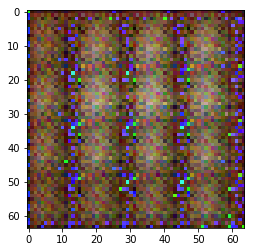

tensor(0.1223, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4299, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


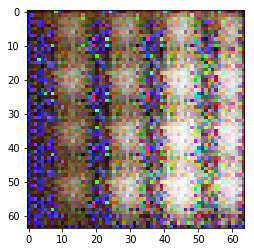

tensor(0.6010, device='cuda:0', grad_fn=<NegBackward>) tensor(1.8068, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


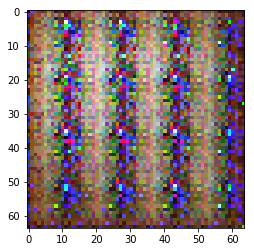

tensor(0.6936, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5912, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


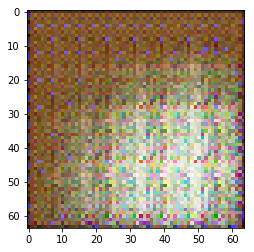

tensor(0.0910, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5835, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


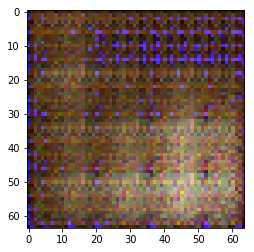

tensor(-0.2314, device='cuda:0', grad_fn=<NegBackward>) tensor(1.6463, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


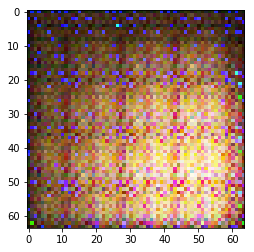

tensor(-0.3594, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5913, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


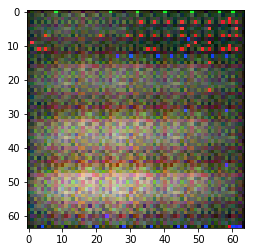

tensor(-0.1576, device='cuda:0', grad_fn=<NegBackward>) tensor(1.7526, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


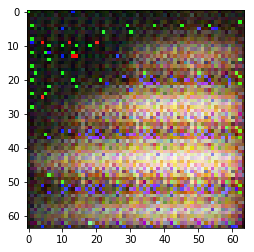

tensor(-0.0449, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5156, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


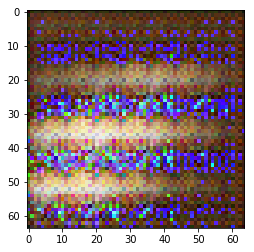

tensor(0.3965, device='cuda:0', grad_fn=<NegBackward>) tensor(1.9364, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


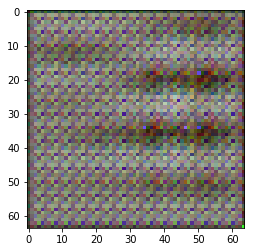

tensor(-0.1942, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4302, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


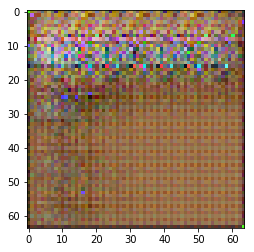

tensor(0.1745, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4980, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


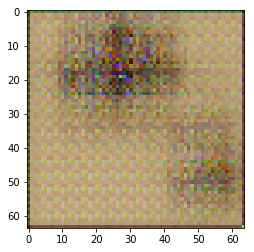

tensor(0.3610, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0501, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


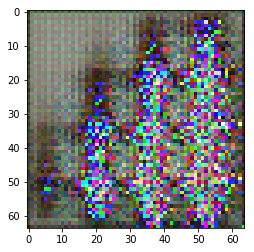

tensor(1.2730, device='cuda:0', grad_fn=<NegBackward>) tensor(2.7474, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


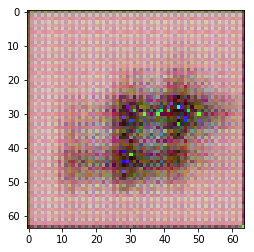

tensor(0.8921, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5132, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


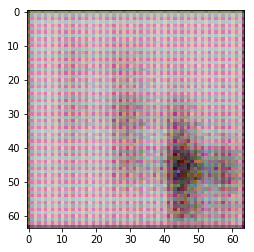

tensor(0.4679, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1851, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


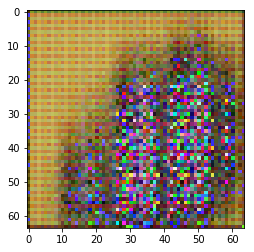

tensor(0.3786, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1115, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


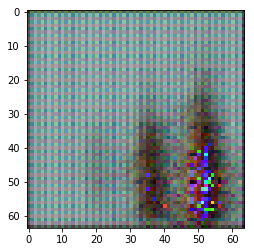

tensor(0.4844, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1905, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


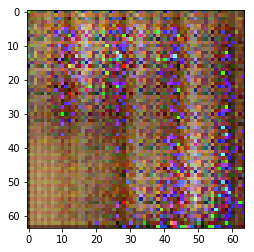

tensor(1.0129, device='cuda:0', grad_fn=<NegBackward>) tensor(0.8788, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


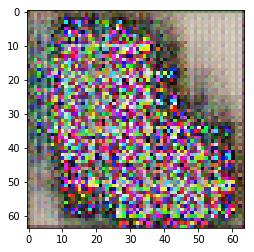

tensor(0.7291, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0727, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


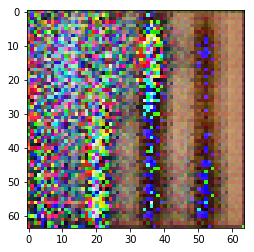

tensor(-0.1546, device='cuda:0', grad_fn=<NegBackward>) tensor(1.9617, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


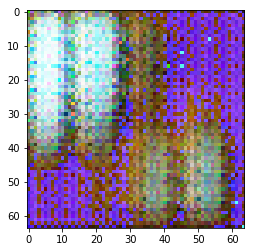

tensor(0.4294, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5659, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


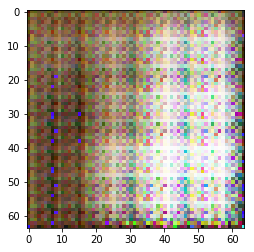

tensor(0.3886, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3608, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


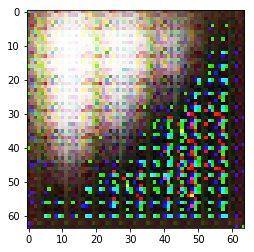

tensor(0.5870, device='cuda:0', grad_fn=<NegBackward>) tensor(2.1161, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


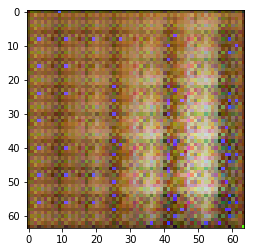

tensor(-0.3792, device='cuda:0', grad_fn=<NegBackward>) tensor(2.0209, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


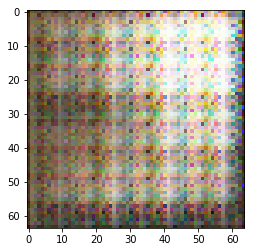

tensor(1.1522, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0877, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


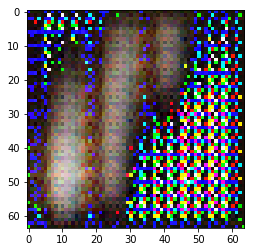

tensor(0.3768, device='cuda:0', grad_fn=<NegBackward>) tensor(2.4060, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


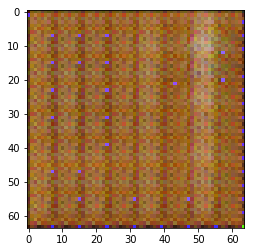

tensor(0.8511, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1455, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


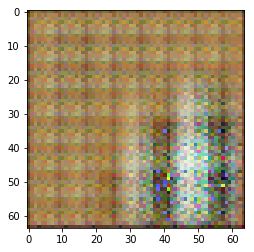

tensor(0.8709, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9893, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


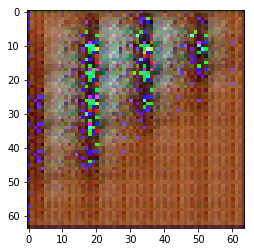

tensor(1.1443, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3210, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


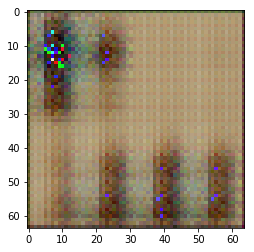

tensor(0.2510, device='cuda:0', grad_fn=<NegBackward>) tensor(0.8064, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


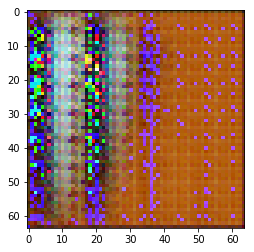

tensor(-0.7109, device='cuda:0', grad_fn=<NegBackward>) tensor(1.7618, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


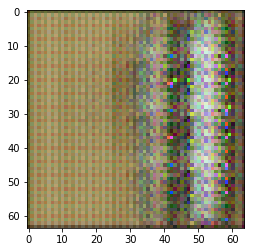

tensor(0.5480, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0471, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


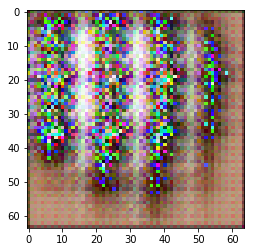

tensor(0.0985, device='cuda:0', grad_fn=<NegBackward>) tensor(1.8725, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


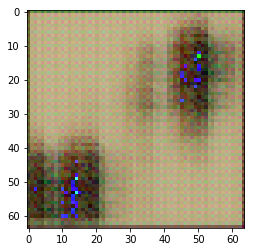

tensor(0.1544, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3476, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


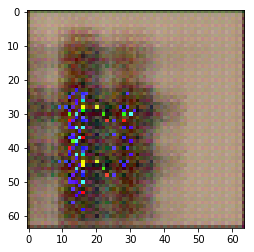

tensor(0.8913, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1743, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


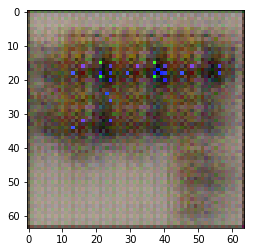

tensor(0.5108, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2676, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


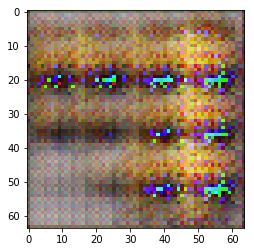

tensor(-0.9479, device='cuda:0', grad_fn=<NegBackward>) tensor(2.5300, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


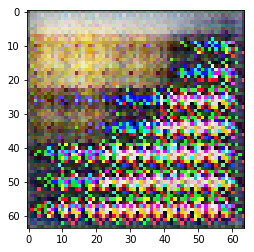

tensor(0.3921, device='cuda:0', grad_fn=<NegBackward>) tensor(2.1208, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


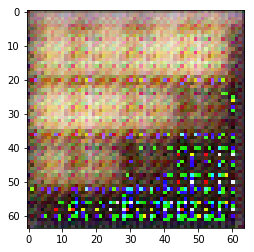

tensor(0.8235, device='cuda:0', grad_fn=<NegBackward>) tensor(1.6962, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


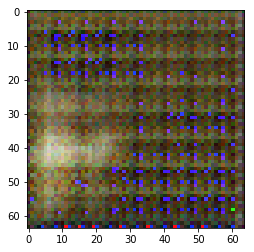

tensor(-0.5592, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5768, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


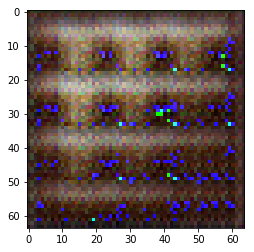

tensor(1.0225, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4665, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


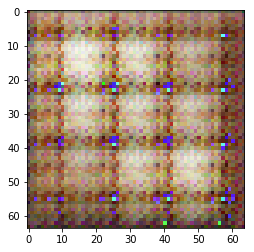

tensor(1.2944, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0078, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


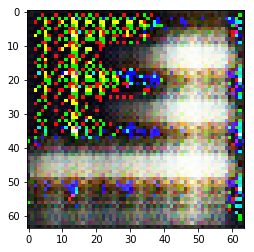

tensor(0.1975, device='cuda:0', grad_fn=<NegBackward>) tensor(2.4756, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


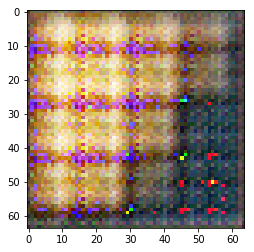

tensor(-0.1689, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5260, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


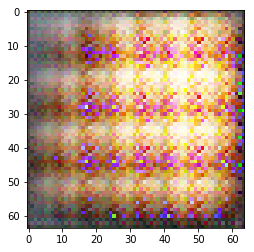

tensor(0.9817, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9344, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


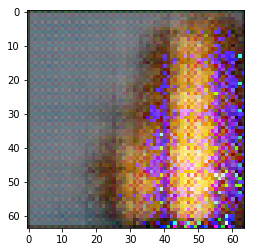

tensor(0.1689, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4702, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


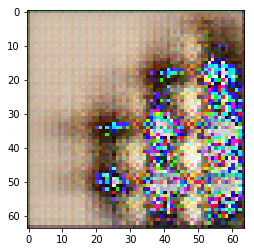

tensor(0.0171, device='cuda:0', grad_fn=<NegBackward>) tensor(1.7464, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


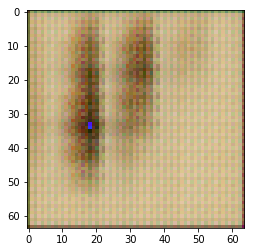

tensor(0.9272, device='cuda:0', grad_fn=<NegBackward>) tensor(0.5267, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


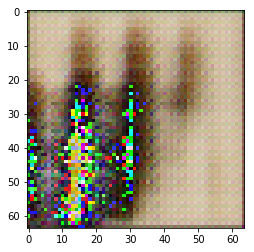

tensor(0.3838, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0939, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


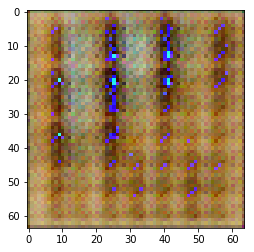

tensor(0.5894, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3308, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


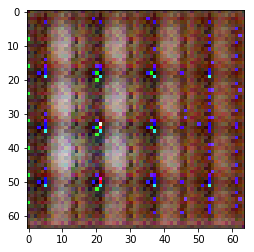

tensor(-0.0439, device='cuda:0', grad_fn=<NegBackward>) tensor(1.7671, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


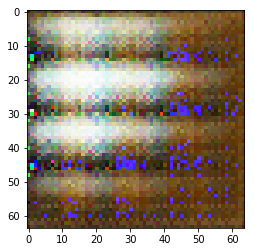

tensor(-0.2516, device='cuda:0', grad_fn=<NegBackward>) tensor(2.1665, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


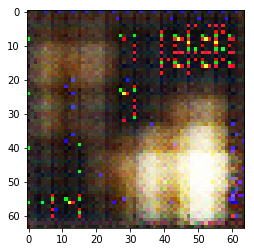

tensor(0.6940, device='cuda:0', grad_fn=<NegBackward>) tensor(2.2285, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


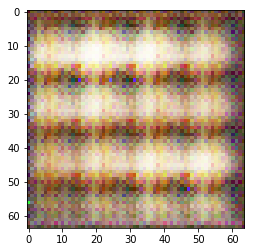

tensor(0.2244, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2103, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


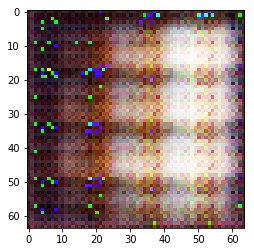

tensor(0.2865, device='cuda:0', grad_fn=<NegBackward>) tensor(2.1662, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


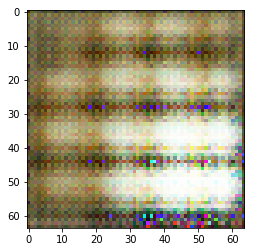

tensor(0.7395, device='cuda:0', grad_fn=<NegBackward>) tensor(0.8413, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


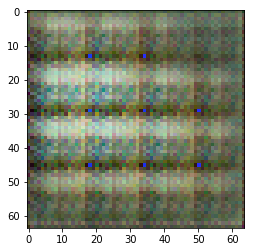

tensor(0.1282, device='cuda:0', grad_fn=<NegBackward>) tensor(1.6368, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


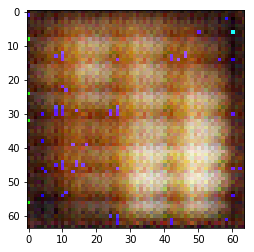

tensor(0.7942, device='cuda:0', grad_fn=<NegBackward>) tensor(1.8188, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


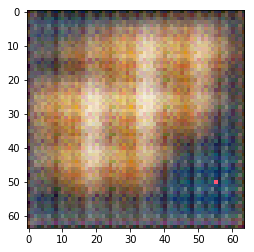

tensor(0.5643, device='cuda:0', grad_fn=<NegBackward>) tensor(0.8158, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


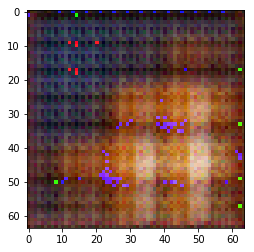

tensor(1.2908, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5568, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


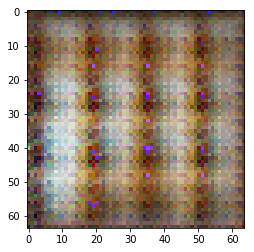

tensor(1.1095, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4590, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


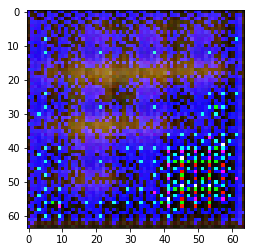

tensor(0.2752, device='cuda:0', grad_fn=<NegBackward>) tensor(1.7184, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


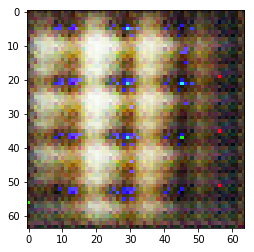

tensor(0.1823, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1959, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


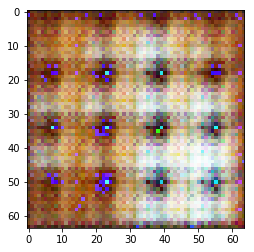

tensor(0.7615, device='cuda:0', grad_fn=<NegBackward>) tensor(1.8968, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


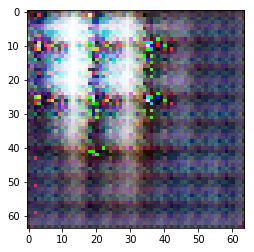

tensor(0.8636, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0176, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


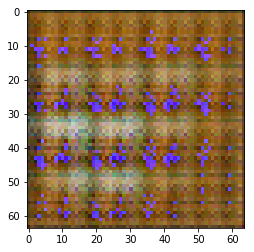

tensor(-0.3261, device='cuda:0', grad_fn=<NegBackward>) tensor(1.6085, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


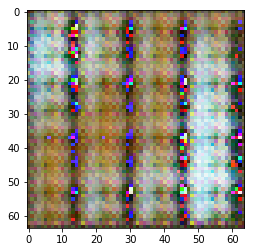

tensor(0.7659, device='cuda:0', grad_fn=<NegBackward>) tensor(0.6619, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


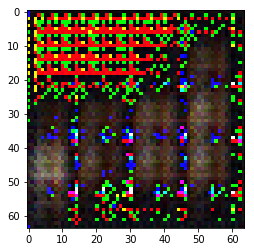

tensor(0.2031, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5130, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


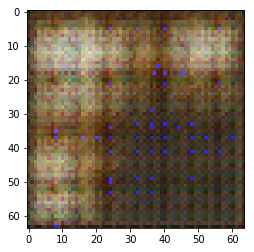

tensor(0.8991, device='cuda:0', grad_fn=<NegBackward>) tensor(1.9546, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


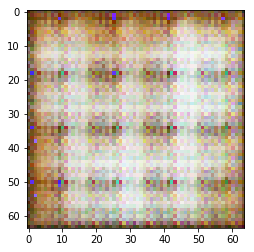

tensor(0.6436, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9580, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


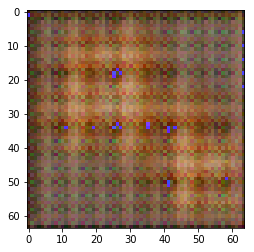

tensor(1.4257, device='cuda:0', grad_fn=<NegBackward>) tensor(0.6848, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


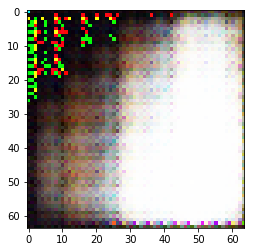

tensor(0.5565, device='cuda:0', grad_fn=<NegBackward>) tensor(2.6203, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


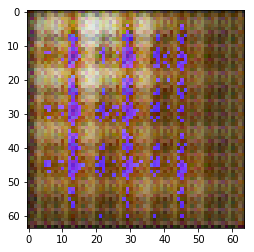

tensor(0.3854, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9308, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


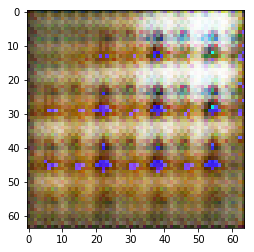

tensor(0.6155, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9949, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


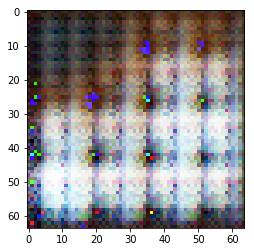

tensor(0.4119, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5253, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


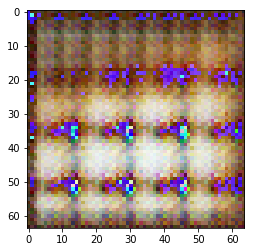

tensor(0.5226, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2998, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


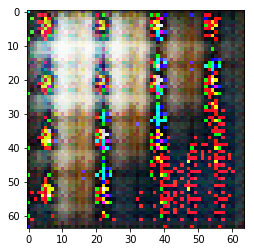

tensor(0.1834, device='cuda:0', grad_fn=<NegBackward>) tensor(2.4411, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


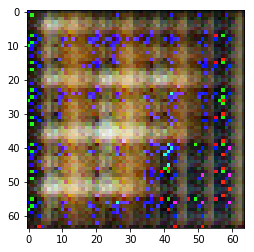

tensor(0.9661, device='cuda:0', grad_fn=<NegBackward>) tensor(1.8169, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


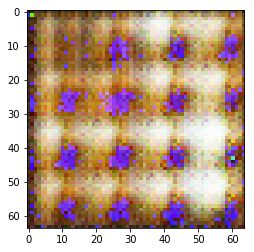

tensor(0.9093, device='cuda:0', grad_fn=<NegBackward>) tensor(0.8624, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


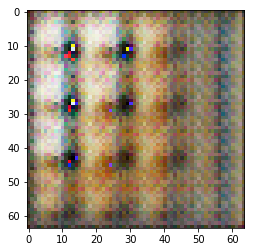

tensor(0.6834, device='cuda:0', grad_fn=<NegBackward>) tensor(0.6214, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


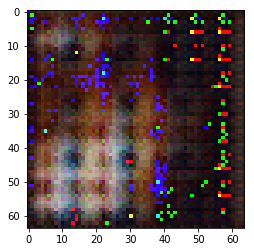

tensor(0.9315, device='cuda:0', grad_fn=<NegBackward>) tensor(1.8742, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


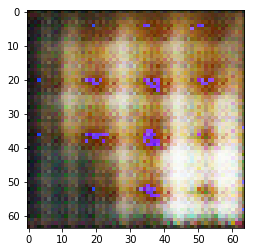

tensor(0.4385, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9128, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


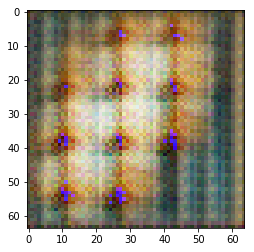

tensor(0.9729, device='cuda:0', grad_fn=<NegBackward>) tensor(0.3938, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


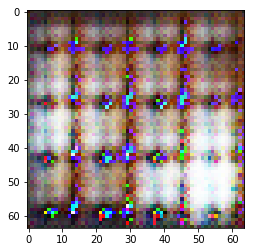

tensor(-0.0212, device='cuda:0', grad_fn=<NegBackward>) tensor(2.3347, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


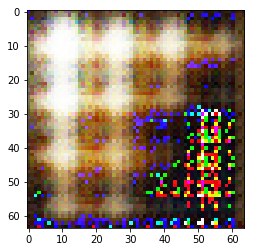

tensor(0.2973, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2533, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


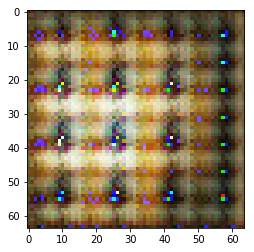

tensor(0.4649, device='cuda:0', grad_fn=<NegBackward>) tensor(1.6072, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


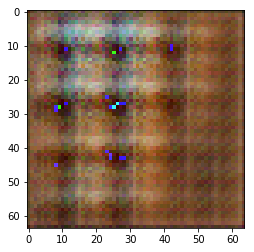

tensor(0.0077, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3046, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


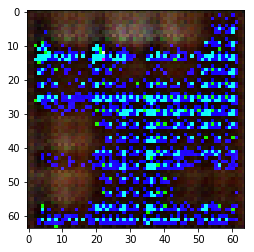

tensor(-0.2239, device='cuda:0', grad_fn=<NegBackward>) tensor(2.3730, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


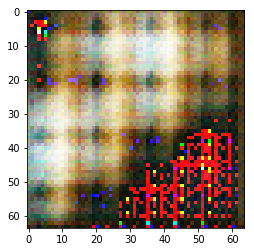

tensor(0.8017, device='cuda:0', grad_fn=<NegBackward>) tensor(2.1203, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


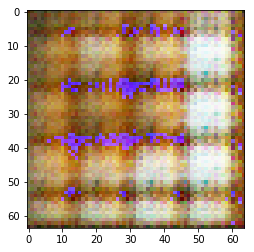

tensor(0.6595, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5925, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


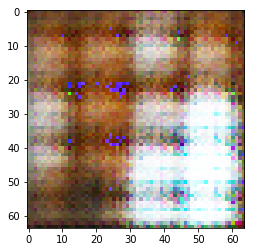

tensor(0.3119, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2134, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


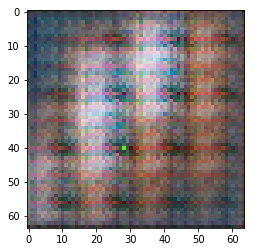

tensor(-0.7658, device='cuda:0', grad_fn=<NegBackward>) tensor(2.1464, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


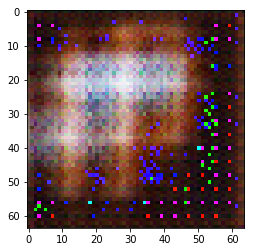

tensor(0.5060, device='cuda:0', grad_fn=<NegBackward>) tensor(1.6467, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


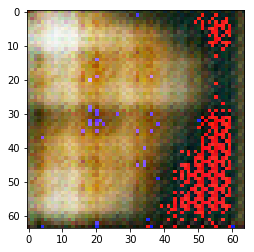

tensor(0.1470, device='cuda:0', grad_fn=<NegBackward>) tensor(1.6992, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


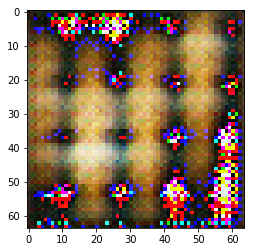

tensor(-0.6440, device='cuda:0', grad_fn=<NegBackward>) tensor(2.7105, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


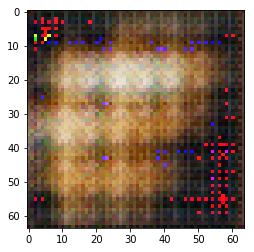

tensor(0.5206, device='cuda:0', grad_fn=<NegBackward>) tensor(1.6964, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


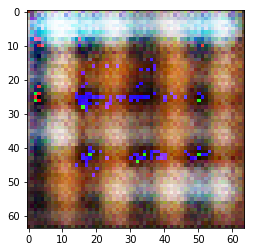

tensor(0.4800, device='cuda:0', grad_fn=<NegBackward>) tensor(2.2421, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


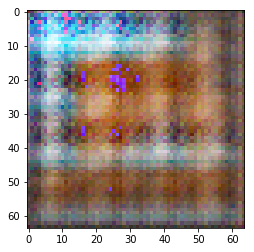

tensor(0.4765, device='cuda:0', grad_fn=<NegBackward>) tensor(0.6060, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


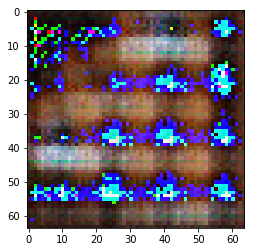

tensor(-0.2727, device='cuda:0', grad_fn=<NegBackward>) tensor(2.3903, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


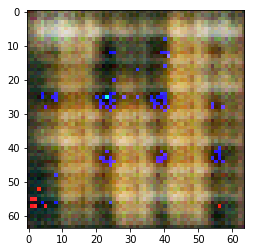

tensor(0.8131, device='cuda:0', grad_fn=<NegBackward>) tensor(2.1158, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


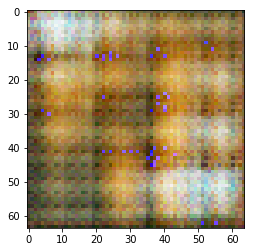

tensor(0.2683, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1692, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


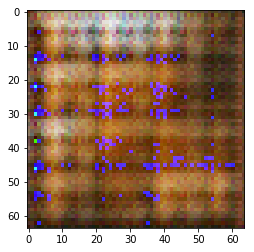

tensor(0.3897, device='cuda:0', grad_fn=<NegBackward>) tensor(1.8844, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


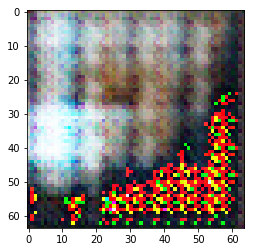

tensor(0.9537, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5830, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


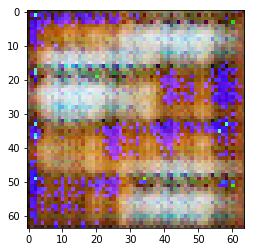

tensor(0.6332, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3705, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


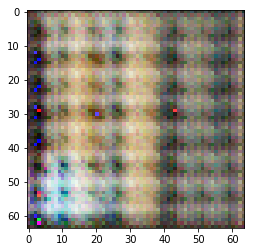

tensor(0.0967, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9360, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


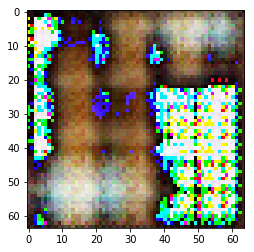

tensor(-0.2313, device='cuda:0', grad_fn=<NegBackward>) tensor(2.6525, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


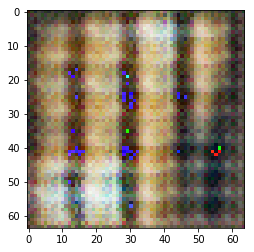

tensor(0.7851, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5377, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


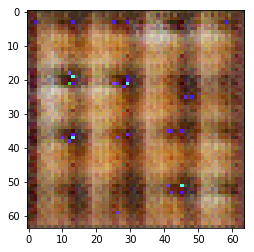

tensor(0.9569, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4508, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


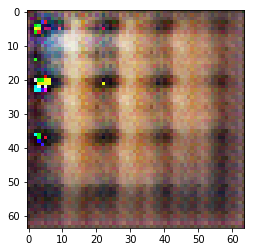

tensor(0.2354, device='cuda:0', grad_fn=<NegBackward>) tensor(1.8483, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


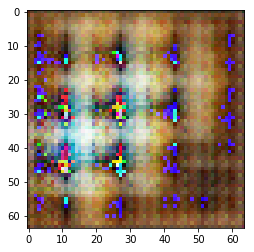

tensor(0.8093, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3561, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


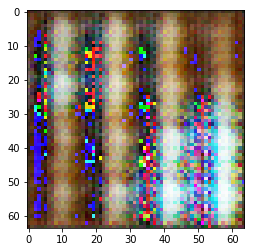

tensor(-0.8118, device='cuda:0', grad_fn=<NegBackward>) tensor(2.4906, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


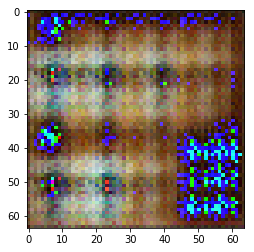

tensor(0.7558, device='cuda:0', grad_fn=<NegBackward>) tensor(0.7055, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


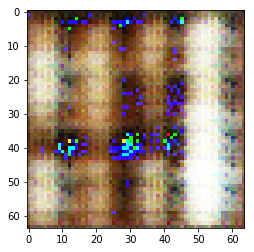

tensor(0.8932, device='cuda:0', grad_fn=<NegBackward>) tensor(2.4283, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


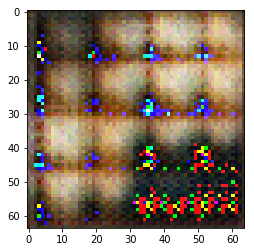

tensor(0.7211, device='cuda:0', grad_fn=<NegBackward>) tensor(1.6104, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


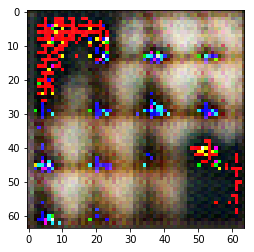

tensor(0.4632, device='cuda:0', grad_fn=<NegBackward>) tensor(1.6847, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


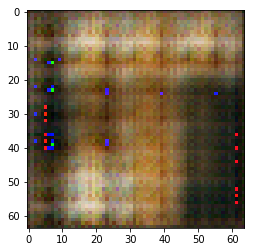

tensor(-0.1785, device='cuda:0', grad_fn=<NegBackward>) tensor(2.0568, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


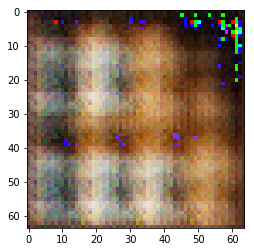

tensor(0.1693, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4146, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


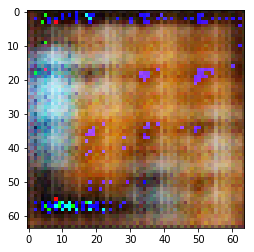

tensor(-0.0972, device='cuda:0', grad_fn=<NegBackward>) tensor(1.6985, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


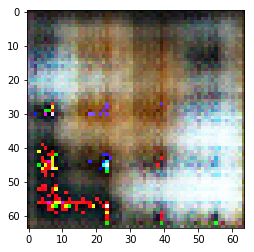

tensor(0.2534, device='cuda:0', grad_fn=<NegBackward>) tensor(1.9561, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


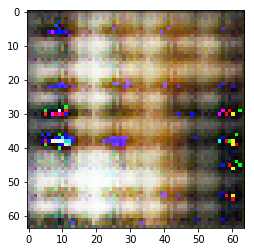

tensor(0.7059, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3960, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


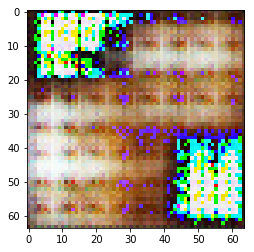

tensor(-0.2140, device='cuda:0', grad_fn=<NegBackward>) tensor(1.6037, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


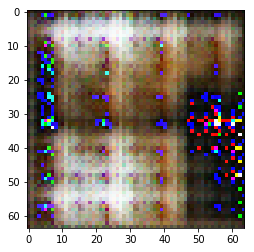

tensor(-1.1062, device='cuda:0', grad_fn=<NegBackward>) tensor(2.3607, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


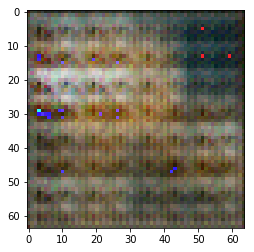

tensor(0.8862, device='cuda:0', grad_fn=<NegBackward>) tensor(0.5158, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


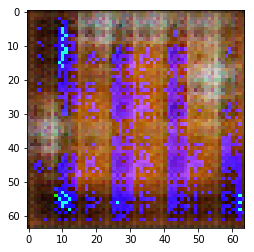

tensor(0.9041, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5405, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


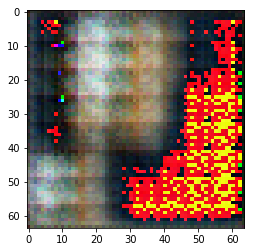

tensor(-0.0440, device='cuda:0', grad_fn=<NegBackward>) tensor(1.8556, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


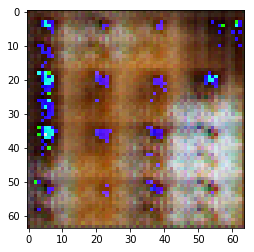

tensor(0.4011, device='cuda:0', grad_fn=<NegBackward>) tensor(0.6995, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


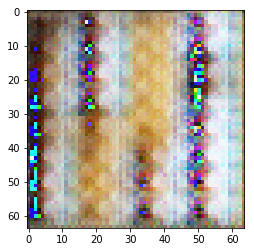

tensor(0.0987, device='cuda:0', grad_fn=<NegBackward>) tensor(1.7935, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


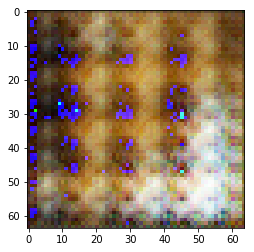

tensor(1.3315, device='cuda:0', grad_fn=<NegBackward>) tensor(0.5197, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


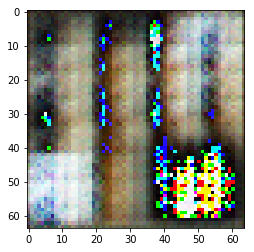

tensor(0.5781, device='cuda:0', grad_fn=<NegBackward>) tensor(2.2095, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


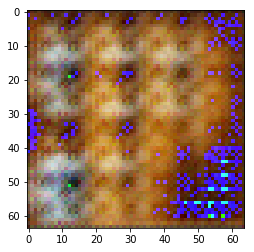

tensor(1.3775, device='cuda:0', grad_fn=<NegBackward>) tensor(0.7669, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


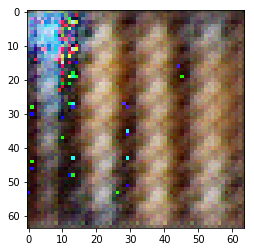

tensor(-0.0093, device='cuda:0', grad_fn=<NegBackward>) tensor(2.5660, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


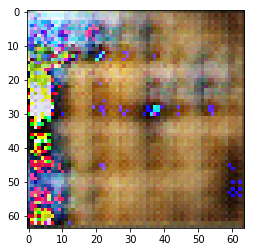

tensor(0.7713, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4598, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


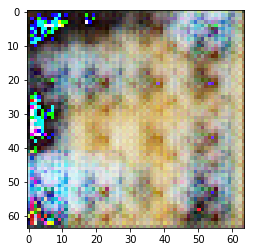

tensor(0.8068, device='cuda:0', grad_fn=<NegBackward>) tensor(2.3808, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


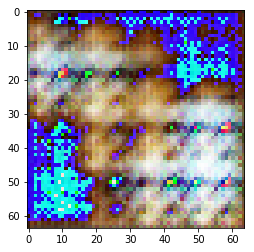

tensor(0.3973, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0870, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


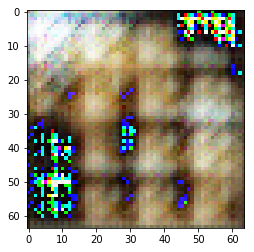

tensor(-0.1550, device='cuda:0', grad_fn=<NegBackward>) tensor(1.9741, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


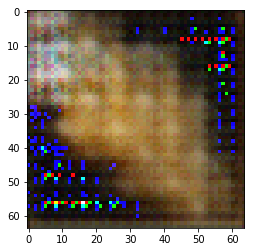

tensor(0.8136, device='cuda:0', grad_fn=<NegBackward>) tensor(2.1491, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


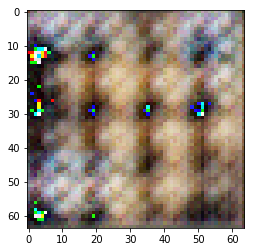

tensor(0.2801, device='cuda:0', grad_fn=<NegBackward>) tensor(1.7550, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


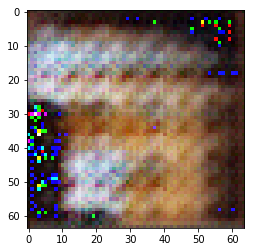

tensor(0.1453, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0698, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


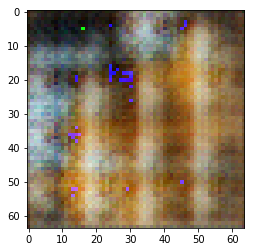

tensor(0.7143, device='cuda:0', grad_fn=<NegBackward>) tensor(2.7275, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


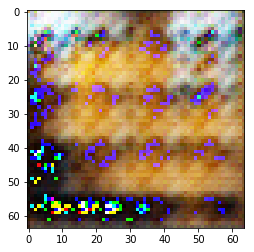

tensor(0.5814, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2670, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


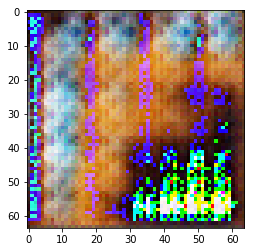

tensor(1.1859, device='cuda:0', grad_fn=<NegBackward>) tensor(0.7040, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


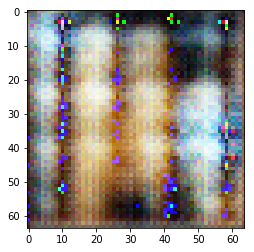

tensor(1.1592, device='cuda:0', grad_fn=<NegBackward>) tensor(0.8289, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


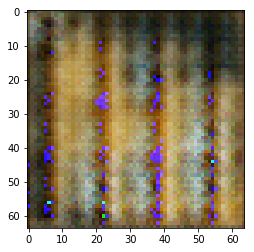

tensor(0.1560, device='cuda:0', grad_fn=<NegBackward>) tensor(2.1309, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


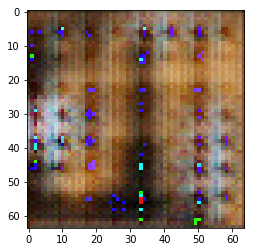

tensor(1.1707, device='cuda:0', grad_fn=<NegBackward>) tensor(1.7161, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


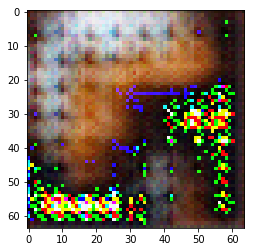

tensor(0.1131, device='cuda:0', grad_fn=<NegBackward>) tensor(1.9190, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


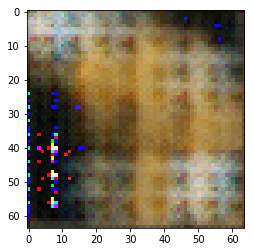

tensor(0.1734, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9812, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


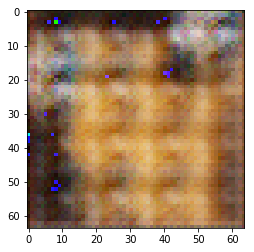

tensor(0.6748, device='cuda:0', grad_fn=<NegBackward>) tensor(0.7523, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


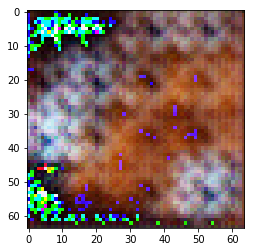

tensor(0.4164, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0120, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


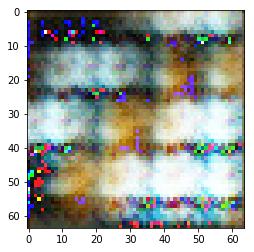

tensor(0.4090, device='cuda:0', grad_fn=<NegBackward>) tensor(1.9042, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


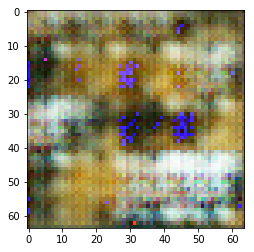

tensor(0.7285, device='cuda:0', grad_fn=<NegBackward>) tensor(0.7315, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


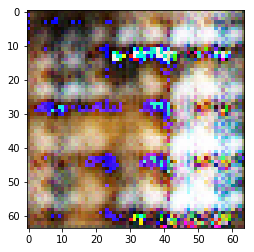

tensor(0.2037, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9332, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


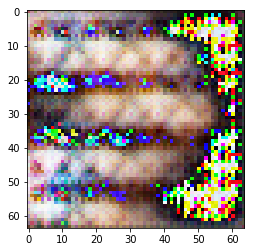

tensor(0.9032, device='cuda:0', grad_fn=<NegBackward>) tensor(2.0437, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


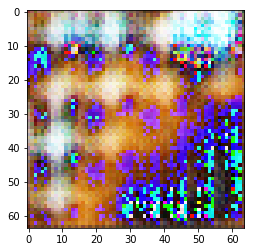

tensor(0.5301, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0819, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


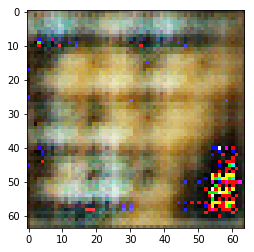

tensor(-0.4454, device='cuda:0', grad_fn=<NegBackward>) tensor(2.0676, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


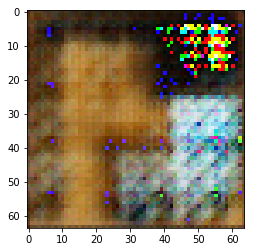

tensor(0.8771, device='cuda:0', grad_fn=<NegBackward>) tensor(2.2255, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


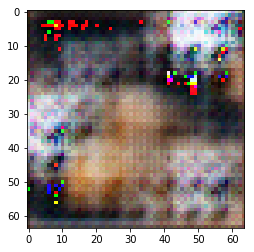

tensor(0.2555, device='cuda:0', grad_fn=<NegBackward>) tensor(1.8726, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


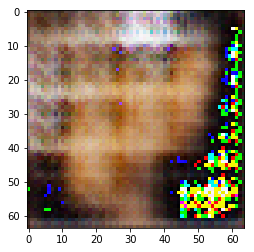

tensor(0.2497, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0753, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


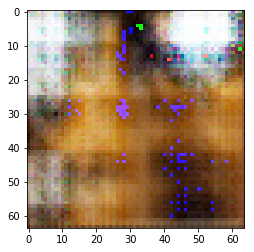

tensor(0.7896, device='cuda:0', grad_fn=<NegBackward>) tensor(2.1511, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


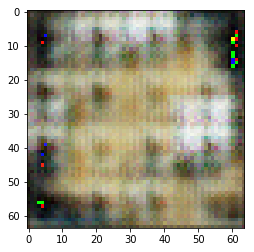

tensor(-0.0307, device='cuda:0', grad_fn=<NegBackward>) tensor(1.9148, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


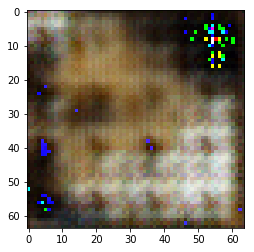

tensor(-0.3597, device='cuda:0', grad_fn=<NegBackward>) tensor(1.6154, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


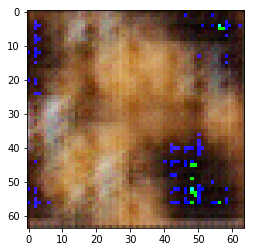

tensor(-0.6900, device='cuda:0', grad_fn=<NegBackward>) tensor(1.7739, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


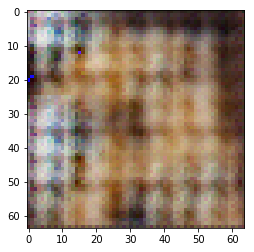

tensor(1.3648, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9775, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


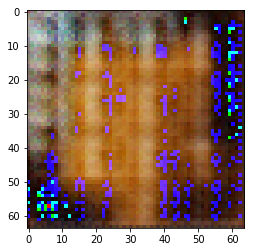

tensor(0.4490, device='cuda:0', grad_fn=<NegBackward>) tensor(2.7898, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


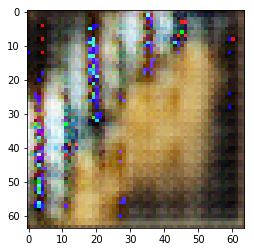

tensor(0.7463, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5305, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


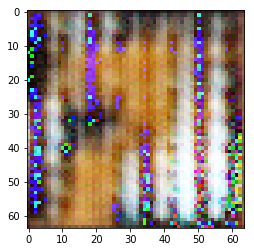

tensor(0.8367, device='cuda:0', grad_fn=<NegBackward>) tensor(0.8474, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


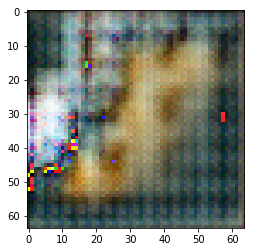

tensor(0.6192, device='cuda:0', grad_fn=<NegBackward>) tensor(1.6852, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


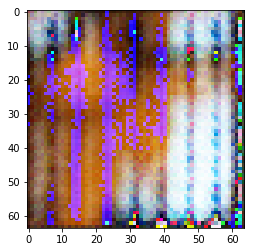

tensor(0.3051, device='cuda:0', grad_fn=<NegBackward>) tensor(0.8388, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


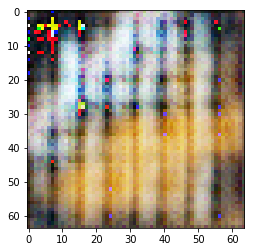

tensor(-0.2040, device='cuda:0', grad_fn=<NegBackward>) tensor(1.7413, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


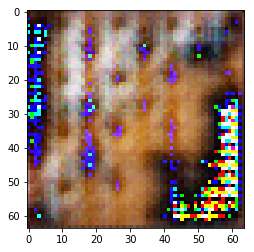

tensor(0.6506, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2144, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


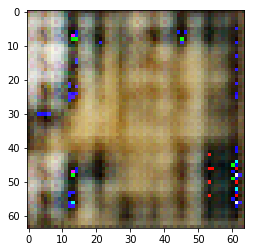

tensor(0.7487, device='cuda:0', grad_fn=<NegBackward>) tensor(0.6801, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


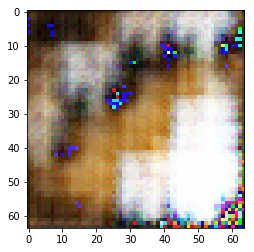

tensor(0.7839, device='cuda:0', grad_fn=<NegBackward>) tensor(2.5234, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


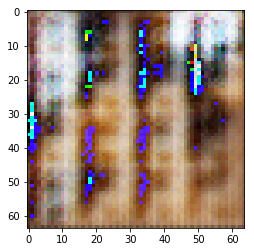

tensor(1.2527, device='cuda:0', grad_fn=<NegBackward>) tensor(0.4476, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


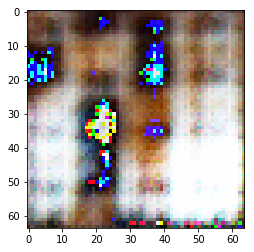

tensor(0.0216, device='cuda:0', grad_fn=<NegBackward>) tensor(2.2621, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


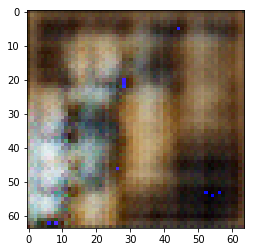

tensor(0.5988, device='cuda:0', grad_fn=<NegBackward>) tensor(0.6962, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


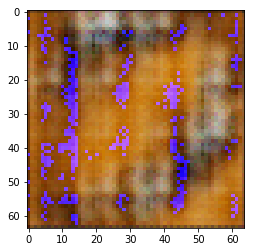

tensor(0.6315, device='cuda:0', grad_fn=<NegBackward>) tensor(1.7034, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


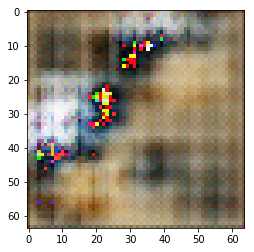

tensor(0.0579, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4223, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


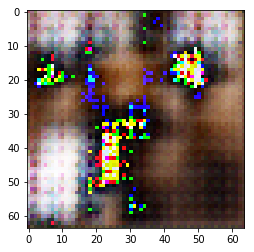

tensor(0.7226, device='cuda:0', grad_fn=<NegBackward>) tensor(2.0262, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


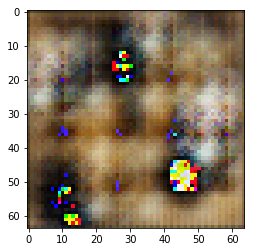

tensor(0.4570, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9210, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


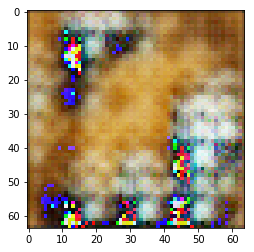

tensor(0.6189, device='cuda:0', grad_fn=<NegBackward>) tensor(1.9538, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


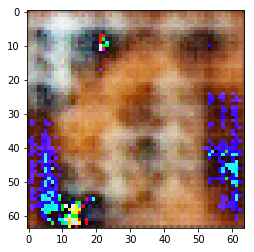

tensor(0.9178, device='cuda:0', grad_fn=<NegBackward>) tensor(0.7487, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


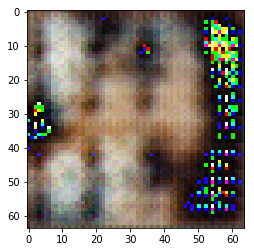

tensor(-0.7084, device='cuda:0', grad_fn=<NegBackward>) tensor(2.9048, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


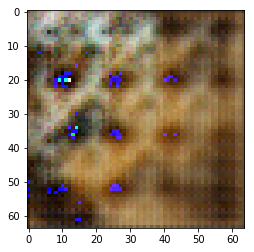

tensor(0.9689, device='cuda:0', grad_fn=<NegBackward>) tensor(0.2635, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


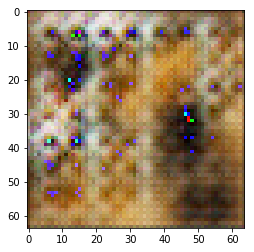

tensor(-0.6034, device='cuda:0', grad_fn=<NegBackward>) tensor(2.6540, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


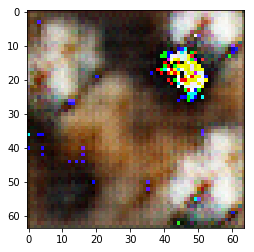

tensor(0.4214, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9912, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


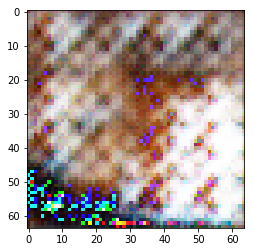

tensor(0.0506, device='cuda:0', grad_fn=<NegBackward>) tensor(2.1694, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


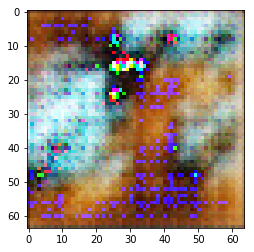

tensor(0.5635, device='cuda:0', grad_fn=<NegBackward>) tensor(1.6842, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


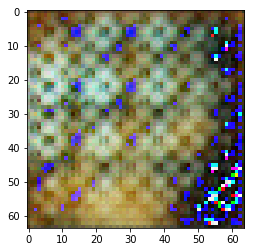

tensor(-0.1301, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3440, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


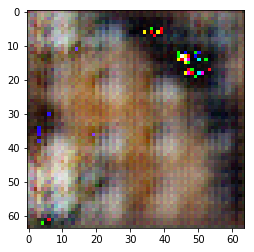

tensor(1.0085, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9889, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


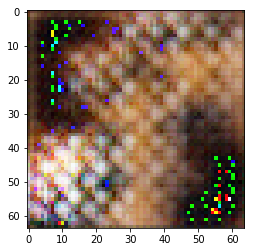

tensor(0.6628, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4824, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


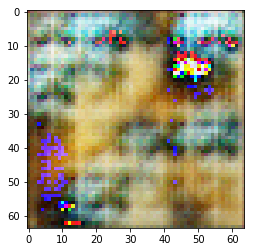

tensor(0.1940, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3009, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


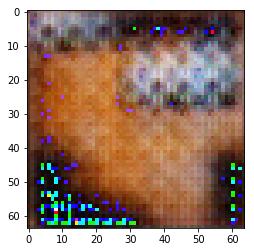

tensor(0.2901, device='cuda:0', grad_fn=<NegBackward>) tensor(1.8415, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


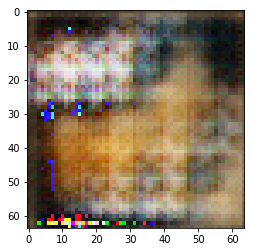

tensor(0.3594, device='cuda:0', grad_fn=<NegBackward>) tensor(1.9986, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


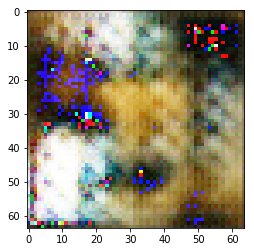

tensor(0.6093, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0436, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


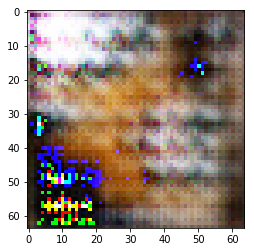

tensor(-0.4343, device='cuda:0', grad_fn=<NegBackward>) tensor(2.5689, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


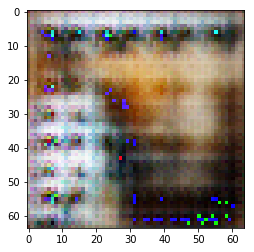

tensor(0.8491, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1907, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


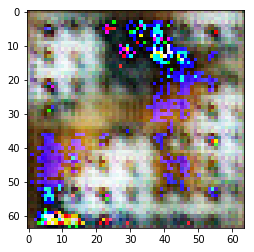

tensor(0.2818, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0817, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


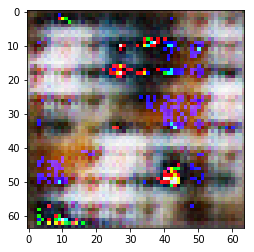

tensor(0.3123, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4673, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


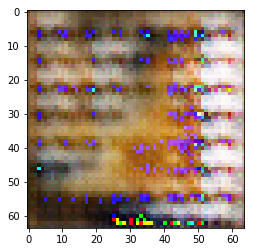

tensor(0.5825, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3148, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


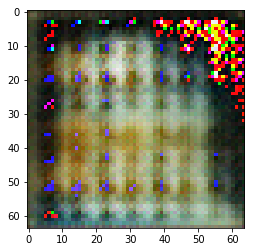

tensor(0.9974, device='cuda:0', grad_fn=<NegBackward>) tensor(1.6914, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


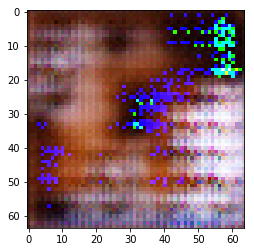

tensor(0.7966, device='cuda:0', grad_fn=<NegBackward>) tensor(0.6638, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


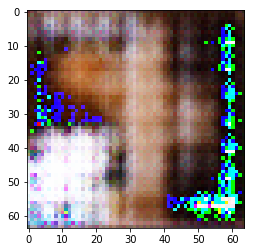

tensor(0.7198, device='cuda:0', grad_fn=<NegBackward>) tensor(2.2555, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


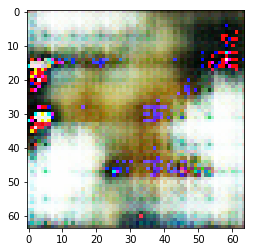

tensor(-0.0513, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1991, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


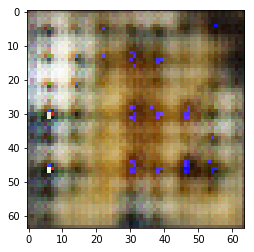

tensor(0.1572, device='cuda:0', grad_fn=<NegBackward>) tensor(1.9332, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


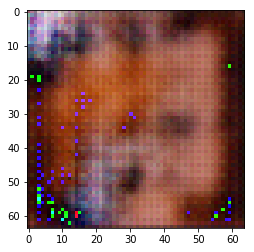

tensor(0.3608, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4801, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


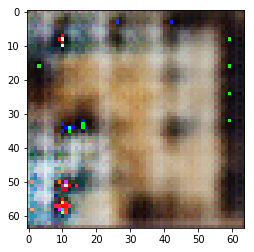

tensor(0.0181, device='cuda:0', grad_fn=<NegBackward>) tensor(2.7167, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


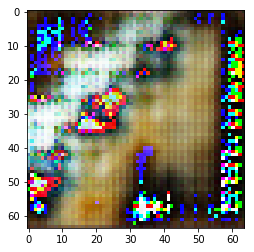

tensor(0.1859, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1331, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


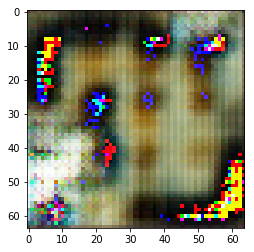

tensor(0.0348, device='cuda:0', grad_fn=<NegBackward>) tensor(1.8166, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


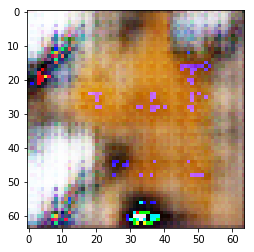

tensor(0.9305, device='cuda:0', grad_fn=<NegBackward>) tensor(2.2322, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


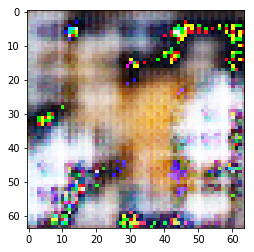

tensor(0.7535, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1552, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


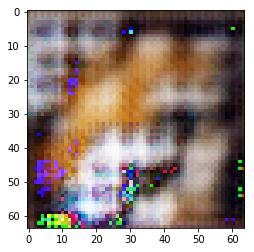

tensor(0.9434, device='cuda:0', grad_fn=<NegBackward>) tensor(0.8856, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


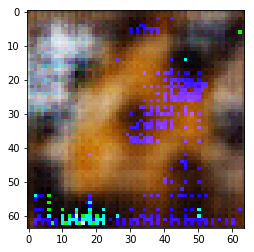

tensor(0.6198, device='cuda:0', grad_fn=<NegBackward>) tensor(2.0651, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


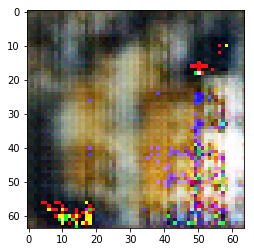

tensor(0.5482, device='cuda:0', grad_fn=<NegBackward>) tensor(0.6241, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


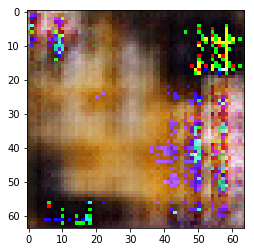

tensor(0.7144, device='cuda:0', grad_fn=<NegBackward>) tensor(2.4634, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


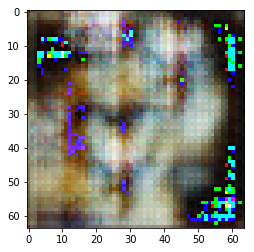

tensor(0.7251, device='cuda:0', grad_fn=<NegBackward>) tensor(1.8541, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


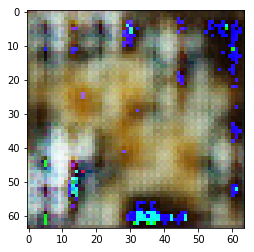

tensor(0.9731, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0889, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


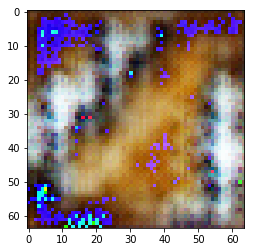

tensor(-0.0923, device='cuda:0', grad_fn=<NegBackward>) tensor(1.9681, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


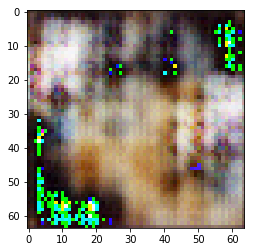

tensor(0.6414, device='cuda:0', grad_fn=<NegBackward>) tensor(1.6176, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


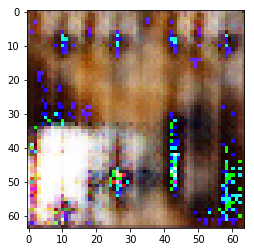

tensor(-0.2486, device='cuda:0', grad_fn=<NegBackward>) tensor(2.2065, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


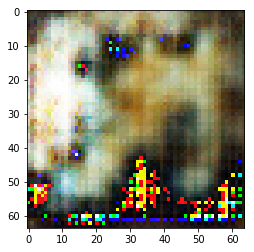

tensor(0.6251, device='cuda:0', grad_fn=<NegBackward>) tensor(1.7175, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


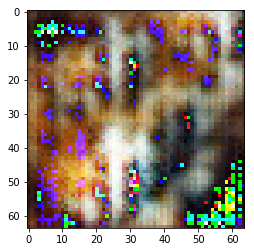

tensor(0.9863, device='cuda:0', grad_fn=<NegBackward>) tensor(2.2020, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


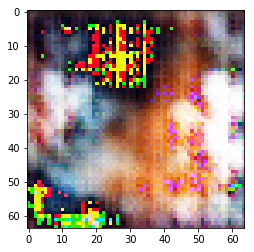

tensor(0.6360, device='cuda:0', grad_fn=<NegBackward>) tensor(2.0186, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


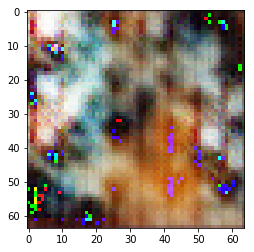

tensor(0.3137, device='cuda:0', grad_fn=<NegBackward>) tensor(1.8269, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


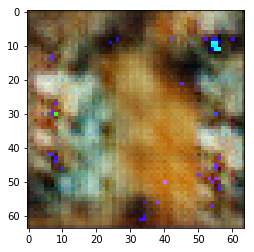

tensor(0.4615, device='cuda:0', grad_fn=<NegBackward>) tensor(1.6087, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


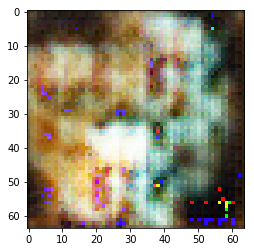

tensor(0.4552, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5779, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


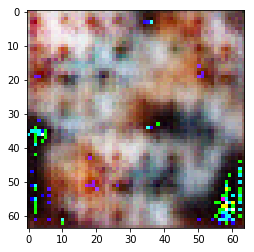

tensor(0.8401, device='cuda:0', grad_fn=<NegBackward>) tensor(2.1453, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


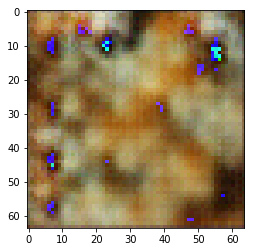

tensor(0.7957, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3804, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


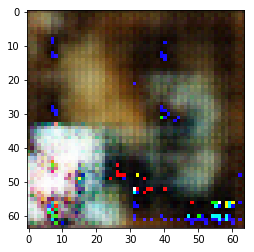

tensor(0.0584, device='cuda:0', grad_fn=<NegBackward>) tensor(1.7149, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


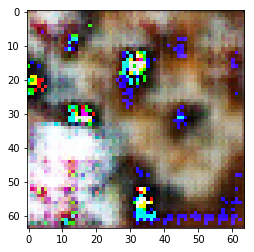

tensor(-0.6971, device='cuda:0', grad_fn=<NegBackward>) tensor(1.8605, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


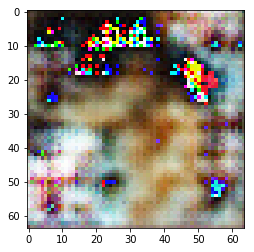

tensor(0.1114, device='cuda:0', grad_fn=<NegBackward>) tensor(2.1442, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


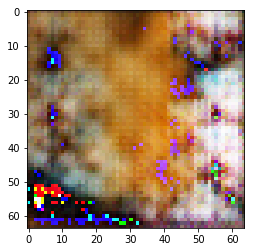

tensor(0.8102, device='cuda:0', grad_fn=<NegBackward>) tensor(1.8444, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


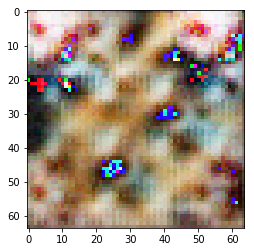

tensor(0.8502, device='cuda:0', grad_fn=<NegBackward>) tensor(1.7550, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


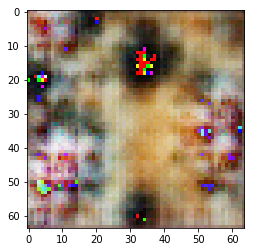

tensor(0.1987, device='cuda:0', grad_fn=<NegBackward>) tensor(0.8757, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


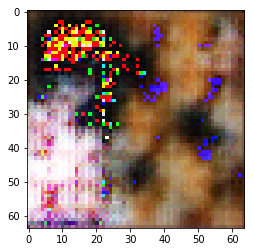

tensor(0.1778, device='cuda:0', grad_fn=<NegBackward>) tensor(2.1475, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


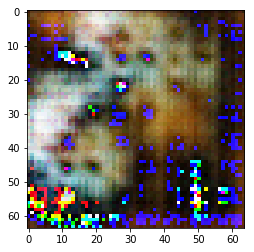

tensor(0.3545, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5779, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


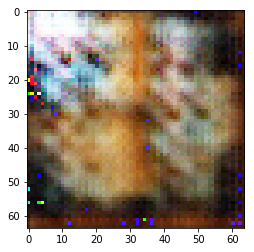

tensor(0.5651, device='cuda:0', grad_fn=<NegBackward>) tensor(1.6425, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


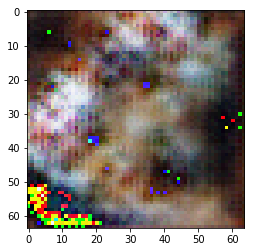

tensor(0.6748, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2931, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


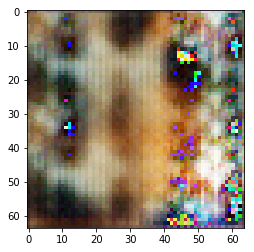

tensor(0.8376, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3438, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


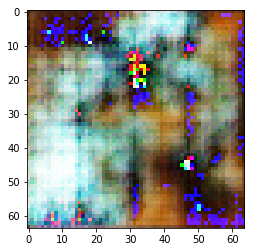

tensor(0.5666, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4913, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


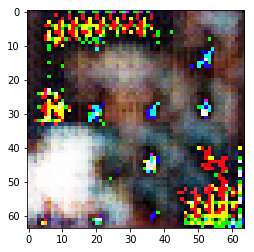

tensor(0.7840, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5731, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


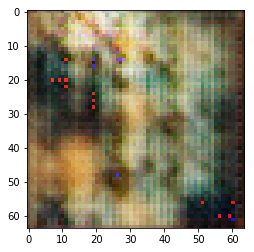

tensor(0.7563, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2228, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


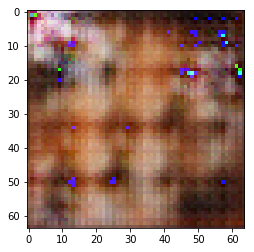

tensor(0.7409, device='cuda:0', grad_fn=<NegBackward>) tensor(1.6787, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


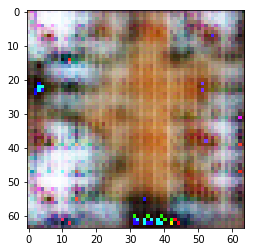

tensor(1.1671, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1781, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


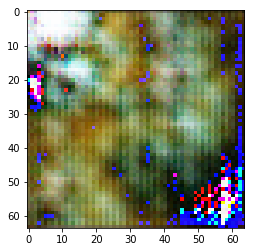

tensor(0.6482, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1983, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


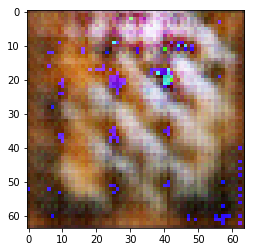

tensor(0.4874, device='cuda:0', grad_fn=<NegBackward>) tensor(1.7774, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


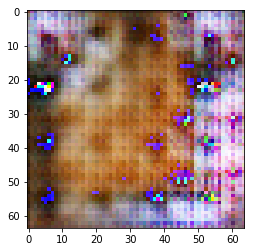

tensor(0.4676, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2636, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


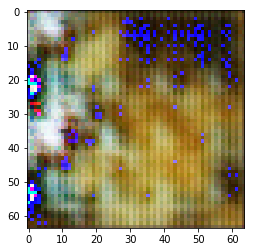

tensor(0.6497, device='cuda:0', grad_fn=<NegBackward>) tensor(1.6375, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


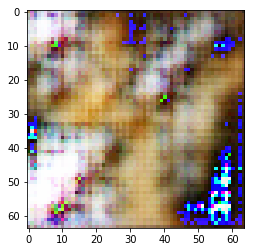

tensor(0.4409, device='cuda:0', grad_fn=<NegBackward>) tensor(2.0988, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


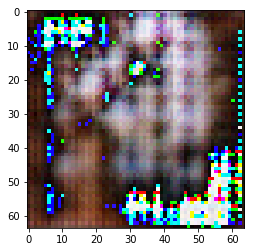

tensor(0.4621, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0509, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


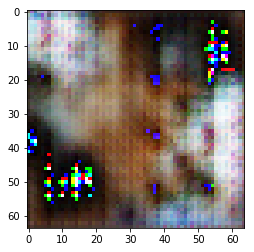

tensor(0.0880, device='cuda:0', grad_fn=<NegBackward>) tensor(1.6425, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


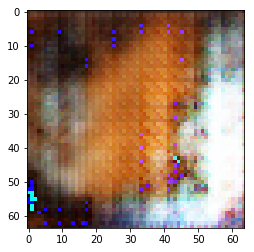

tensor(-0.3919, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5652, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


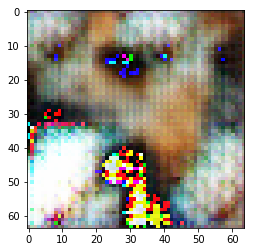

tensor(-0.0879, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3232, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


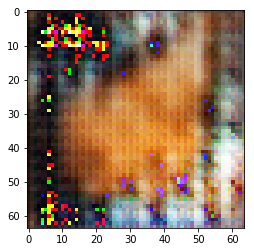

tensor(0.5888, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3128, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


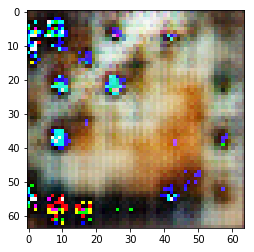

tensor(0.0822, device='cuda:0', grad_fn=<NegBackward>) tensor(1.7376, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


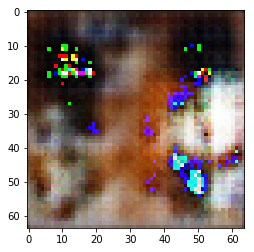

tensor(0.7186, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0610, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


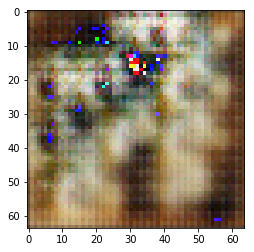

tensor(0.3851, device='cuda:0', grad_fn=<NegBackward>) tensor(1.7959, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


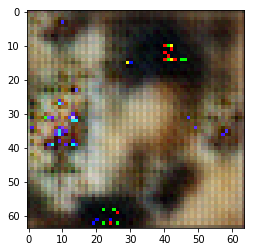

tensor(0.3569, device='cuda:0', grad_fn=<NegBackward>) tensor(1.7213, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


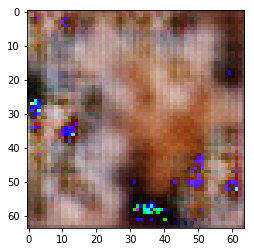

tensor(0.5735, device='cuda:0', grad_fn=<NegBackward>) tensor(0.8187, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


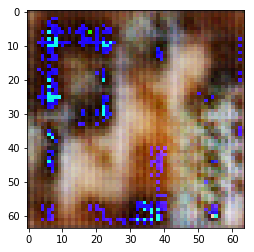

tensor(0.0643, device='cuda:0', grad_fn=<NegBackward>) tensor(2.0593, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


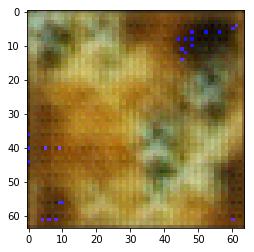

tensor(0.8340, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9965, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


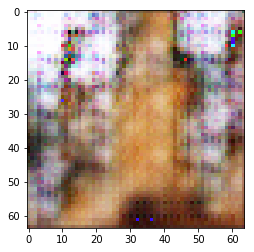

tensor(-0.3093, device='cuda:0', grad_fn=<NegBackward>) tensor(1.6951, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


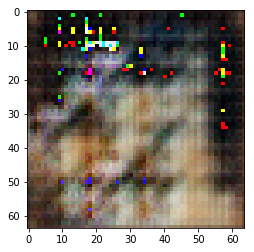

tensor(0.2658, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2271, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


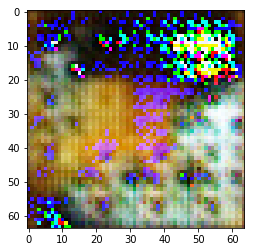

tensor(-0.0113, device='cuda:0', grad_fn=<NegBackward>) tensor(2.0854, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


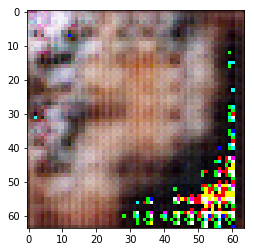

tensor(0.8634, device='cuda:0', grad_fn=<NegBackward>) tensor(0.8854, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


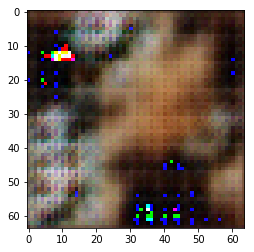

tensor(0.3885, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0424, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


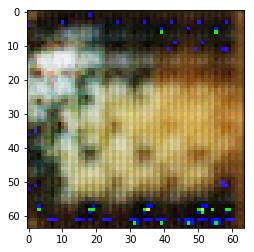

tensor(0.3613, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5161, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


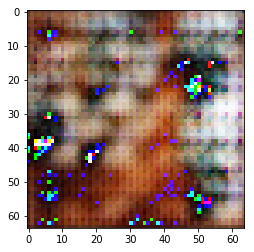

tensor(1.1667, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3047, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


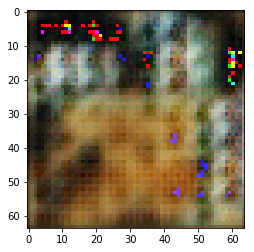

tensor(0.3213, device='cuda:0', grad_fn=<NegBackward>) tensor(1.9461, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


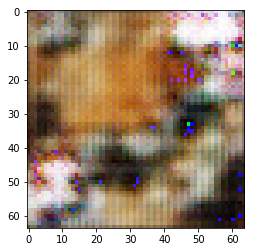

tensor(1.4349, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1042, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


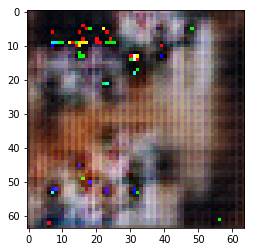

tensor(0.0839, device='cuda:0', grad_fn=<NegBackward>) tensor(2.0809, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


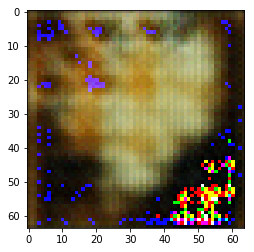

tensor(0.2263, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2351, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


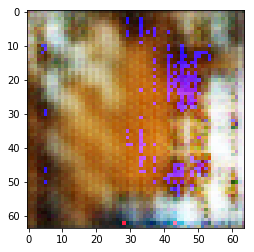

tensor(-0.2734, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4666, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


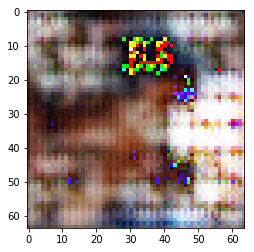

tensor(0.8182, device='cuda:0', grad_fn=<NegBackward>) tensor(1.9960, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


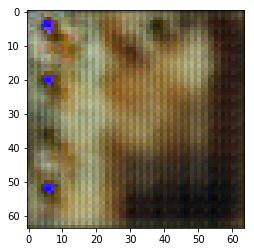

tensor(0.1890, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0411, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


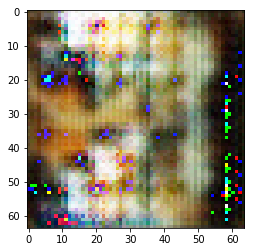

tensor(0.1032, device='cuda:0', grad_fn=<NegBackward>) tensor(2.5361, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


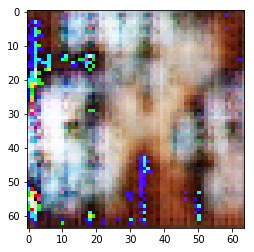

tensor(0.6029, device='cuda:0', grad_fn=<NegBackward>) tensor(0.7501, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


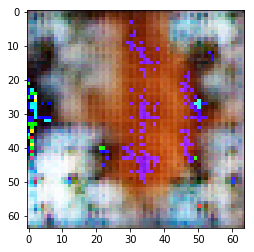

tensor(0.1888, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5832, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


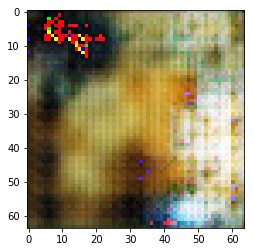

tensor(0.3127, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3807, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


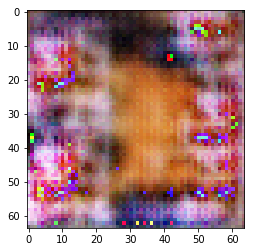

tensor(0.4823, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5137, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


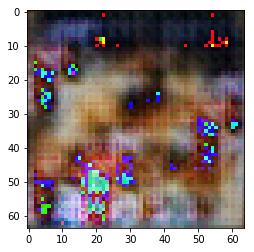

tensor(0.6675, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1507, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


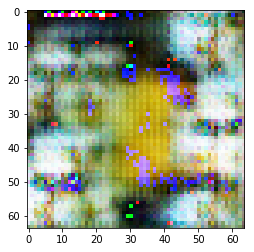

tensor(0.0282, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2528, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


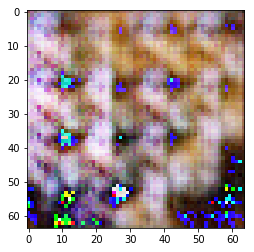

tensor(0.5969, device='cuda:0', grad_fn=<NegBackward>) tensor(1.7334, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


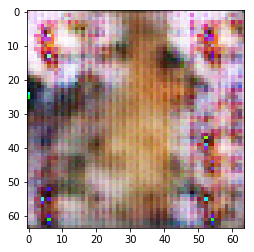

tensor(0.1870, device='cuda:0', grad_fn=<NegBackward>) tensor(2.0100, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


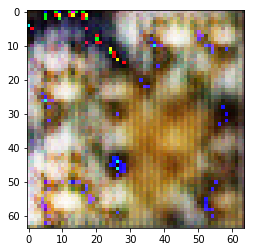

tensor(0.5878, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3824, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


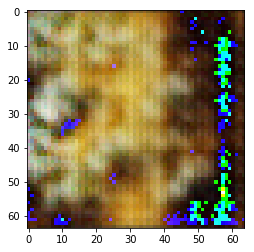

tensor(0.4974, device='cuda:0', grad_fn=<NegBackward>) tensor(1.6508, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


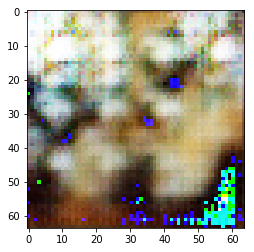

tensor(1.0320, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0178, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


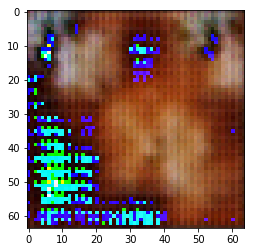

tensor(0.5290, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5549, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


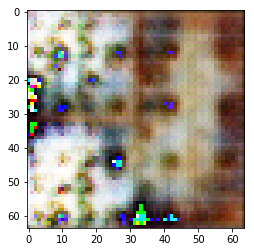

tensor(0.1254, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4296, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


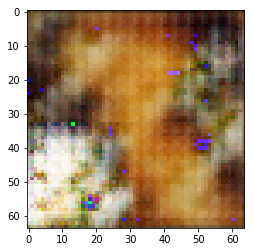

tensor(0.3611, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0882, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


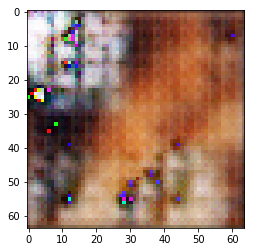

tensor(0.3274, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5641, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


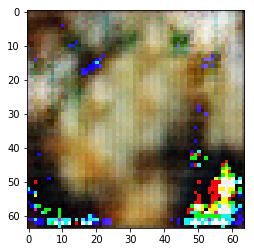

tensor(0.4623, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2378, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


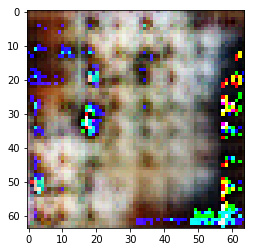

tensor(0.2144, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2253, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


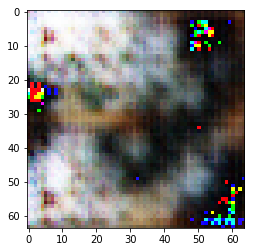

tensor(0.6092, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4964, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


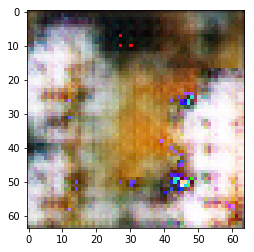

tensor(0.4782, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3297, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


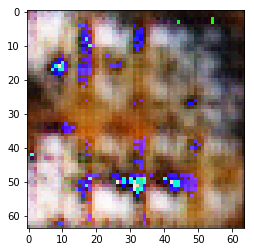

tensor(0.9372, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4586, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


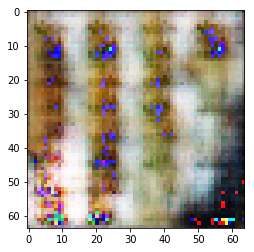

tensor(0.5713, device='cuda:0', grad_fn=<NegBackward>) tensor(1.8972, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


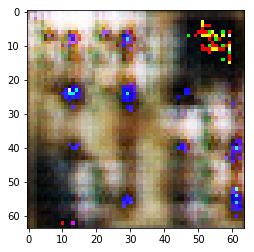

tensor(0.9099, device='cuda:0', grad_fn=<NegBackward>) tensor(1.6498, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


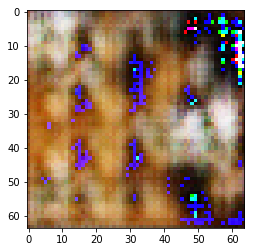

tensor(0.4194, device='cuda:0', grad_fn=<NegBackward>) tensor(0.7435, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


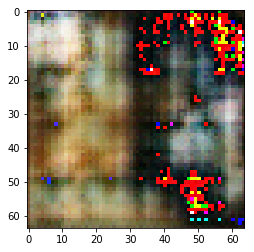

tensor(-0.1349, device='cuda:0', grad_fn=<NegBackward>) tensor(2.0030, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


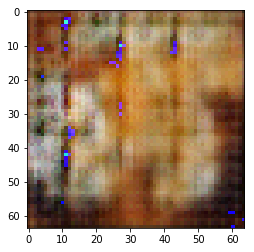

tensor(0.6550, device='cuda:0', grad_fn=<NegBackward>) tensor(1.8033, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


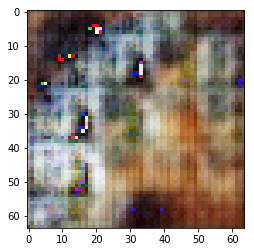

tensor(1.2452, device='cuda:0', grad_fn=<NegBackward>) tensor(0.6555, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


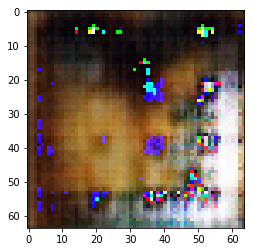

tensor(0.4896, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3218, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


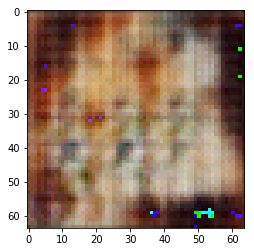

tensor(-0.1005, device='cuda:0', grad_fn=<NegBackward>) tensor(2.4451, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


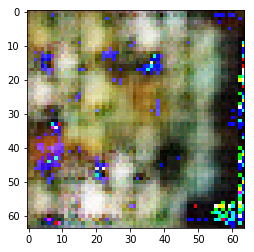

tensor(1.7645, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1950, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


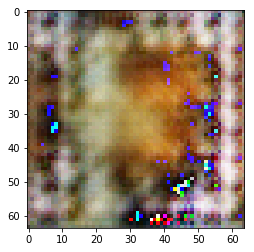

tensor(-0.2400, device='cuda:0', grad_fn=<NegBackward>) tensor(1.6050, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


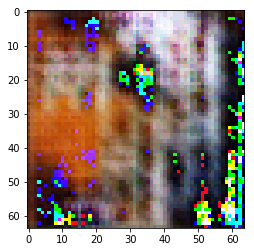

tensor(0.3586, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4802, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


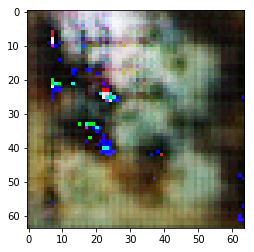

tensor(0.2191, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9828, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


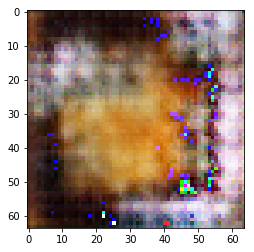

tensor(0.5645, device='cuda:0', grad_fn=<NegBackward>) tensor(1.6552, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


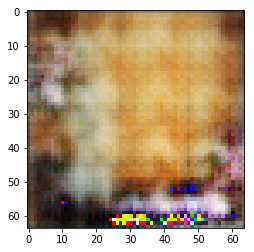

tensor(0.6894, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0516, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


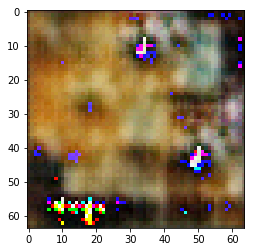

tensor(0.8032, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4908, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


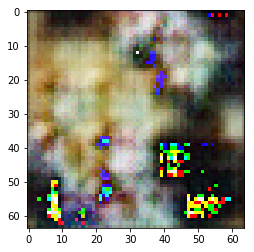

tensor(0.6705, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5274, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


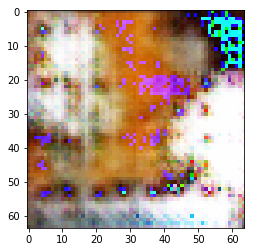

tensor(0.2778, device='cuda:0', grad_fn=<NegBackward>) tensor(1.6503, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


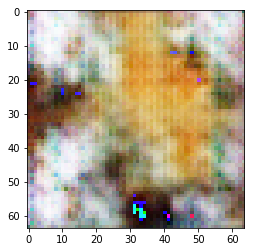

tensor(0.4979, device='cuda:0', grad_fn=<NegBackward>) tensor(2.1858, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


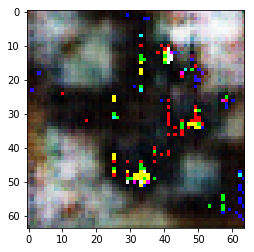

tensor(0.1099, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1662, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


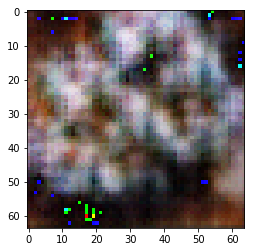

tensor(0.6159, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1261, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


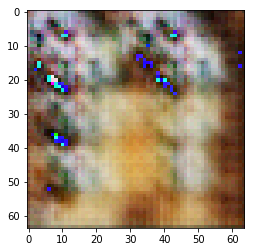

tensor(-0.1744, device='cuda:0', grad_fn=<NegBackward>) tensor(1.9040, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


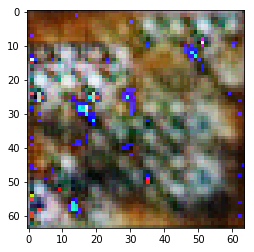

tensor(1.1454, device='cuda:0', grad_fn=<NegBackward>) tensor(0.5460, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


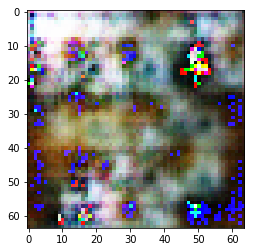

tensor(0.2195, device='cuda:0', grad_fn=<NegBackward>) tensor(1.6297, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


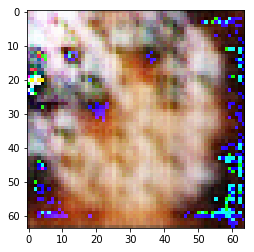

tensor(0.6785, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3481, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


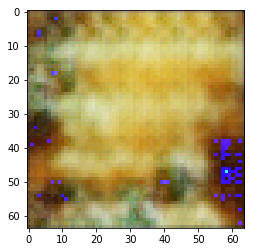

tensor(0.4343, device='cuda:0', grad_fn=<NegBackward>) tensor(1.6075, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


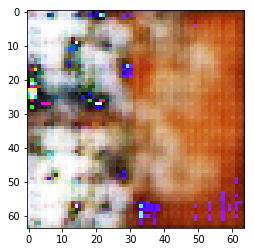

tensor(0.5629, device='cuda:0', grad_fn=<NegBackward>) tensor(1.6199, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


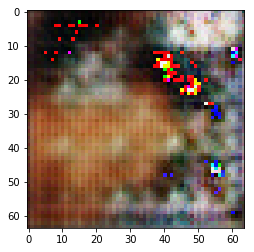

tensor(0.8490, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9558, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


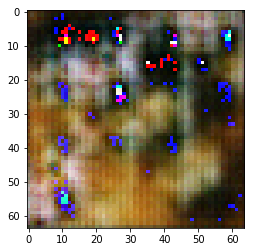

tensor(0.2996, device='cuda:0', grad_fn=<NegBackward>) tensor(1.8019, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


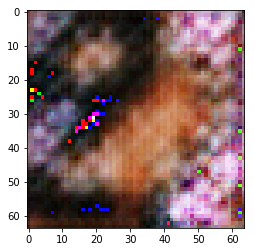

tensor(0.2420, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2915, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


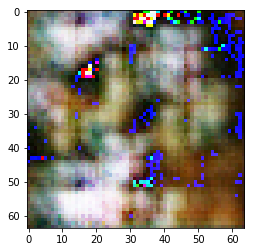

tensor(0.1467, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5459, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


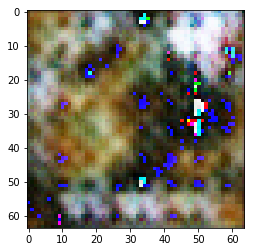

tensor(-0.1021, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2423, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


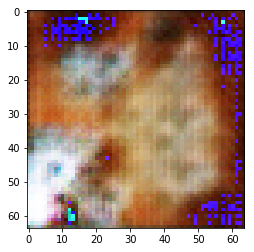

tensor(0.7713, device='cuda:0', grad_fn=<NegBackward>) tensor(1.7832, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


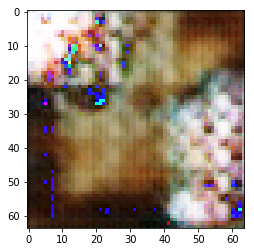

tensor(1.0156, device='cuda:0', grad_fn=<NegBackward>) tensor(0.7226, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


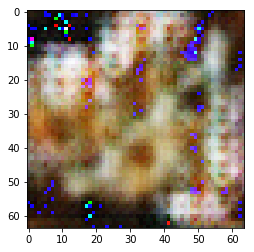

tensor(-0.1209, device='cuda:0', grad_fn=<NegBackward>) tensor(1.8647, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


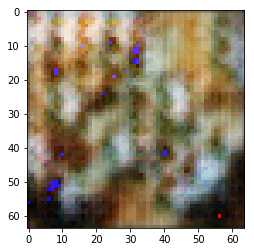

tensor(0.6594, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0399, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


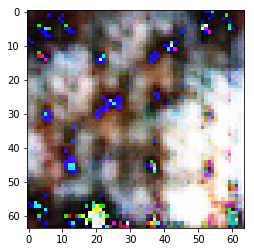

tensor(-0.1961, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4353, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


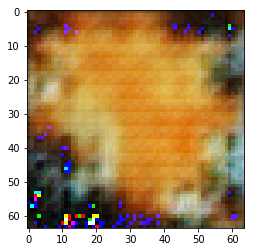

tensor(0.8981, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9604, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


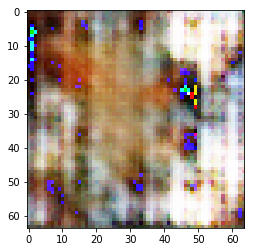

tensor(0.4817, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3684, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


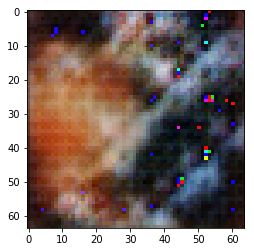

tensor(0.4167, device='cuda:0', grad_fn=<NegBackward>) tensor(1.6805, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


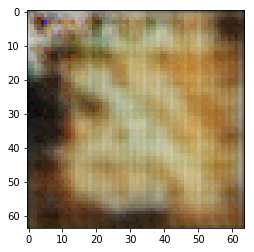

tensor(0.4423, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0740, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


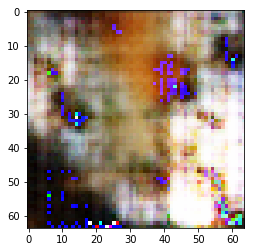

tensor(0.7321, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3756, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


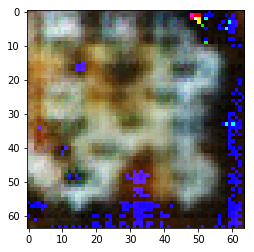

tensor(0.4171, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0145, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


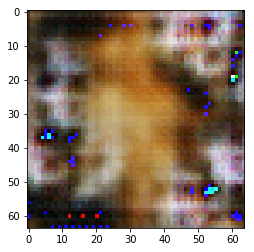

tensor(0.9845, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4523, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


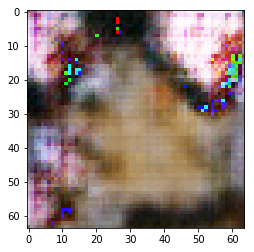

tensor(0.8711, device='cuda:0', grad_fn=<NegBackward>) tensor(0.6863, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


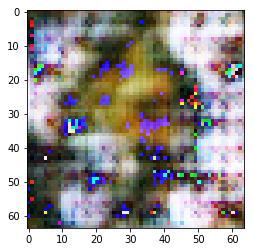

tensor(0.2931, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9988, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


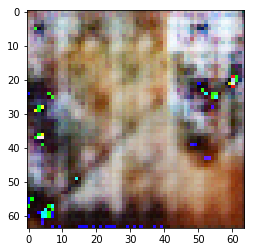

tensor(0.7948, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0484, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


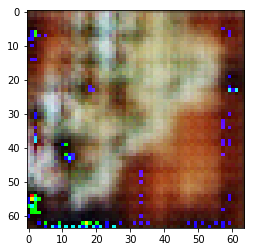

tensor(0.3197, device='cuda:0', grad_fn=<NegBackward>) tensor(2.1217, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


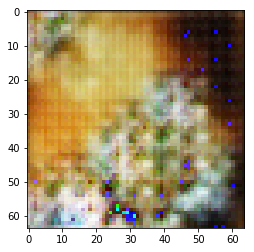

tensor(1.5009, device='cuda:0', grad_fn=<NegBackward>) tensor(0.5819, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


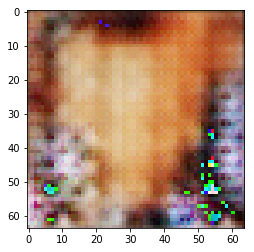

tensor(0.2378, device='cuda:0', grad_fn=<NegBackward>) tensor(1.8687, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


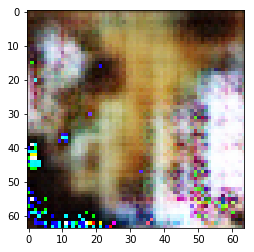

tensor(0.0754, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0208, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


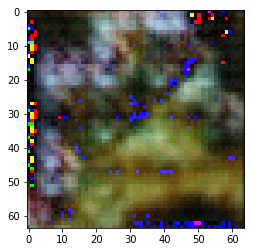

tensor(0.4381, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1654, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


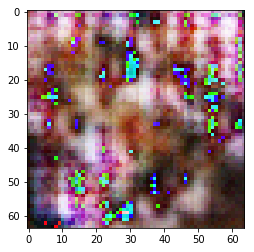

tensor(0.0302, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4276, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


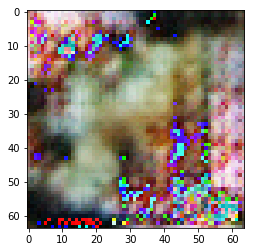

tensor(-0.1912, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4251, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


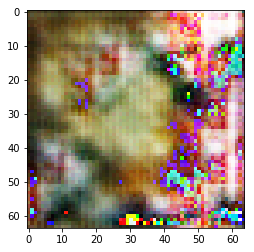

tensor(0.4054, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3854, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


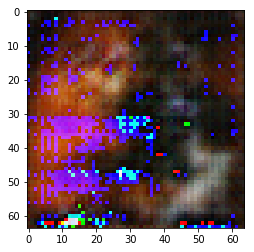

tensor(0.1879, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3302, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


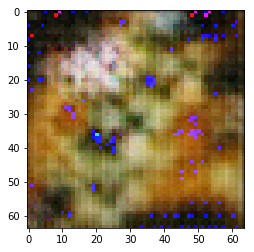

tensor(0.0969, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4278, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


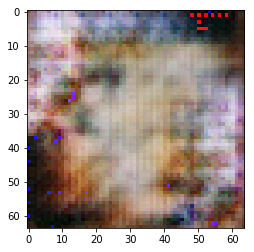

tensor(1.1777, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1953, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


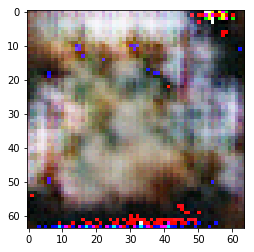

tensor(0.2796, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1593, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


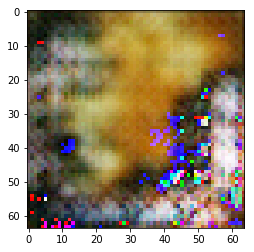

tensor(0.8528, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3298, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


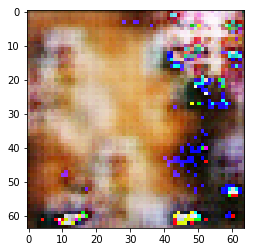

tensor(0.2357, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1483, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


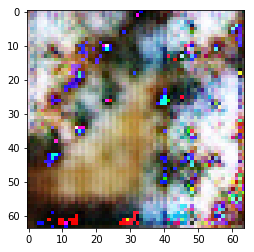

tensor(-0.1351, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4516, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


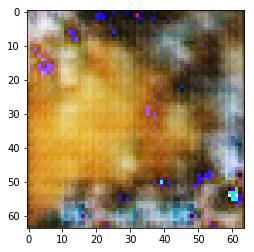

tensor(0.3699, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2297, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


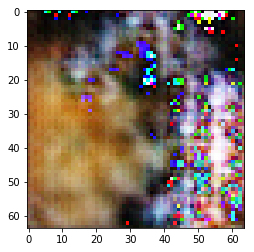

tensor(0.4636, device='cuda:0', grad_fn=<NegBackward>) tensor(2.1516, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


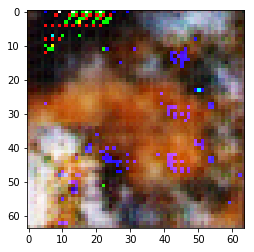

tensor(1.0113, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9848, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


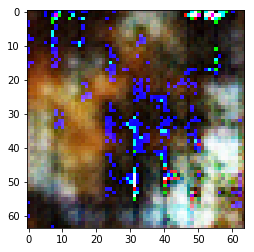

tensor(0.5945, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3440, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


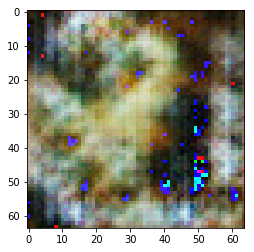

tensor(1.0720, device='cuda:0', grad_fn=<NegBackward>) tensor(0.6324, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


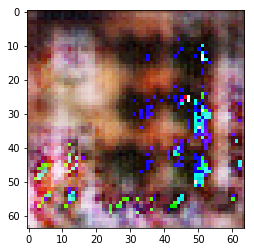

tensor(0.3089, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4763, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


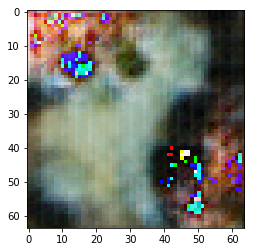

tensor(0.3396, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1847, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


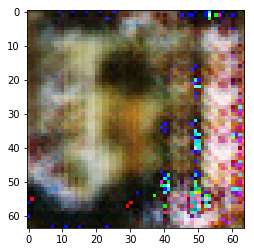

tensor(0.4695, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2670, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


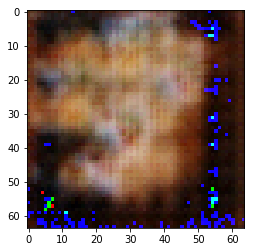

tensor(0.9294, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9901, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


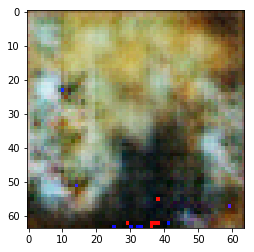

tensor(0.5931, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5100, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


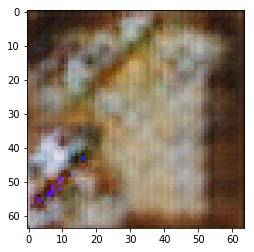

tensor(0.1540, device='cuda:0', grad_fn=<NegBackward>) tensor(0.8927, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


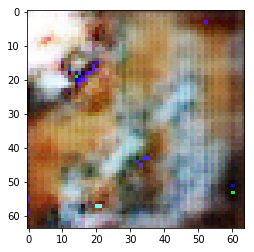

tensor(0.5510, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3761, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


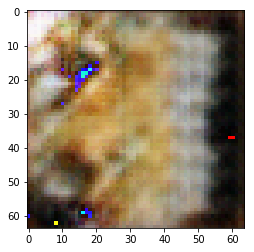

tensor(0.9129, device='cuda:0', grad_fn=<NegBackward>) tensor(0.6095, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


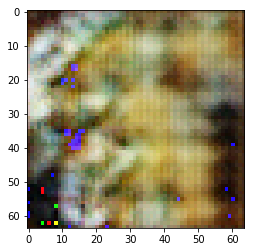

tensor(-0.2164, device='cuda:0', grad_fn=<NegBackward>) tensor(1.8394, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


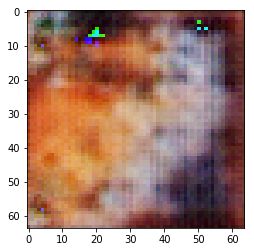

tensor(0.8645, device='cuda:0', grad_fn=<NegBackward>) tensor(0.7386, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


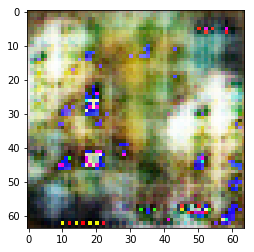

tensor(0.4229, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2309, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


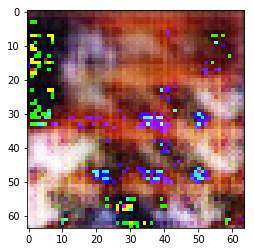

tensor(1.0117, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1908, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


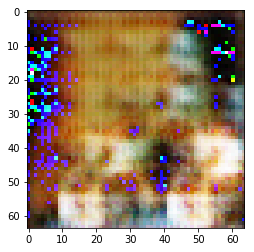

tensor(0.0293, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1614, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


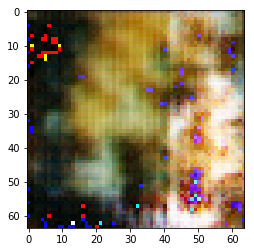

tensor(0.5700, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0305, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


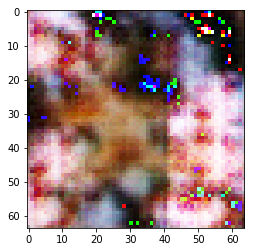

tensor(0.8782, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4860, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


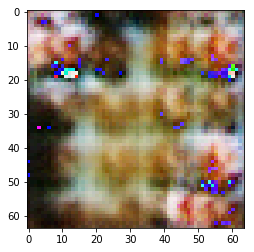

tensor(0.1544, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0513, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


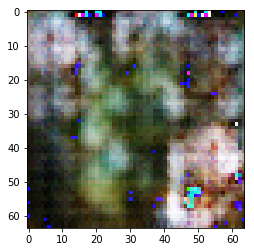

tensor(0.8760, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5555, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


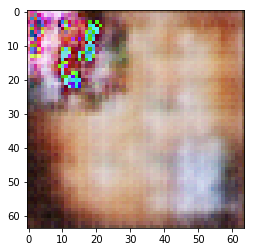

tensor(0.2526, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0062, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


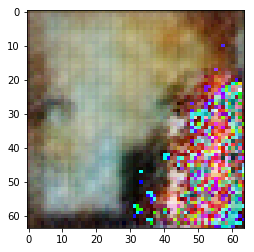

tensor(0.5246, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3039, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


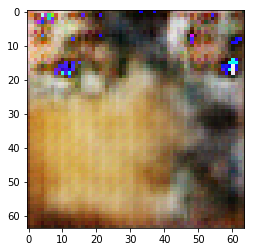

tensor(0.1947, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5755, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


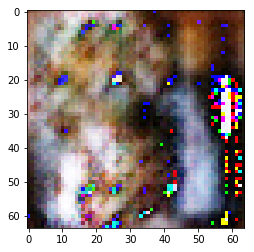

tensor(0.5386, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0406, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


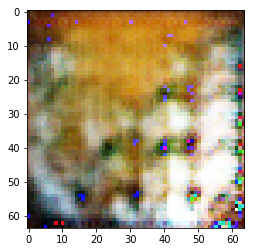

tensor(0.3365, device='cuda:0', grad_fn=<NegBackward>) tensor(1.6156, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


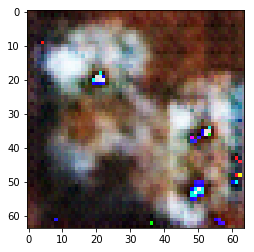

tensor(0.6534, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0225, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


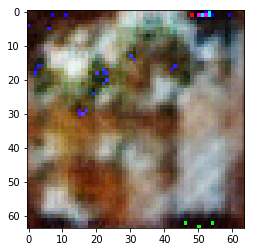

tensor(0.1544, device='cuda:0', grad_fn=<NegBackward>) tensor(2.0432, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


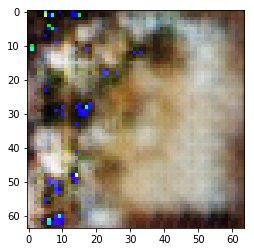

tensor(0.4509, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9430, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


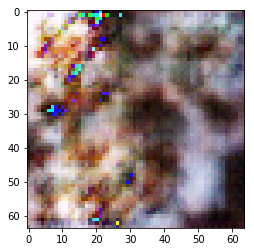

tensor(0.0728, device='cuda:0', grad_fn=<NegBackward>) tensor(1.7781, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


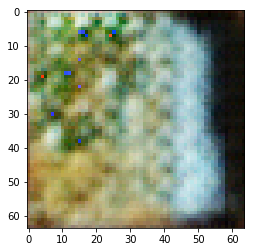

tensor(0.4229, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2760, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


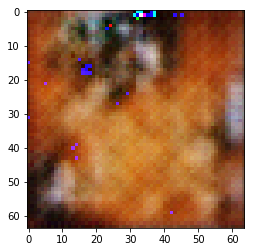

tensor(0.5393, device='cuda:0', grad_fn=<NegBackward>) tensor(1.8494, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


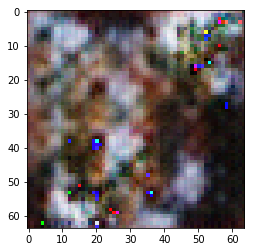

tensor(-0.1245, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4058, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


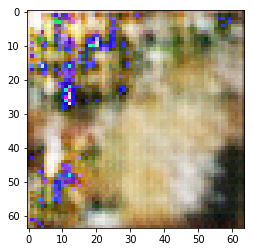

tensor(0.2934, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1412, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


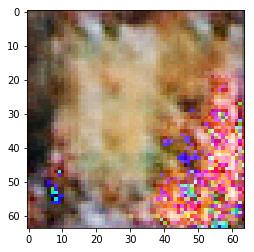

tensor(1.1370, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1472, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


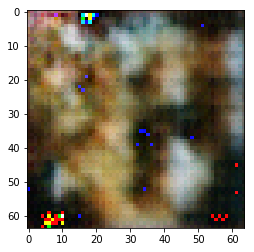

tensor(0.4345, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4099, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


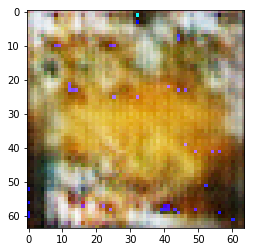

tensor(0.8166, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9215, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


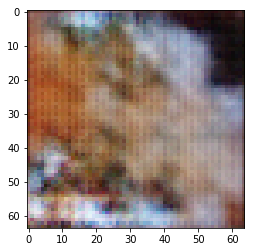

tensor(0.4837, device='cuda:0', grad_fn=<NegBackward>) tensor(1.7463, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


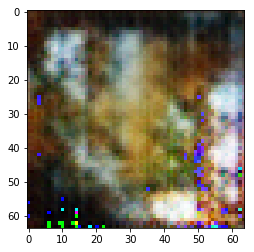

tensor(0.6144, device='cuda:0', grad_fn=<NegBackward>) tensor(0.6079, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


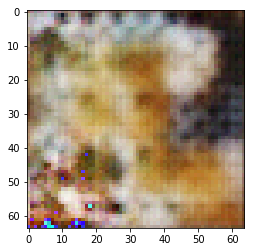

tensor(0.2880, device='cuda:0', grad_fn=<NegBackward>) tensor(1.6909, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


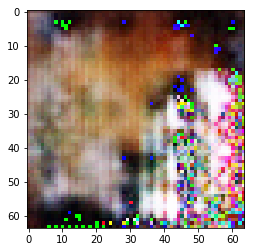

tensor(0.3969, device='cuda:0', grad_fn=<NegBackward>) tensor(1.7064, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


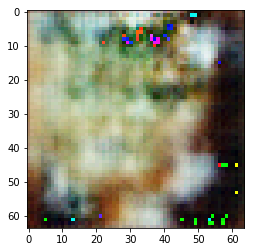

tensor(0.5012, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9841, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


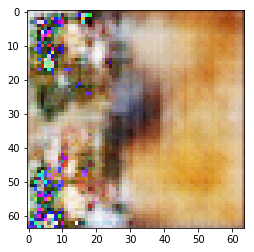

tensor(0.8797, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9913, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


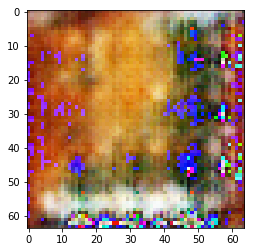

tensor(0.4075, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4643, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


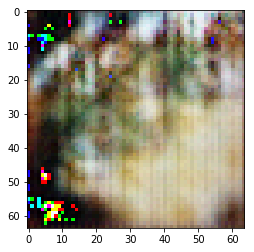

tensor(0.6805, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9868, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


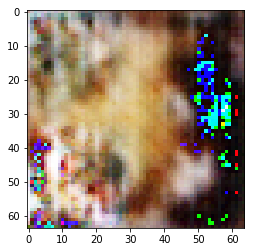

tensor(0.6581, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9541, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


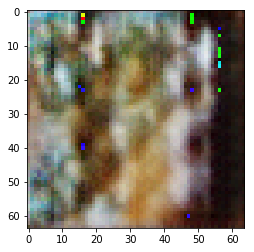

tensor(1.2367, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1301, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


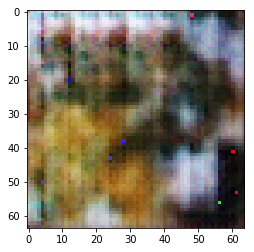

tensor(0.6754, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0083, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


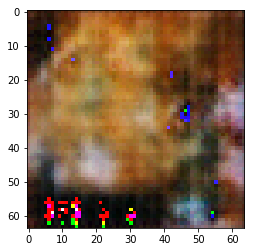

tensor(0.5294, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0742, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


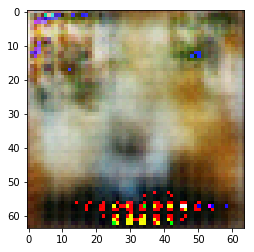

tensor(0.4410, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0544, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


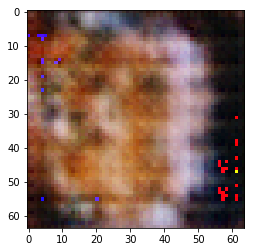

tensor(1.2186, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9095, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


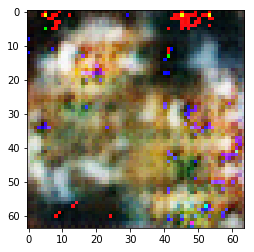

tensor(0.5367, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1961, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


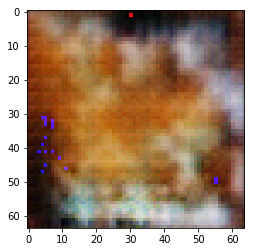

tensor(0.5160, device='cuda:0', grad_fn=<NegBackward>) tensor(0.8696, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


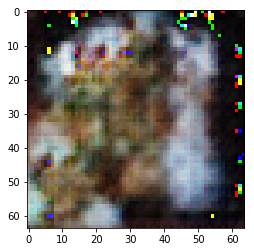

tensor(0.1797, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5237, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


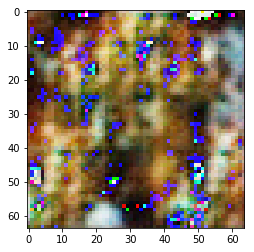

tensor(0.6101, device='cuda:0', grad_fn=<NegBackward>) tensor(0.7351, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


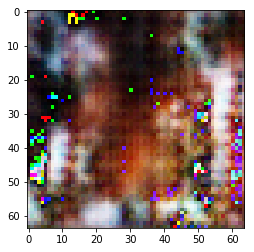

tensor(0.9458, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1080, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


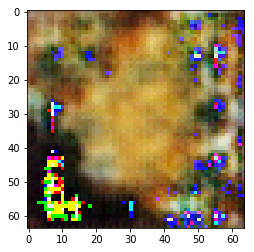

tensor(0.5566, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0528, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


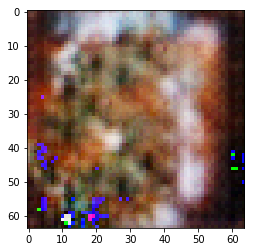

tensor(0.3496, device='cuda:0', grad_fn=<NegBackward>) tensor(2.0711, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


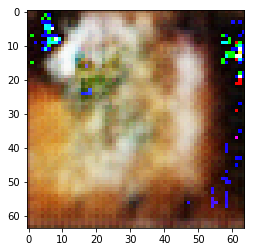

tensor(0.8984, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1476, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


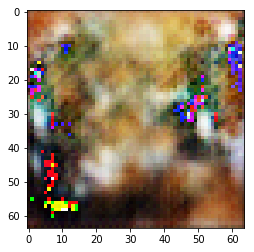

tensor(0.6001, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3027, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


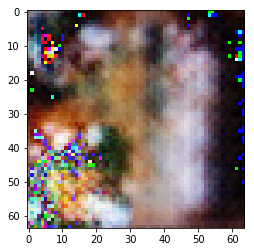

tensor(0.7579, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5650, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


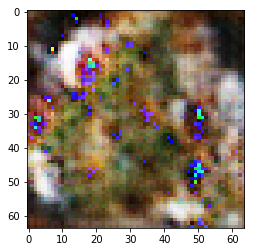

tensor(0.0174, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3909, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


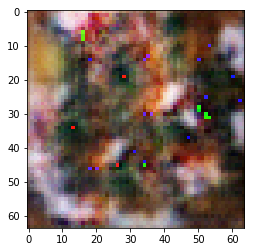

tensor(0.3165, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1942, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


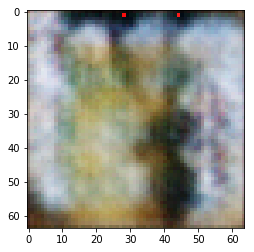

tensor(0.8524, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3755, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


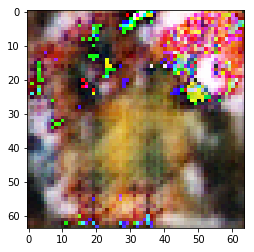

tensor(1.1355, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5093, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


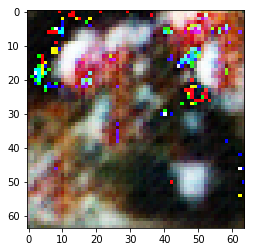

tensor(0.3657, device='cuda:0', grad_fn=<NegBackward>) tensor(1.7440, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


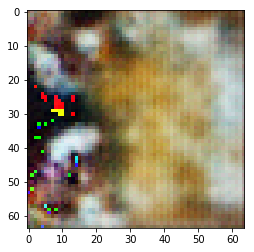

tensor(-0.0996, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4192, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


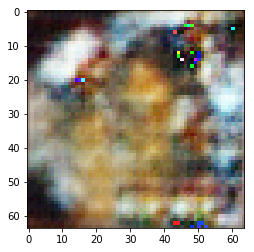

tensor(0.6255, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1090, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


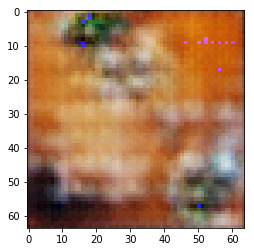

tensor(0.5281, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5835, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


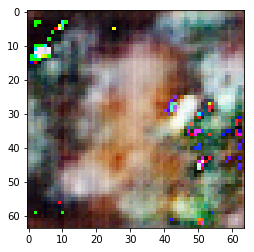

tensor(1.2653, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3774, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


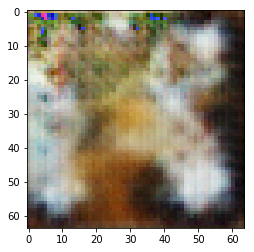

tensor(0.3875, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2874, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


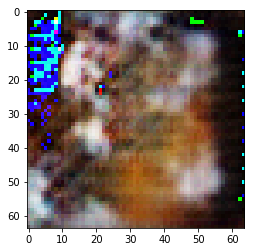

tensor(0.8234, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3848, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


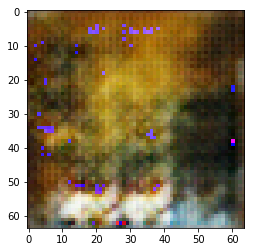

tensor(-0.1748, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2749, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


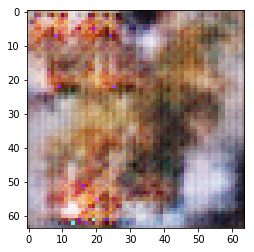

tensor(1.0437, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3283, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


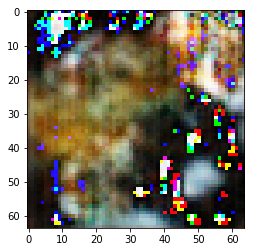

tensor(1.0475, device='cuda:0', grad_fn=<NegBackward>) tensor(0.7493, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


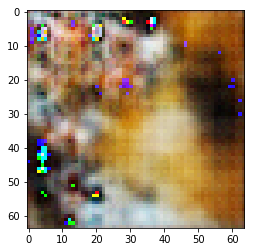

tensor(0.9540, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1887, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


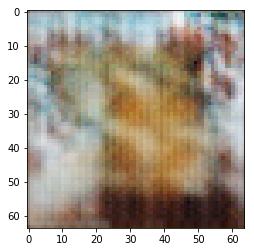

tensor(0.8747, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2420, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


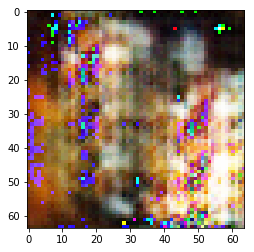

tensor(0.5254, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0939, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


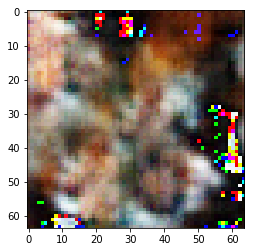

tensor(0.8159, device='cuda:0', grad_fn=<NegBackward>) tensor(0.7409, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


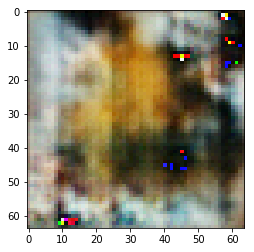

tensor(0.5574, device='cuda:0', grad_fn=<NegBackward>) tensor(1.7235, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


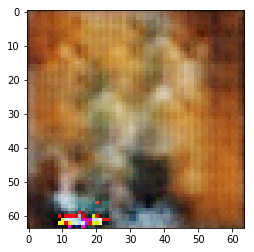

tensor(0.8368, device='cuda:0', grad_fn=<NegBackward>) tensor(0.8245, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


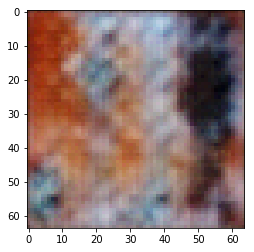

tensor(0.8633, device='cuda:0', grad_fn=<NegBackward>) tensor(0.8639, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


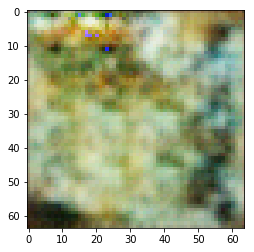

tensor(0.4173, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2792, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


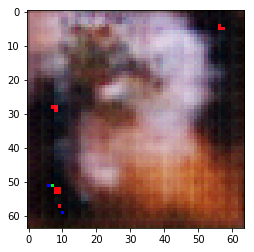

tensor(0.4297, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9255, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


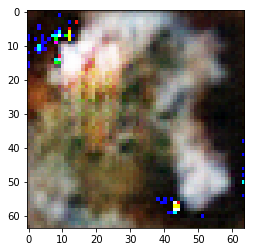

tensor(0.5657, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0577, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


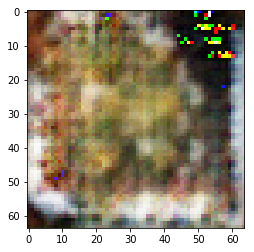

tensor(0.0007, device='cuda:0', grad_fn=<NegBackward>) tensor(1.6490, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


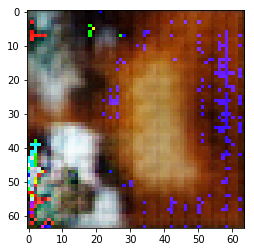

tensor(0.3859, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0701, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


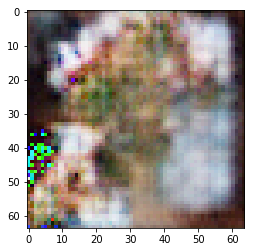

tensor(0.8620, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0844, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


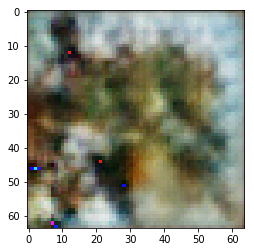

tensor(0.8973, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1365, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


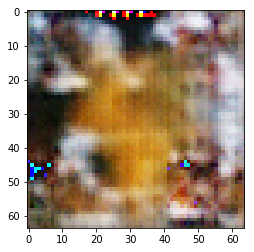

tensor(0.4459, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9584, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


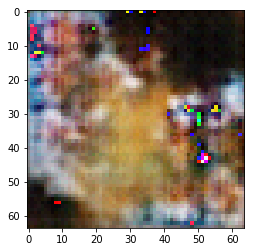

tensor(0.4581, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3181, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


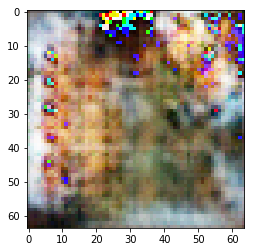

tensor(-0.0249, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2661, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


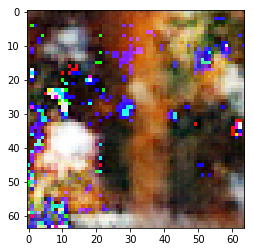

tensor(1.1526, device='cuda:0', grad_fn=<NegBackward>) tensor(0.8443, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


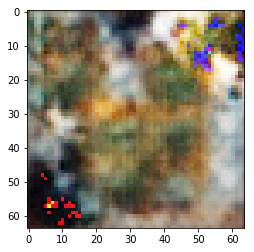

tensor(0.2041, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5076, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


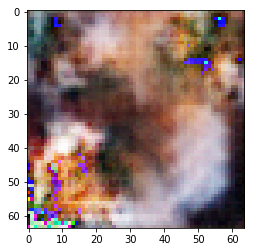

tensor(0.7648, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0955, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


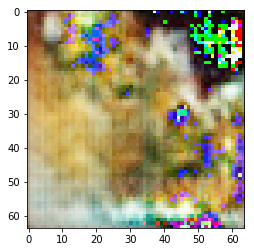

tensor(0.6766, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3737, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


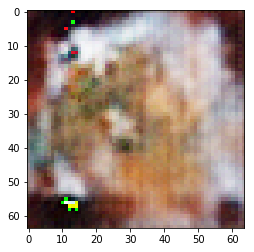

tensor(0.8576, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1622, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


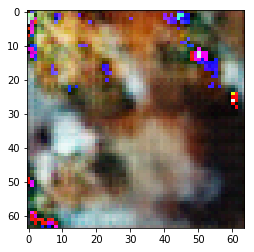

tensor(0.0074, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2710, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


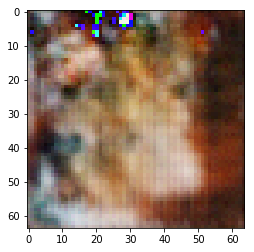

tensor(0.0157, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0229, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


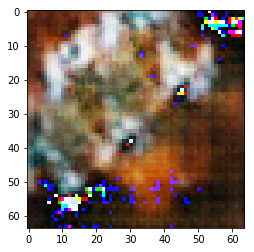

tensor(0.5982, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1077, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


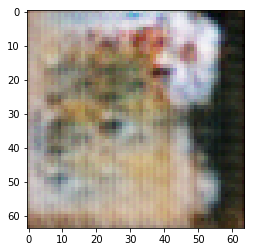

tensor(1.0124, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0947, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


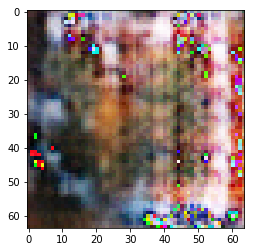

tensor(0.0658, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4532, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


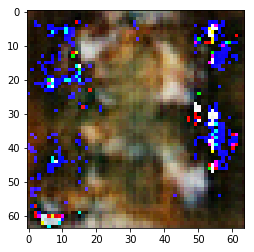

tensor(1.3417, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3051, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


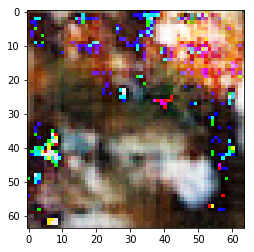

tensor(0.2194, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2462, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


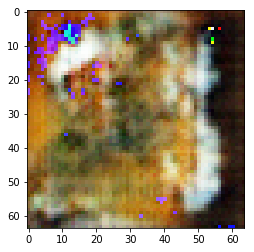

tensor(0.2776, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4622, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


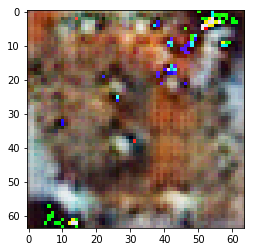

tensor(0.6868, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9047, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


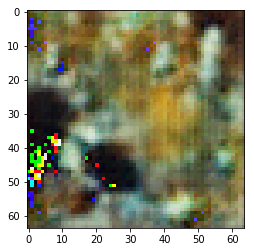

tensor(0.6455, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3785, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


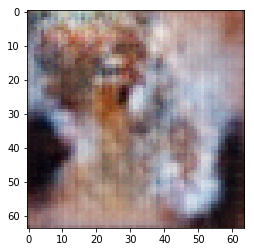

tensor(0.9846, device='cuda:0', grad_fn=<NegBackward>) tensor(0.7662, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


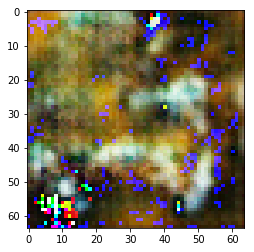

tensor(0.5996, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0120, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


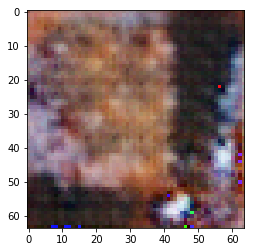

tensor(0.4227, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1104, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


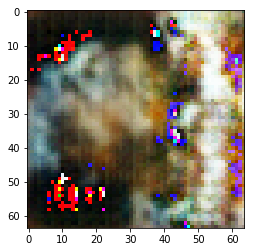

tensor(0.3464, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5098, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


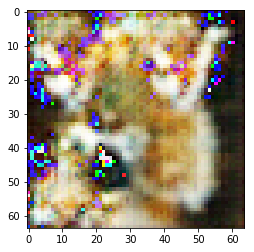

tensor(1.0042, device='cuda:0', grad_fn=<NegBackward>) tensor(0.6187, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


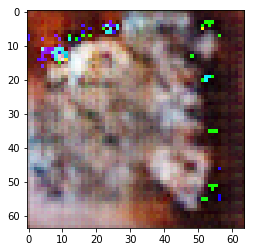

tensor(0.5677, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4346, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


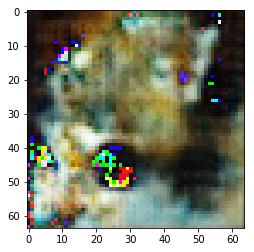

tensor(1.1530, device='cuda:0', grad_fn=<NegBackward>) tensor(0.6306, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


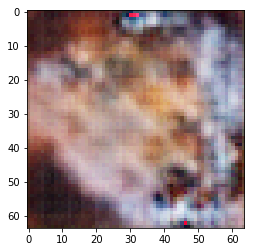

tensor(0.5415, device='cuda:0', grad_fn=<NegBackward>) tensor(0.7768, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


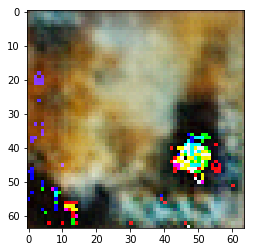

tensor(0.6714, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2293, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


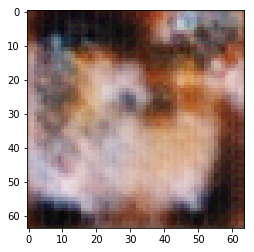

tensor(0.8516, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4029, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


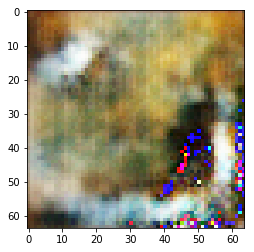

tensor(0.6553, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3737, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


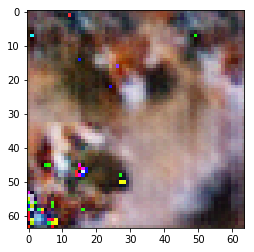

tensor(0.2533, device='cuda:0', grad_fn=<NegBackward>) tensor(1.6062, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


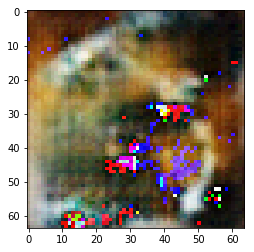

tensor(0.0647, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2512, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


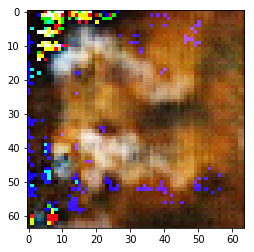

tensor(0.8009, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0433, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


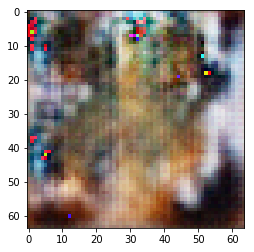

tensor(0.3505, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1984, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


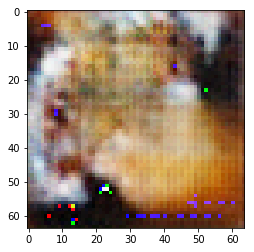

tensor(0.9029, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3293, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


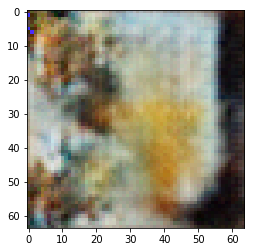

tensor(0.8678, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9087, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


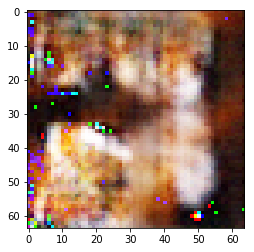

tensor(0.1874, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2992, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


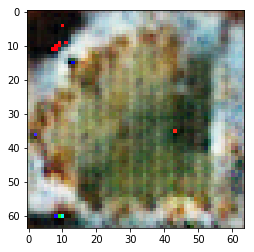

tensor(0.6185, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9926, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


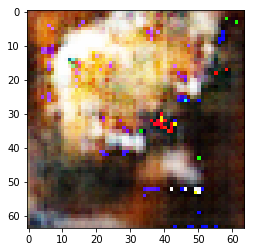

tensor(0.1921, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1021, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


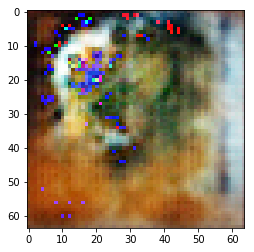

tensor(0.5372, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3782, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


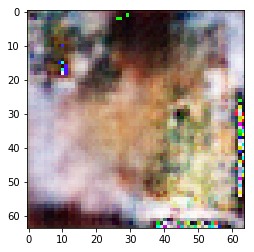

tensor(0.6959, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3245, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


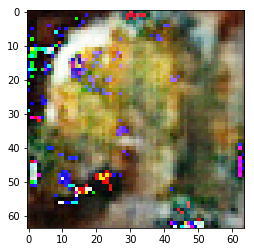

tensor(0.1337, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2121, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


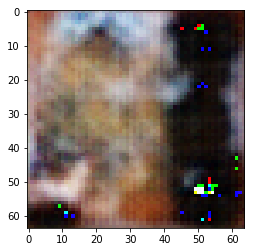

tensor(0.5901, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0847, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


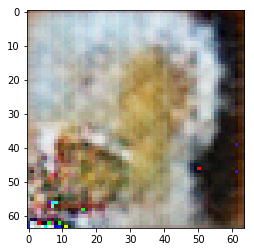

tensor(-0.2905, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3446, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


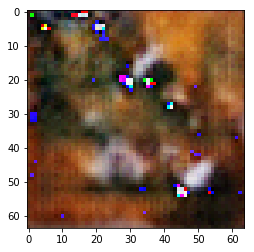

tensor(0.1564, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3778, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


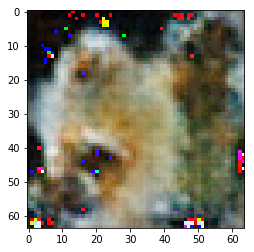

tensor(0.4322, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0786, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


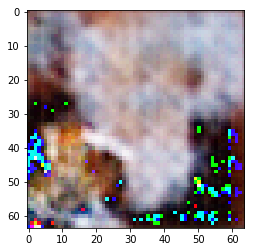

tensor(0.7645, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2669, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


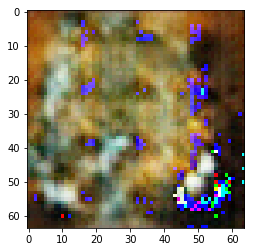

tensor(1.0916, device='cuda:0', grad_fn=<NegBackward>) tensor(1.7392, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


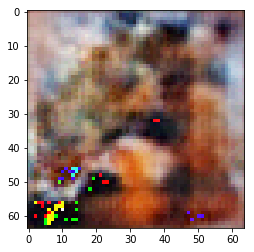

tensor(0.4317, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1206, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


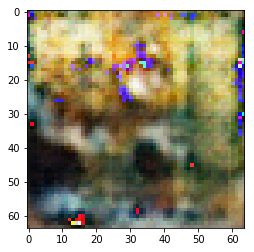

tensor(0.5597, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0612, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


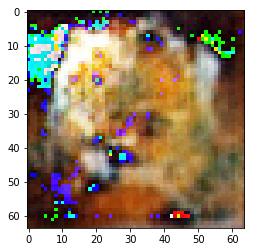

tensor(1.0248, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2648, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


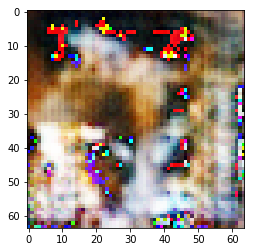

tensor(0.2520, device='cuda:0', grad_fn=<NegBackward>) tensor(1.6399, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


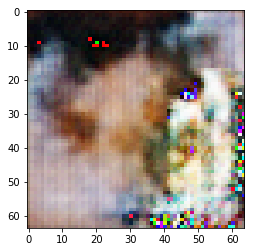

tensor(0.5237, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9677, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


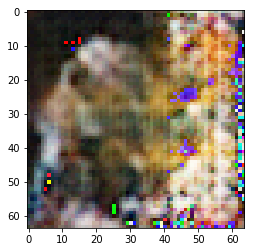

tensor(0.1952, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5732, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


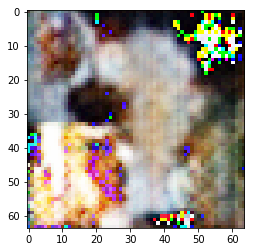

tensor(0.7768, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0471, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


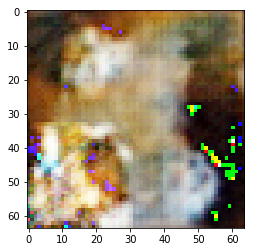

tensor(0.2516, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2022, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


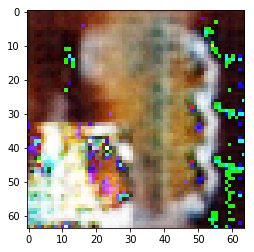

tensor(0.0919, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3125, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


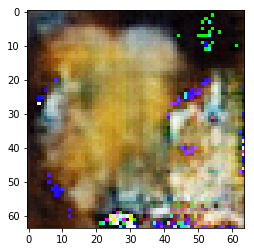

tensor(0.8219, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9191, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


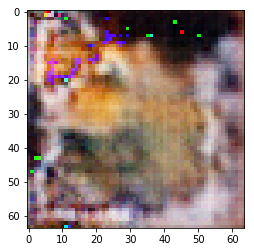

tensor(0.8028, device='cuda:0', grad_fn=<NegBackward>) tensor(0.7489, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


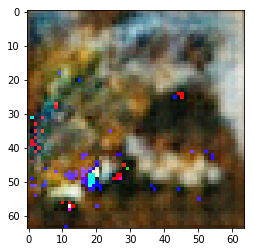

tensor(0.8762, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9960, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


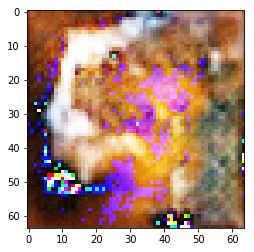

tensor(0.4996, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3261, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


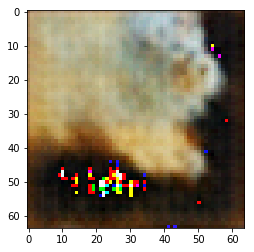

tensor(1.2435, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2636, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


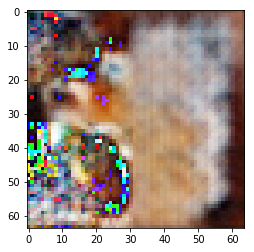

tensor(0.6753, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4804, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


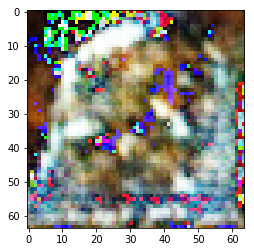

tensor(-0.0249, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3262, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


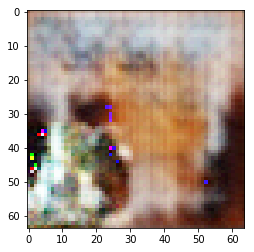

tensor(0.9124, device='cuda:0', grad_fn=<NegBackward>) tensor(0.7138, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


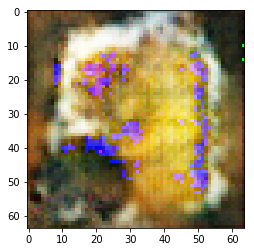

tensor(0.8846, device='cuda:0', grad_fn=<NegBackward>) tensor(0.5236, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


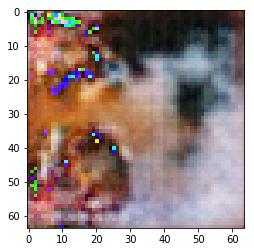

tensor(0.5666, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2013, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


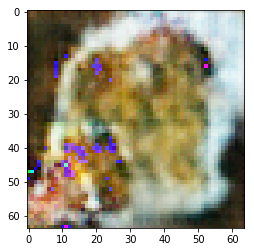

tensor(0.2351, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1624, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


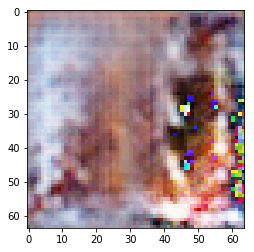

tensor(1.0477, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2255, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


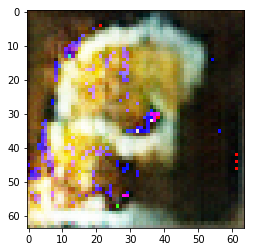

tensor(0.8813, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9900, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


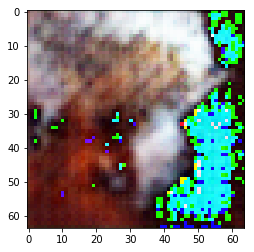

tensor(1.3692, device='cuda:0', grad_fn=<NegBackward>) tensor(0.5647, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


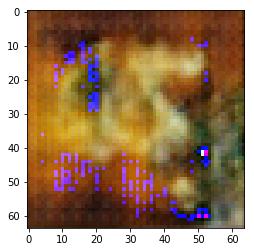

tensor(0.8312, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9998, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


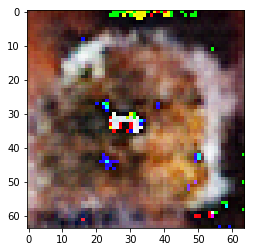

tensor(0.6662, device='cuda:0', grad_fn=<NegBackward>) tensor(0.8202, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


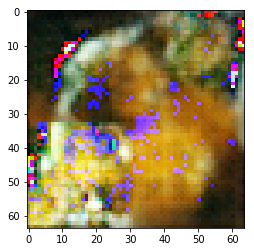

tensor(0.6777, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2392, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


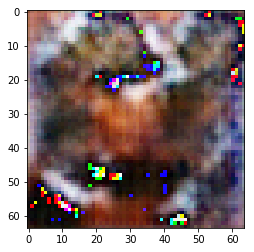

tensor(-0.4321, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4379, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


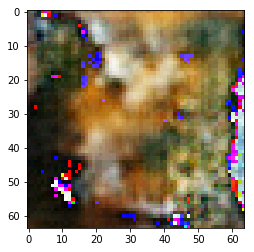

tensor(0.1584, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2263, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


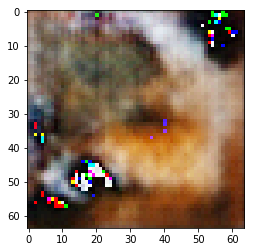

tensor(0.6731, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1946, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


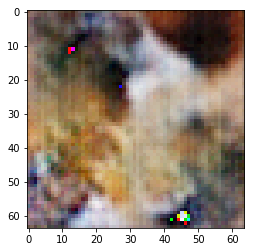

tensor(0.5958, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5487, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


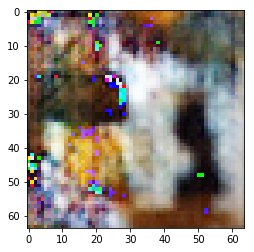

tensor(1.0463, device='cuda:0', grad_fn=<NegBackward>) tensor(0.8618, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


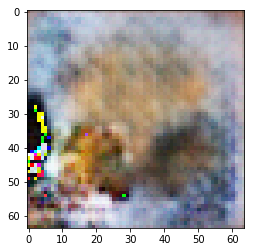

tensor(0.9694, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3614, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


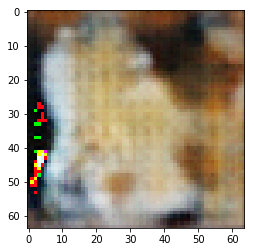

tensor(0.8243, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5961, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


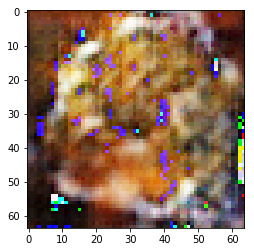

tensor(-0.1705, device='cuda:0', grad_fn=<NegBackward>) tensor(1.6912, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


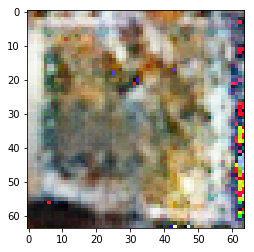

tensor(0.7617, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4132, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


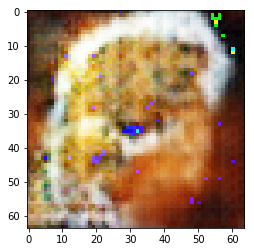

tensor(0.8804, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1629, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


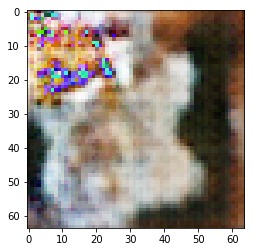

tensor(0.2424, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2871, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


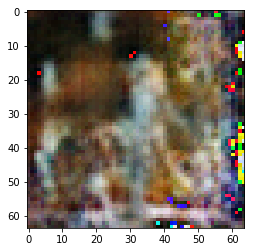

tensor(0.8896, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4950, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


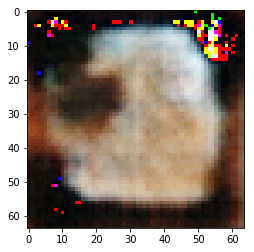

tensor(0.0801, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5385, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


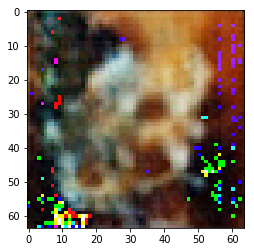

tensor(0.2289, device='cuda:0', grad_fn=<NegBackward>) tensor(1.6469, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


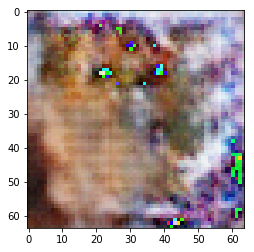

tensor(0.9226, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3807, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


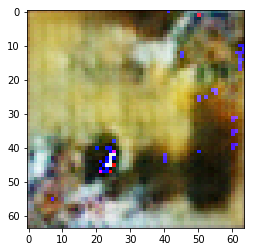

tensor(0.7021, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9924, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


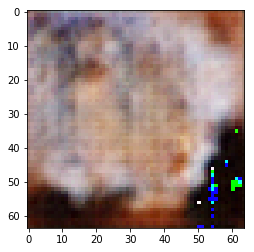

tensor(0.4614, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0616, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


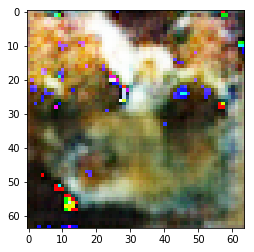

tensor(0.6945, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9590, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


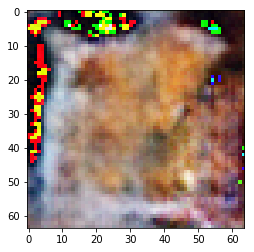

tensor(0.5898, device='cuda:0', grad_fn=<NegBackward>) tensor(0.7976, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


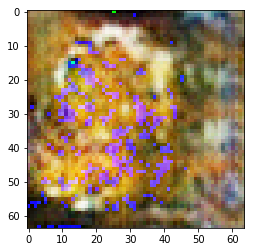

tensor(1.4463, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3801, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


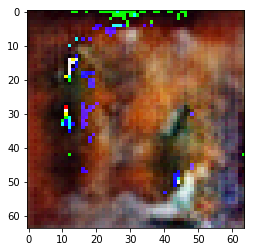

tensor(-0.0021, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2991, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


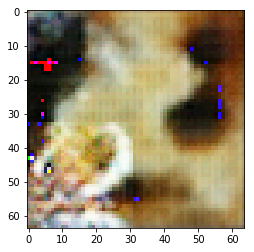

tensor(1.0526, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1662, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


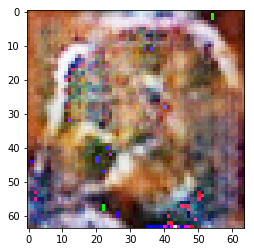

tensor(0.6699, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0469, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


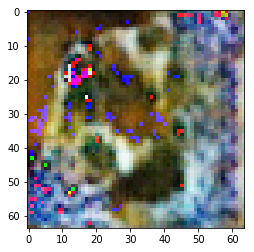

tensor(0.5197, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1430, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


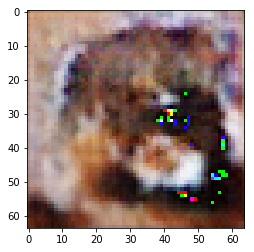

tensor(1.0497, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0233, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


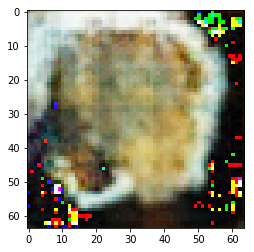

tensor(0.5706, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1568, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


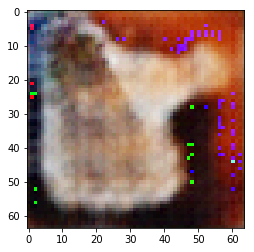

tensor(0.7754, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2962, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


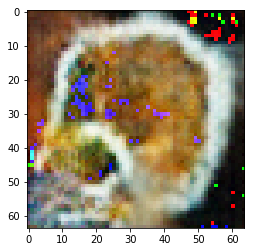

tensor(0.5938, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0134, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


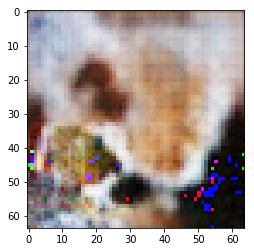

tensor(0.9478, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9561, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


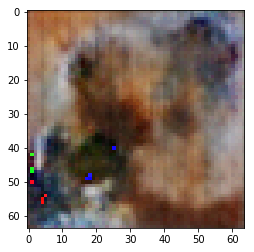

tensor(1.3244, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2630, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


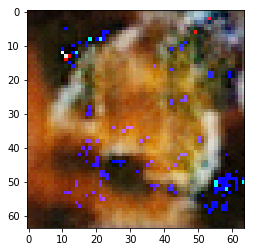

tensor(1.0796, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1910, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


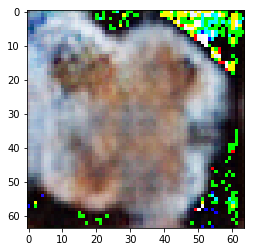

tensor(0.3897, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1451, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


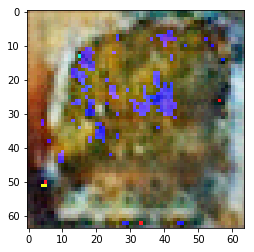

tensor(0.3835, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1198, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


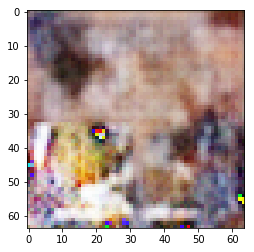

tensor(0.3388, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9418, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


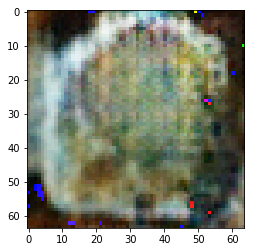

tensor(0.6393, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0563, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


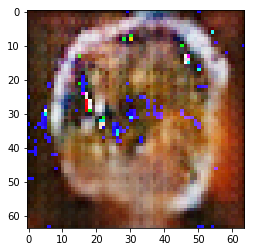

tensor(1.0032, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2695, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


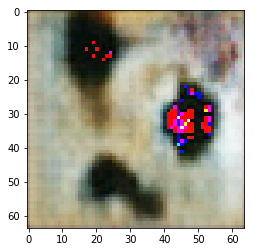

tensor(0.0457, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3571, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


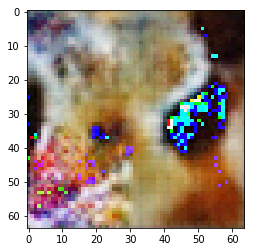

tensor(0.7418, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2365, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


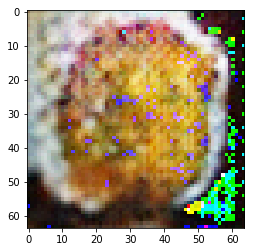

tensor(0.5434, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4434, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


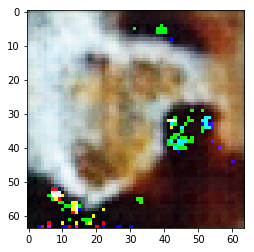

tensor(0.1283, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3248, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


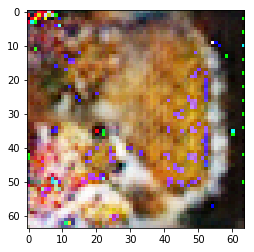

tensor(0.2040, device='cuda:0', grad_fn=<NegBackward>) tensor(1.7266, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


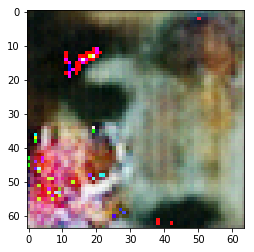

tensor(-0.4185, device='cuda:0', grad_fn=<NegBackward>) tensor(1.6428, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


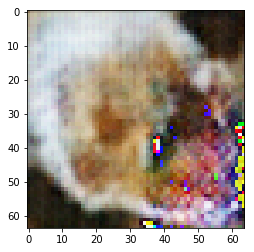

tensor(0.2983, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5355, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


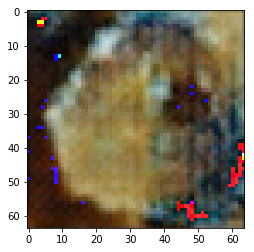

tensor(0.5874, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4805, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


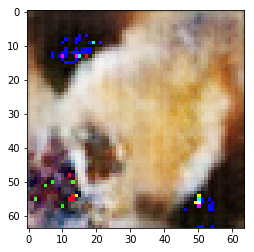

tensor(0.3765, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5839, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


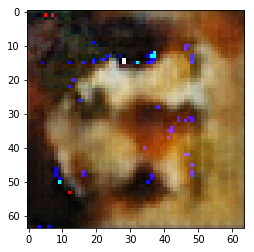

tensor(0.9701, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1260, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


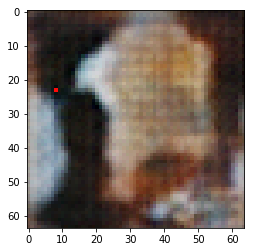

tensor(0.2352, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0456, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


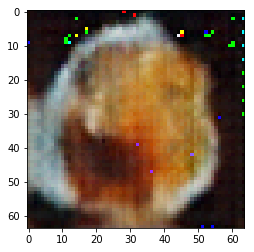

tensor(0.5866, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2246, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


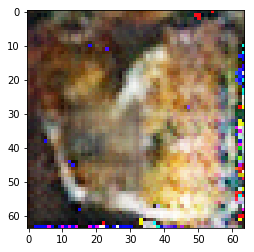

tensor(0.6082, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5087, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


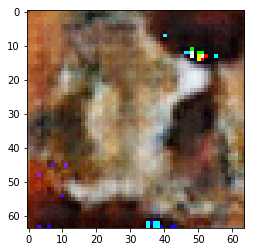

tensor(0.8410, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2432, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


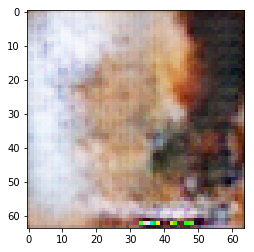

tensor(0.6063, device='cuda:0', grad_fn=<NegBackward>) tensor(1.7468, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


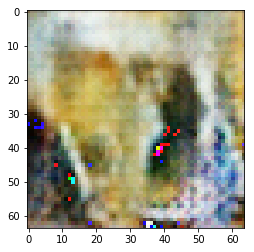

tensor(0.5486, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3637, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


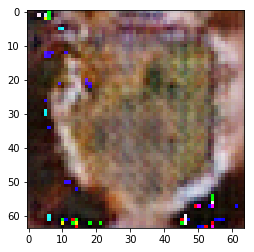

tensor(0.3969, device='cuda:0', grad_fn=<NegBackward>) tensor(1.6264, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


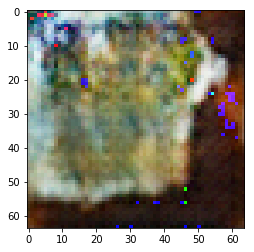

tensor(0.3313, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2035, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


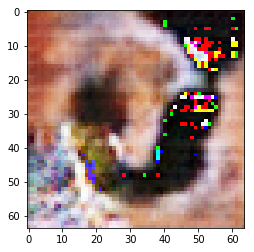

tensor(0.8015, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2784, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


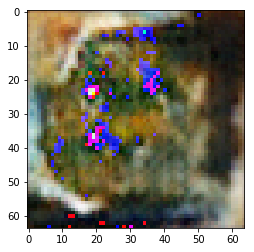

tensor(0.7946, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2979, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


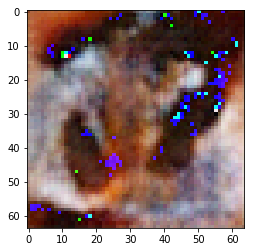

tensor(0.4884, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4822, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


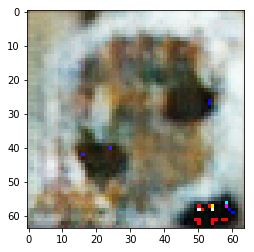

tensor(0.2497, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1904, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


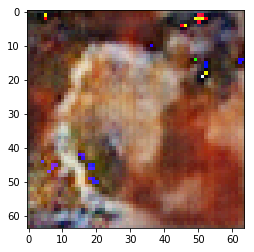

tensor(0.3936, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5852, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


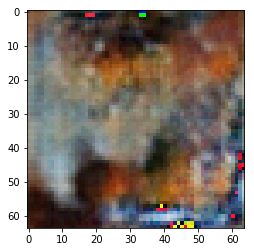

tensor(0.0067, device='cuda:0', grad_fn=<NegBackward>) tensor(1.6101, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


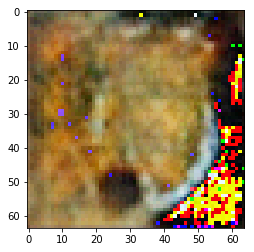

tensor(0.4038, device='cuda:0', grad_fn=<NegBackward>) tensor(1.6424, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


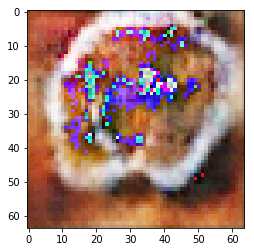

tensor(0.4964, device='cuda:0', grad_fn=<NegBackward>) tensor(1.6113, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


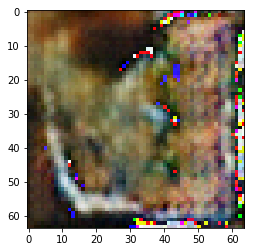

tensor(0.4320, device='cuda:0', grad_fn=<NegBackward>) tensor(1.7474, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


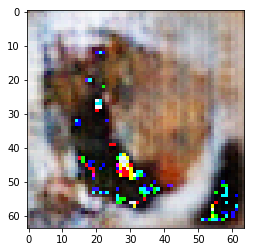

tensor(0.4729, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4421, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


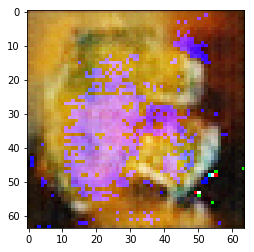

tensor(1.0208, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3321, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


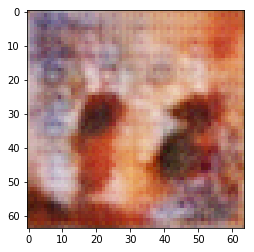

tensor(0.8981, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2749, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


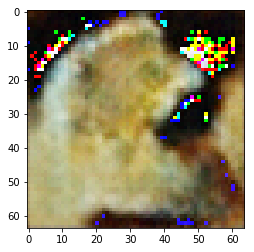

tensor(0.2341, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9535, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


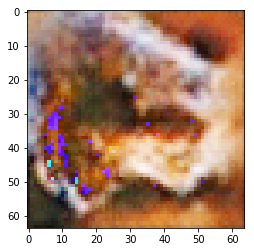

tensor(0.4404, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3374, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


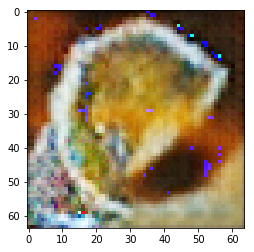

tensor(0.3870, device='cuda:0', grad_fn=<NegBackward>) tensor(1.7766, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


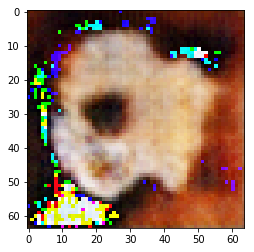

tensor(0.6749, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2292, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


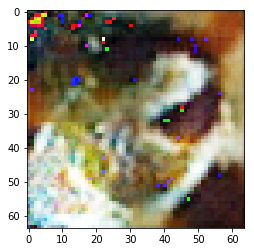

tensor(0.2075, device='cuda:0', grad_fn=<NegBackward>) tensor(1.7924, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


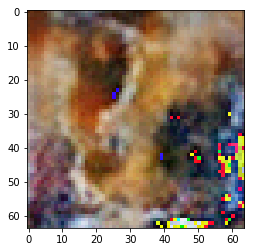

tensor(0.3305, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4221, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


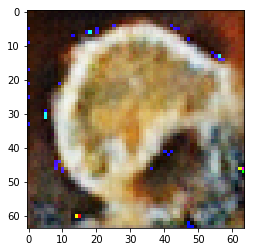

tensor(0.5924, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4599, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


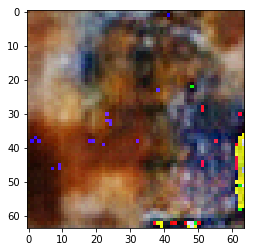

tensor(1.2440, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9504, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


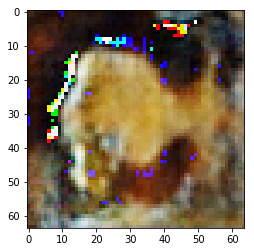

tensor(0.3832, device='cuda:0', grad_fn=<NegBackward>) tensor(1.6649, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


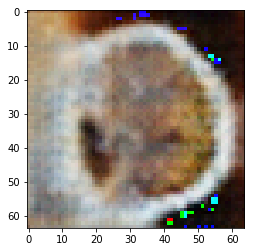

tensor(0.3015, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2809, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


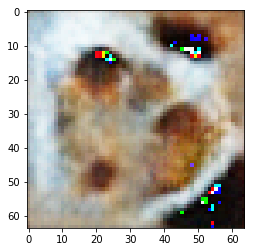

tensor(0.2280, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2761, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


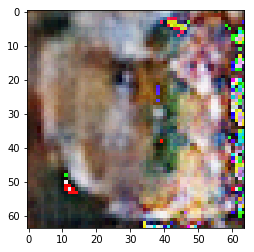

tensor(0.4222, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0905, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


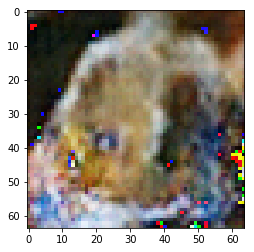

tensor(0.9347, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1553, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


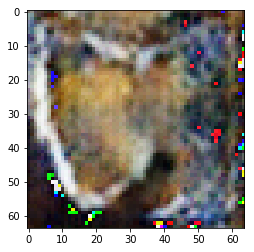

tensor(-0.1128, device='cuda:0', grad_fn=<NegBackward>) tensor(1.6729, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


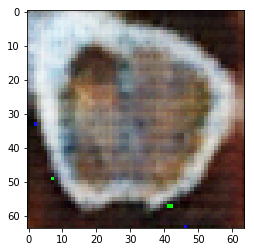

tensor(0.9270, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3607, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


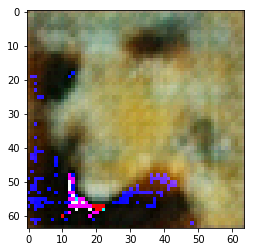

tensor(0.9340, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0615, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


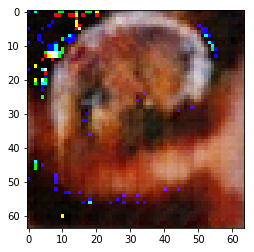

tensor(0.8197, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4524, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


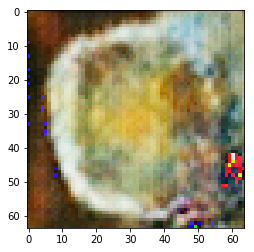

tensor(1.9766, device='cuda:0', grad_fn=<NegBackward>) tensor(1.6575, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


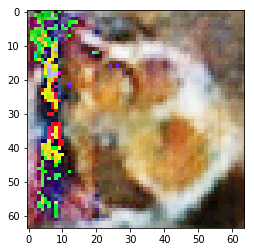

tensor(0.4682, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2303, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


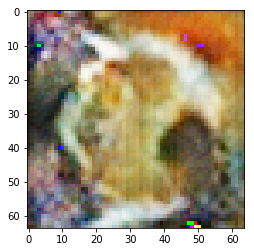

tensor(0.5820, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4187, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


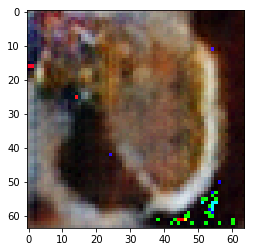

tensor(0.4325, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9916, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


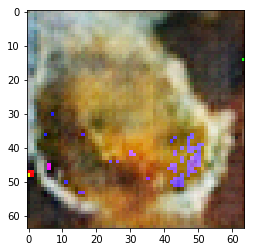

tensor(0.6600, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2854, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


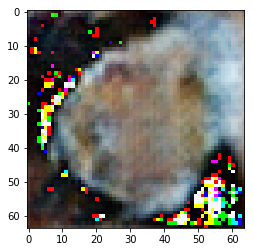

tensor(0.5121, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4236, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


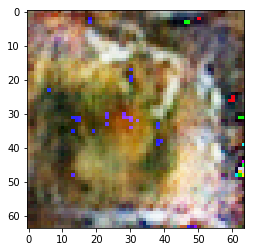

tensor(0.8975, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0794, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


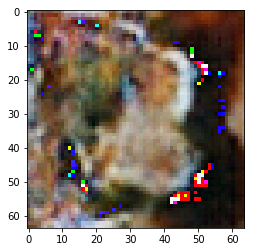

tensor(0.1572, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5167, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


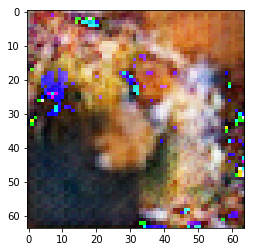

tensor(0.3976, device='cuda:0', grad_fn=<NegBackward>) tensor(1.8683, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


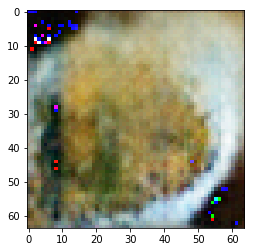

tensor(0.0890, device='cuda:0', grad_fn=<NegBackward>) tensor(1.7233, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


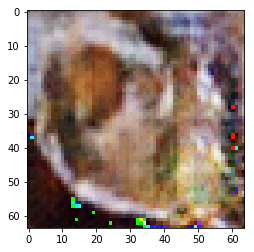

tensor(-0.1518, device='cuda:0', grad_fn=<NegBackward>) tensor(1.7033, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


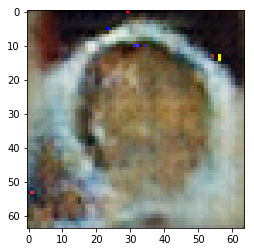

tensor(0.7109, device='cuda:0', grad_fn=<NegBackward>) tensor(1.6296, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


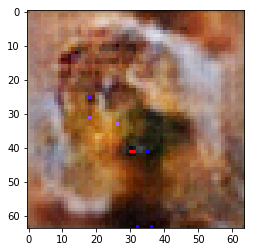

tensor(0.6627, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1237, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


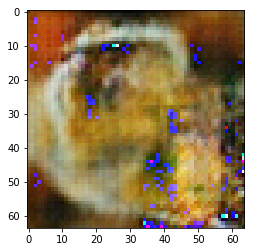

tensor(1.0830, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4271, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


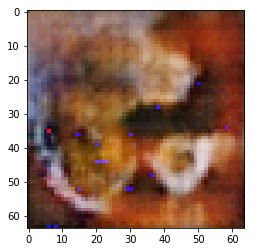

tensor(0.0052, device='cuda:0', grad_fn=<NegBackward>) tensor(1.6270, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


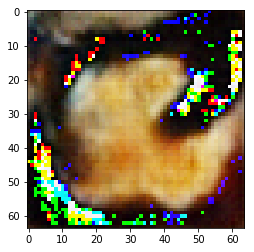

tensor(1.0912, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0875, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


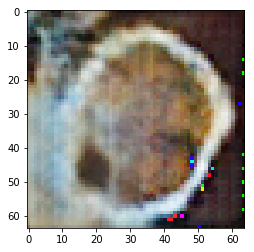

tensor(0.6682, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0473, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


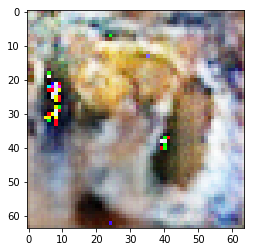

tensor(0.6871, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2792, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


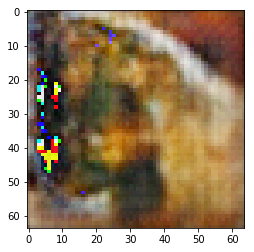

tensor(0.7831, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1454, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


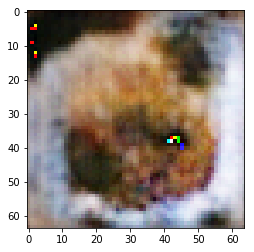

tensor(0.3980, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1582, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


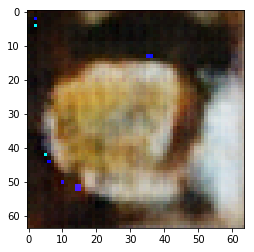

tensor(0.5498, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4628, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


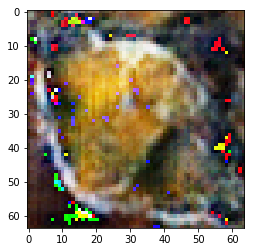

tensor(0.5706, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2091, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


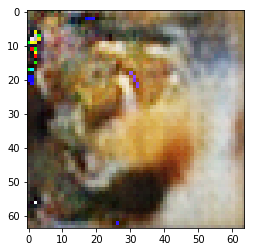

tensor(0.8987, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1904, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


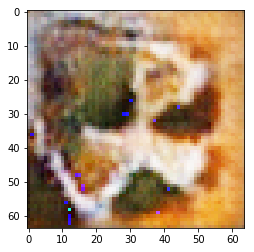

tensor(0.0490, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5498, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


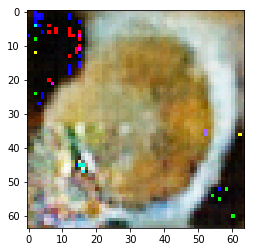

tensor(0.7271, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2686, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


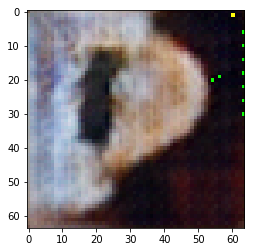

tensor(0.1002, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2490, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


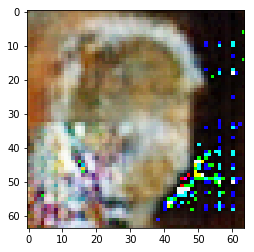

tensor(-0.0451, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3394, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


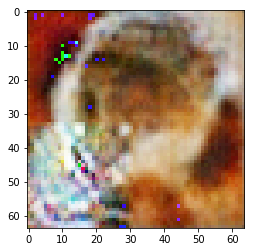

tensor(0.4021, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4051, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


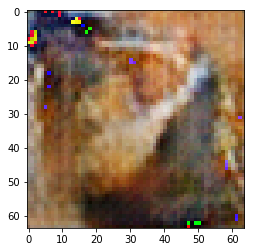

tensor(-0.1905, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2991, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


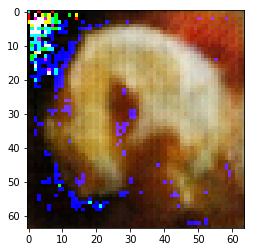

tensor(0.8110, device='cuda:0', grad_fn=<NegBackward>) tensor(1.6687, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


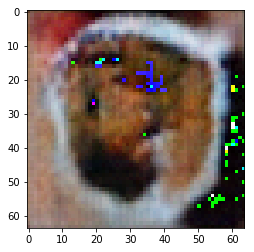

tensor(0.5028, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1522, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


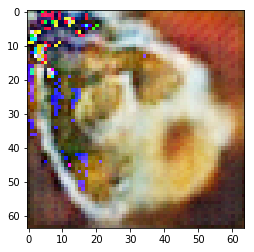

tensor(0.3079, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1536, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


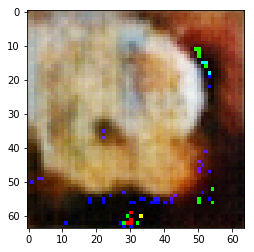

tensor(0.4573, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3867, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


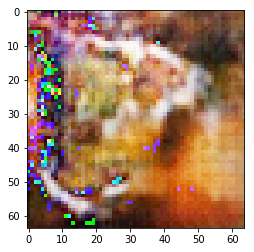

tensor(-0.3552, device='cuda:0', grad_fn=<NegBackward>) tensor(1.7755, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


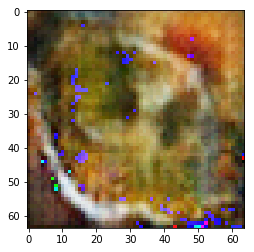

tensor(-0.3033, device='cuda:0', grad_fn=<NegBackward>) tensor(1.7643, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


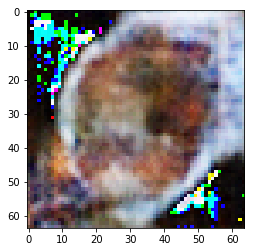

tensor(0.4286, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2974, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


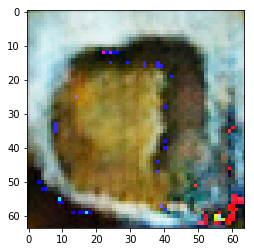

tensor(0.1684, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4867, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


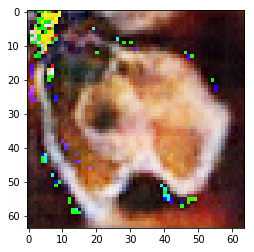

tensor(0.3321, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3029, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


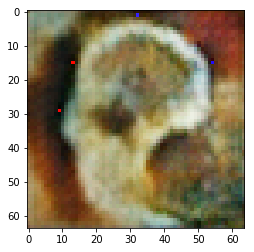

tensor(0.9327, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1305, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


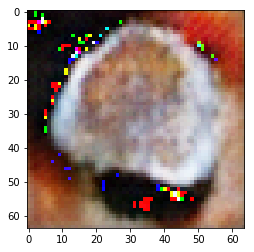

tensor(0.0177, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2066, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


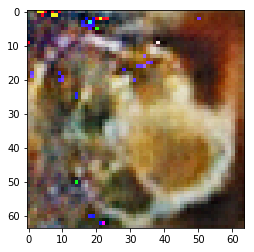

tensor(-0.2187, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4837, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


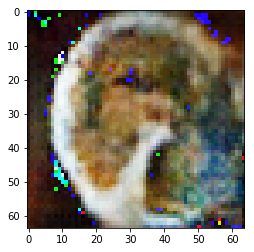

tensor(0.3386, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4728, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


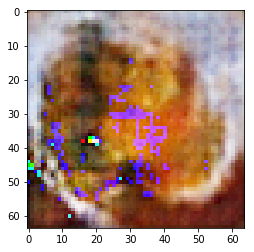

tensor(0.9033, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4911, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


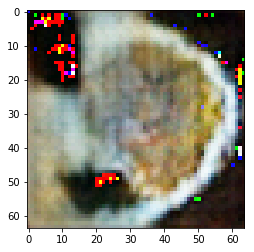

tensor(0.4934, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2447, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


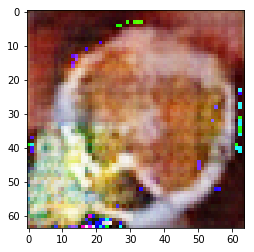

tensor(0.6856, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4819, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


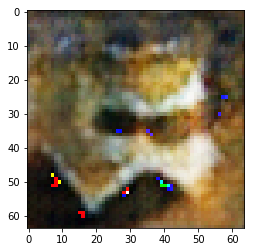

tensor(0.4127, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2932, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


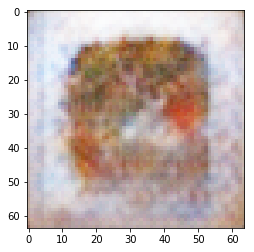

tensor(-0.4108, device='cuda:0', grad_fn=<NegBackward>) tensor(1.6938, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


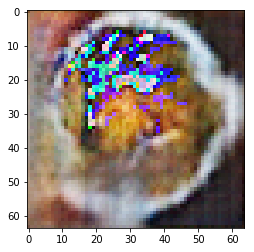

tensor(0.3959, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5346, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


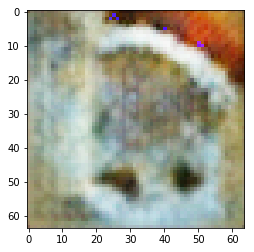

tensor(0.9663, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1741, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


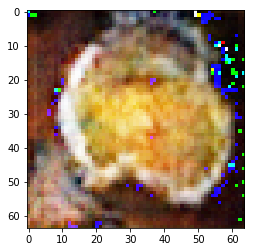

tensor(-0.3072, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3849, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


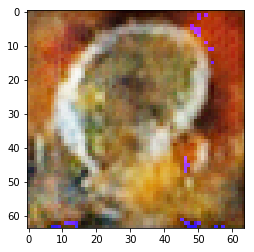

tensor(0.3117, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4789, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


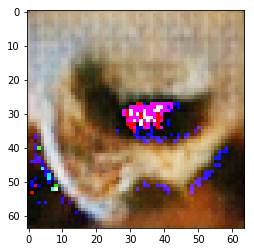

tensor(-0.0070, device='cuda:0', grad_fn=<NegBackward>) tensor(1.8508, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


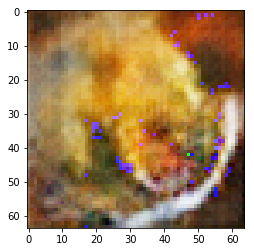

tensor(0.9579, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3945, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


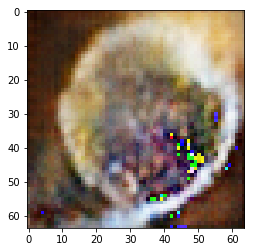

tensor(0.1905, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4361, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


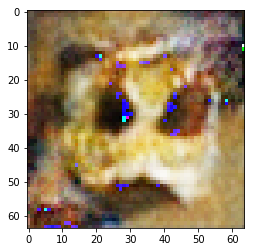

tensor(0.3223, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3761, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


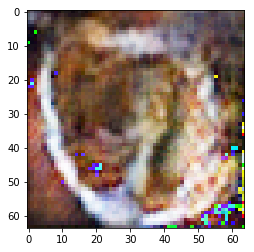

tensor(0.4586, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3492, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


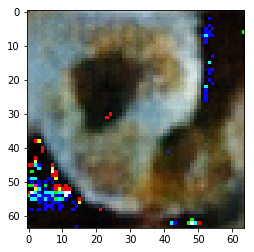

tensor(0.6944, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3683, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


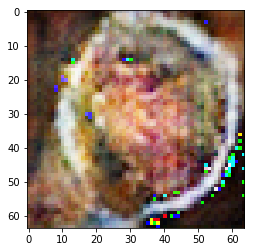

tensor(0.4149, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5173, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


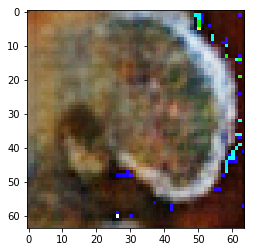

tensor(0.0269, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3823, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


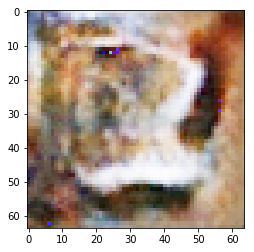

tensor(0.5726, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3374, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


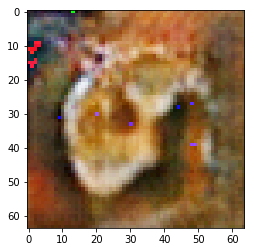

tensor(-0.3242, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4974, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


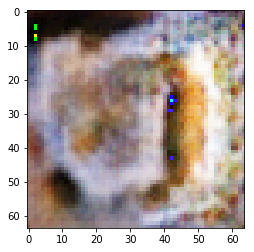

tensor(0.5464, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2545, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


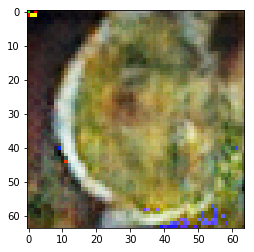

tensor(0.9031, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2883, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


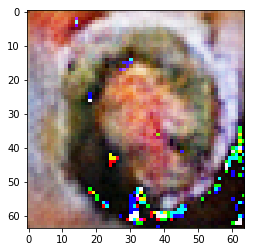

tensor(0.2711, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0906, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


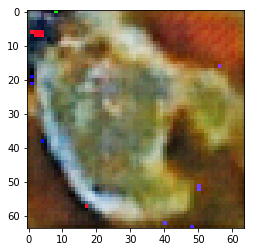

tensor(0.5804, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3266, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


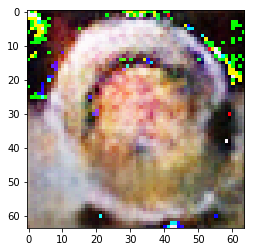

tensor(0.6883, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4781, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


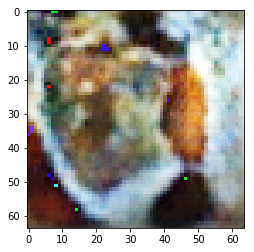

tensor(0.3391, device='cuda:0', grad_fn=<NegBackward>) tensor(1.8378, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


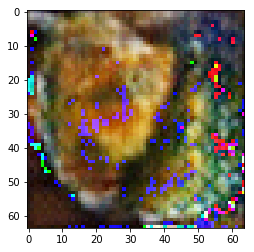

tensor(0.8763, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2150, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


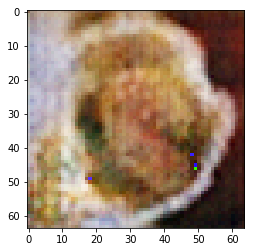

tensor(0.9987, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0551, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


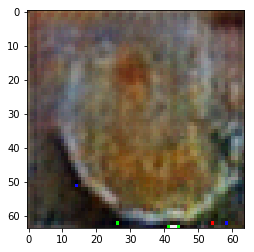

tensor(0.5251, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4436, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


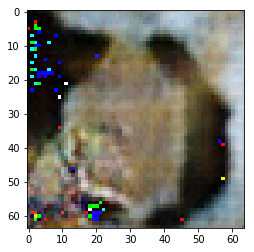

tensor(0.3671, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3557, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


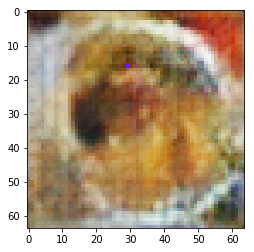

tensor(0.8089, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5363, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


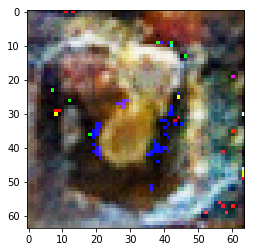

tensor(0.1753, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4009, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


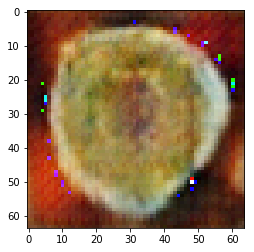

tensor(0.6156, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5963, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


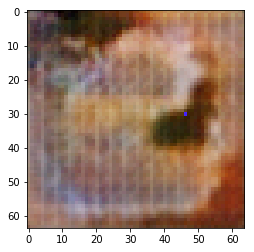

tensor(-0.2022, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3924, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


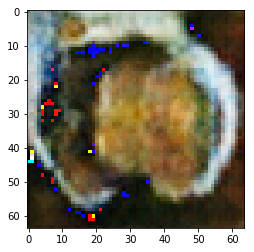

tensor(0.2374, device='cuda:0', grad_fn=<NegBackward>) tensor(1.8580, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


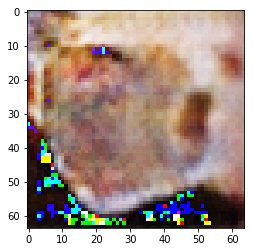

tensor(0.3449, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9318, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


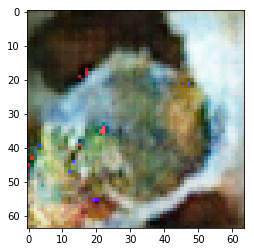

tensor(0.4727, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3423, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


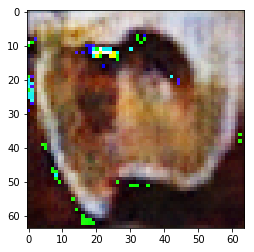

tensor(1.2782, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5713, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


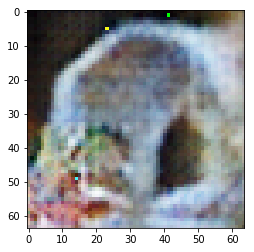

tensor(0.3142, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5056, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


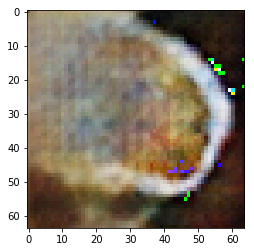

tensor(0.8938, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4700, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


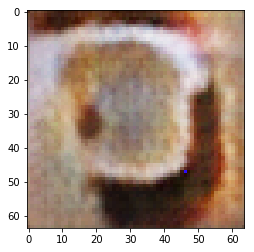

tensor(0.5661, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2747, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


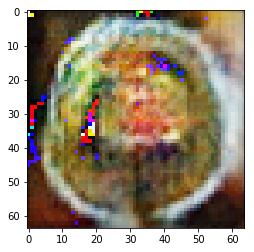

tensor(0.6534, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9799, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


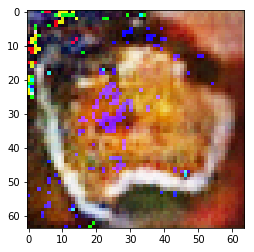

tensor(0.8940, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1078, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


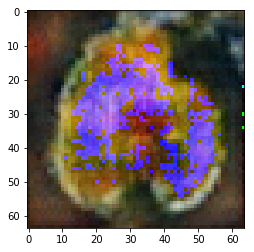

tensor(0.0567, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3809, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


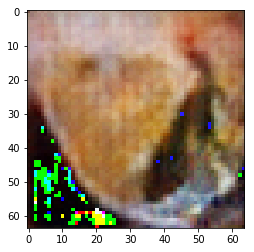

tensor(0.2687, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0242, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


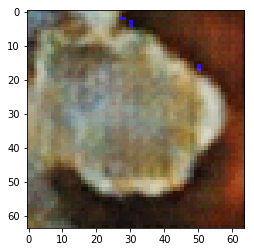

tensor(0.4034, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5040, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


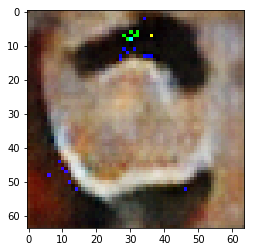

tensor(-0.1421, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5189, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


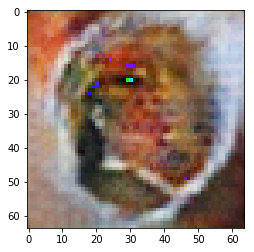

tensor(0.9047, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5787, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


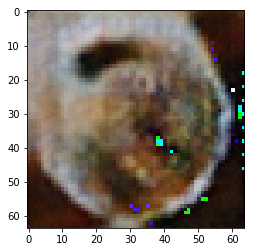

tensor(0.9496, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5654, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


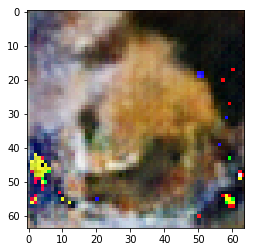

tensor(0.5617, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3209, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


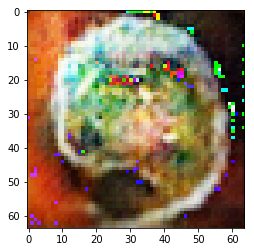

tensor(-0.7478, device='cuda:0', grad_fn=<NegBackward>) tensor(1.9675, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


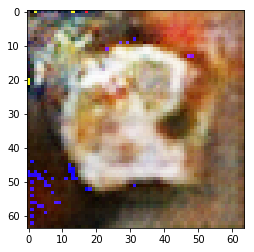

tensor(0.2291, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4260, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


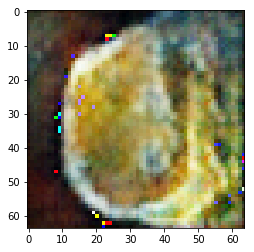

tensor(0.8133, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1689, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


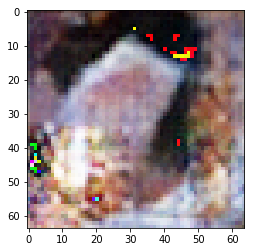

tensor(0.8252, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9590, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


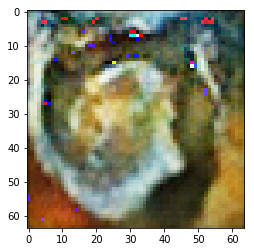

tensor(0.9755, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5953, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


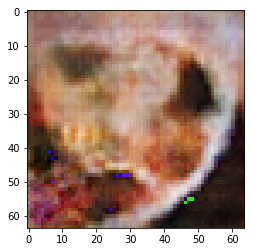

tensor(0.2394, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3922, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


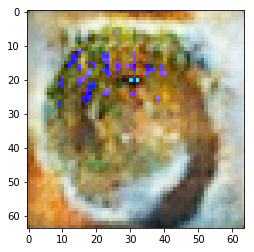

tensor(0.7315, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3080, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


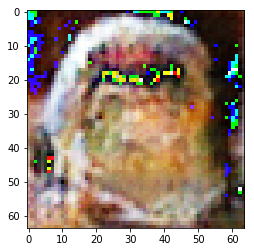

tensor(0.6636, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4536, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


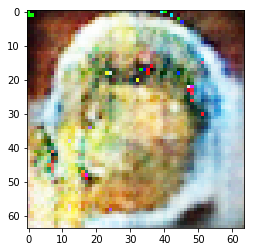

tensor(0.3350, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5354, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


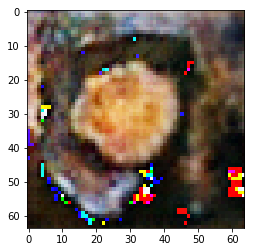

tensor(0.7044, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5443, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


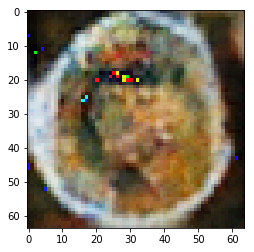

tensor(1.1055, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2105, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


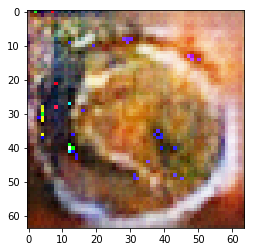

tensor(-0.6059, device='cuda:0', grad_fn=<NegBackward>) tensor(1.8098, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


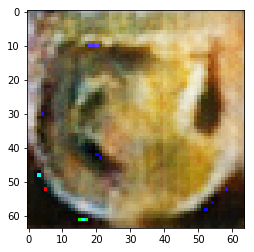

tensor(0.0871, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3150, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


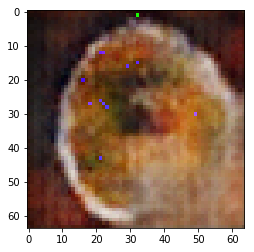

tensor(0.7314, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2565, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


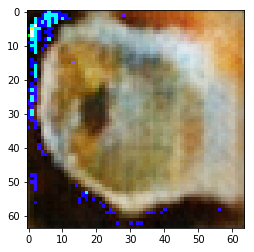

tensor(0.7056, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9028, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


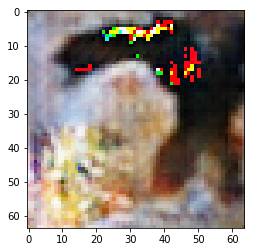

tensor(-0.0830, device='cuda:0', grad_fn=<NegBackward>) tensor(1.6792, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


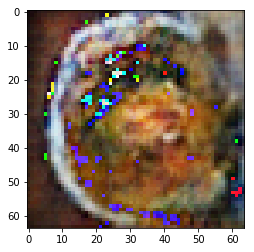

tensor(0.2206, device='cuda:0', grad_fn=<NegBackward>) tensor(1.8304, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


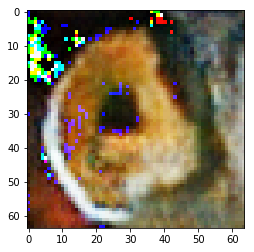

tensor(0.3942, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3323, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


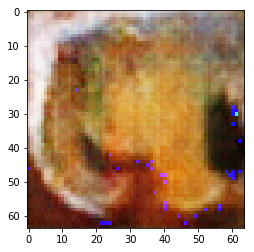

tensor(0.7654, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5083, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


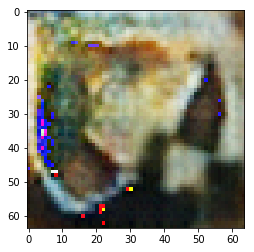

tensor(0.8060, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2113, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


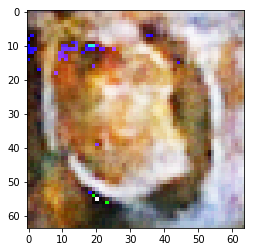

tensor(0.6053, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4315, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


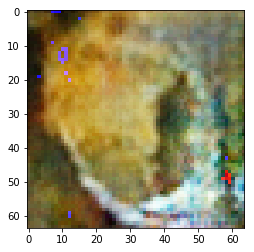

tensor(0.6910, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0267, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


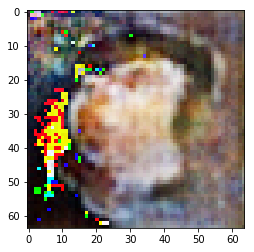

tensor(0.3365, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9573, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


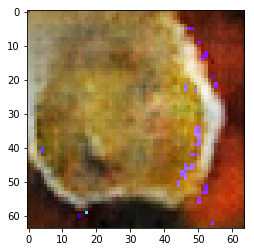

tensor(0.1619, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3495, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


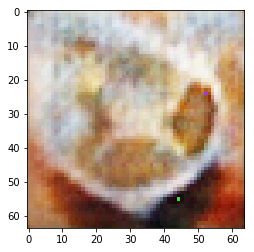

tensor(1.0065, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5121, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


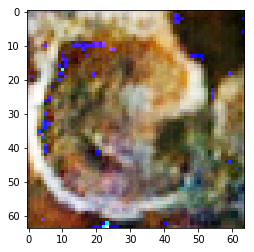

tensor(0.5502, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3723, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


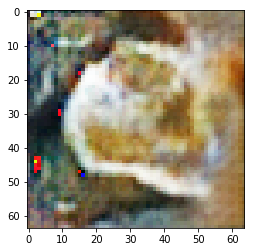

tensor(0.3593, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3018, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


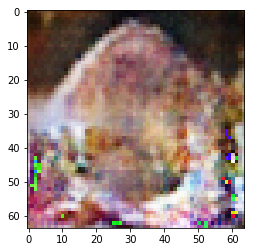

tensor(0.7466, device='cuda:0', grad_fn=<NegBackward>) tensor(0.8407, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


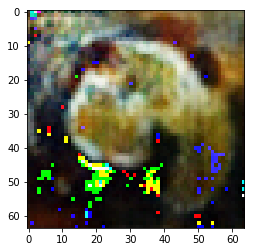

tensor(0.4246, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3009, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


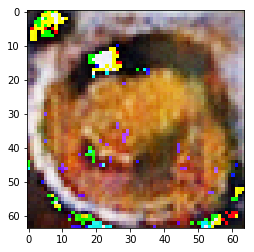

tensor(0.2467, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2361, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


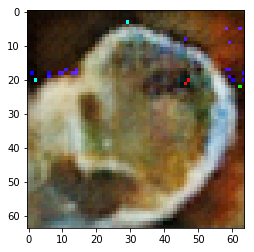

tensor(-0.7172, device='cuda:0', grad_fn=<NegBackward>) tensor(1.7213, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


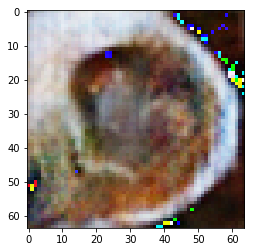

tensor(0.5887, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5394, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


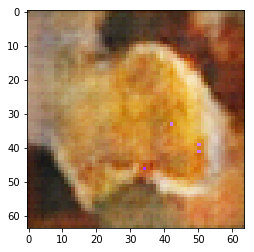

tensor(0.4008, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4206, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


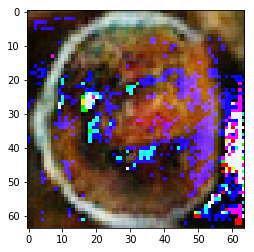

tensor(0.2847, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3035, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


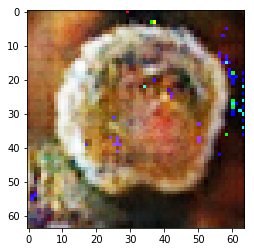

tensor(-0.1272, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5571, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


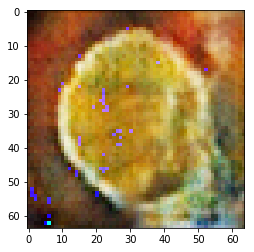

tensor(0.3835, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2109, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


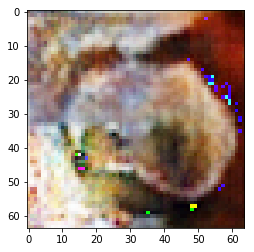

tensor(0.1946, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3331, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


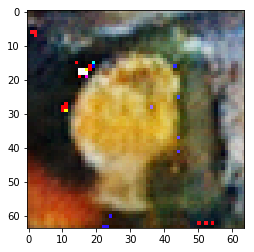

tensor(0.7180, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0255, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


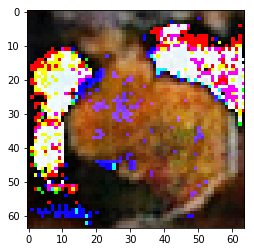

tensor(-0.0502, device='cuda:0', grad_fn=<NegBackward>) tensor(1.6218, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


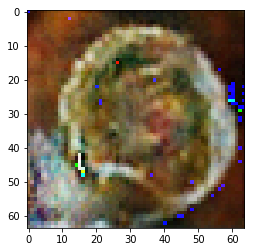

tensor(-0.0925, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5022, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


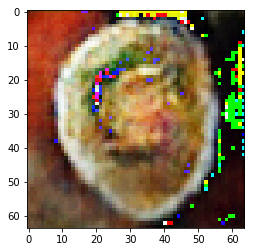

tensor(0.2756, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4608, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


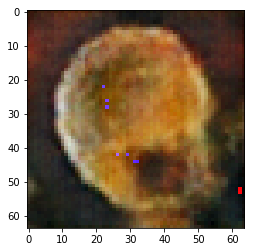

tensor(0.5614, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5318, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


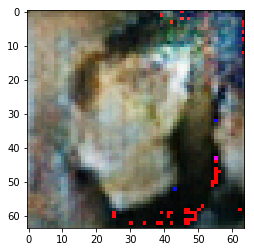

tensor(0.2961, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5305, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


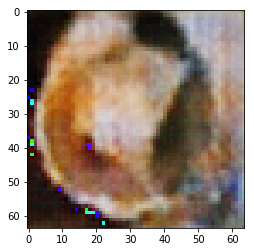

tensor(0.0258, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2886, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


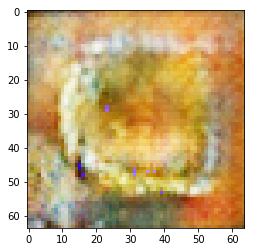

tensor(1.1714, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3013, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


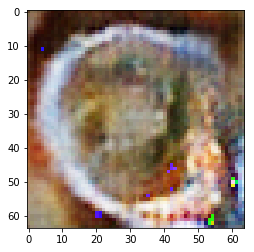

tensor(0.3036, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2185, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


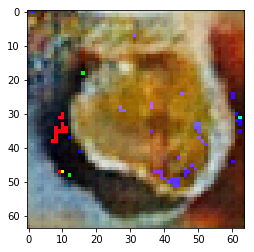

tensor(-0.5706, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5993, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


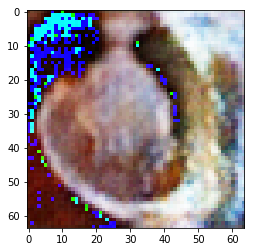

tensor(0.2221, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4422, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


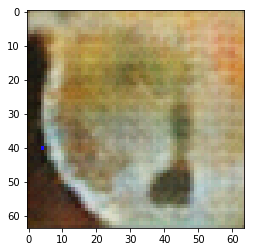

tensor(0.0338, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4853, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


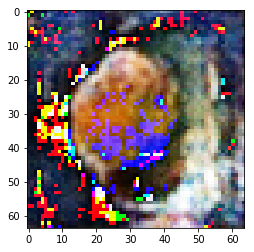

tensor(0.4554, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4103, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


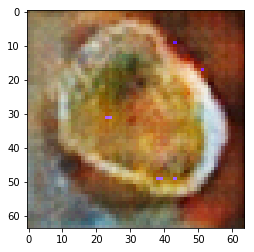

tensor(0.0846, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1617, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


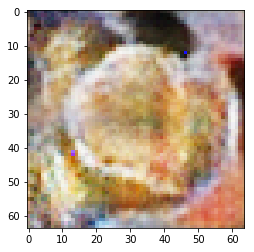

tensor(0.1988, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3394, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


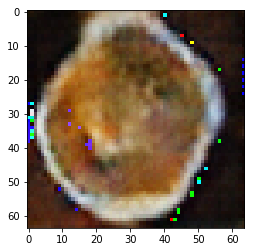

tensor(-0.1245, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4690, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


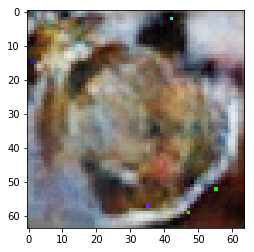

tensor(0.1909, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2519, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


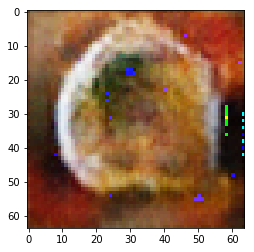

tensor(0.8382, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2896, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


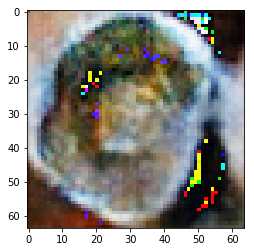

tensor(0.7102, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3084, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


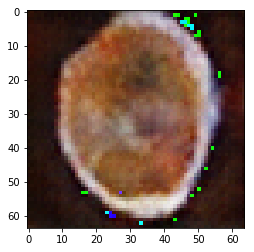

tensor(0.3560, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5457, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


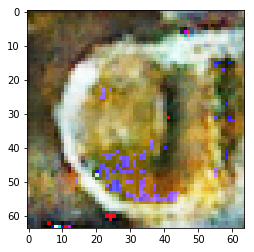

tensor(0.5152, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2531, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


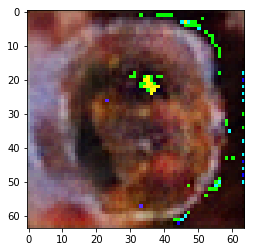

tensor(-0.2751, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4935, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


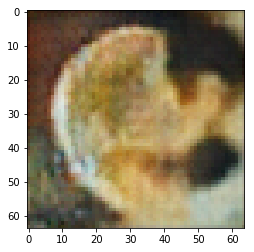

tensor(0.5946, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4228, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


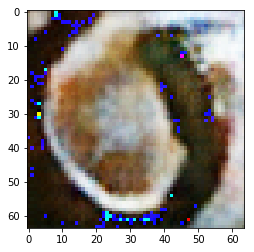

tensor(0.7699, device='cuda:0', grad_fn=<NegBackward>) tensor(1.6344, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


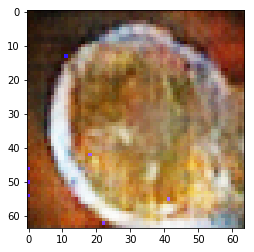

tensor(0.3650, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0221, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


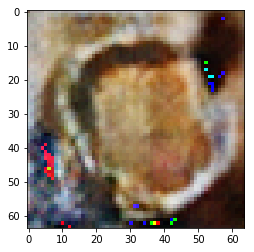

tensor(0.7734, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0158, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


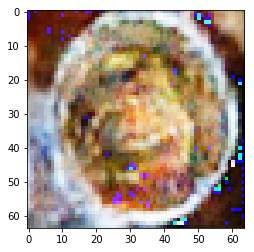

tensor(0.3396, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3162, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


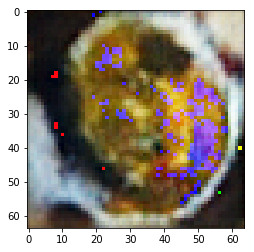

tensor(0.5224, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9221, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


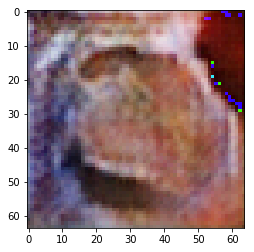

tensor(0.9792, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9368, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


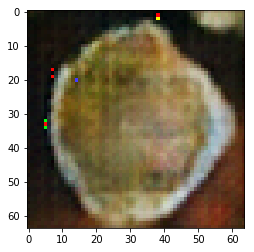

tensor(0.7799, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4137, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


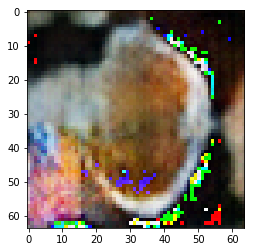

tensor(0.5930, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5018, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


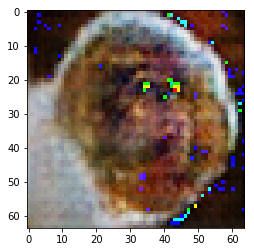

tensor(0.5007, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3057, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


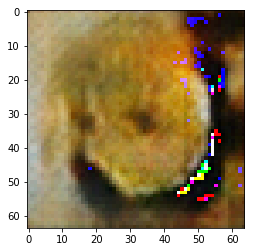

tensor(0.6260, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4423, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


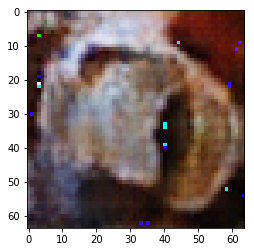

tensor(1.1049, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2203, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


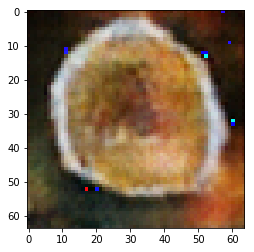

tensor(0.2192, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1766, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


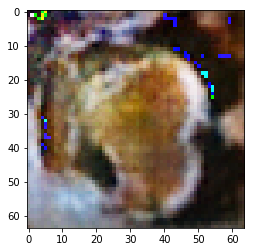

tensor(-0.3478, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5262, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


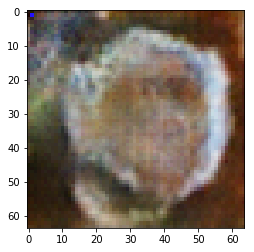

tensor(0.5458, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2380, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


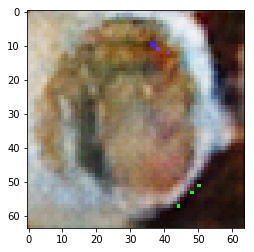

tensor(1.0561, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1785, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


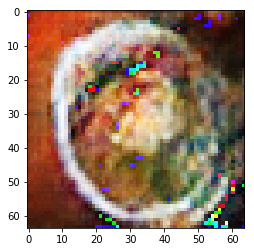

tensor(1.1899, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4210, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


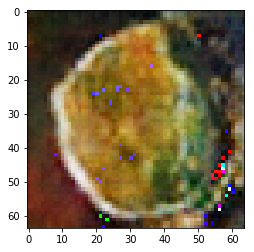

tensor(-0.0734, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3559, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


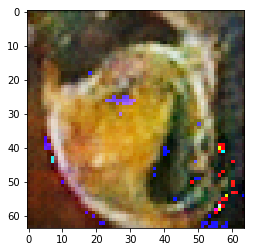

tensor(0.4958, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4654, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


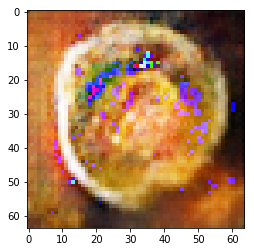

tensor(0.2989, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1649, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


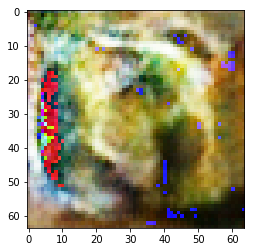

tensor(0.1247, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3014, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


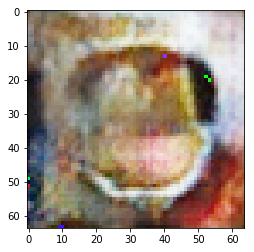

tensor(1.5878, device='cuda:0', grad_fn=<NegBackward>) tensor(1.8780, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


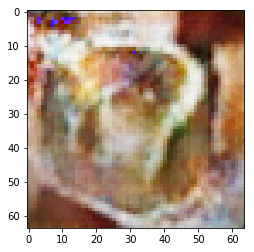

tensor(0.4618, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2932, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


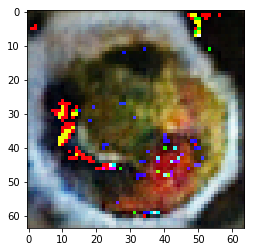

tensor(0.4701, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3720, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


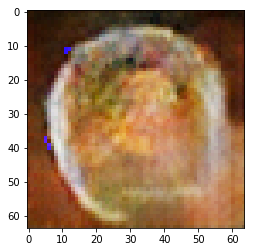

tensor(0.3831, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3795, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


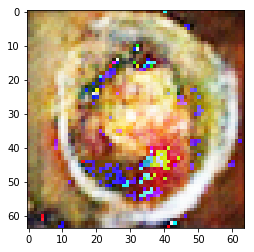

tensor(0.7823, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4570, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


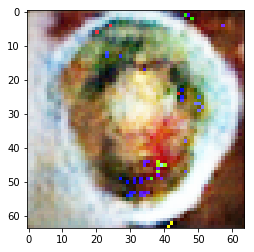

tensor(0.4223, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3132, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


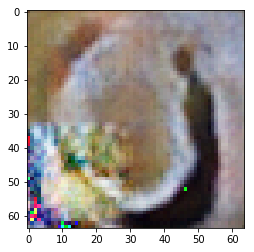

tensor(1.1341, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4040, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


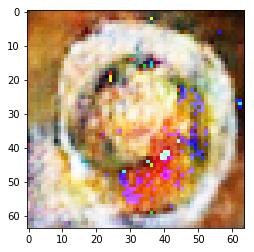

tensor(0.5164, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0457, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


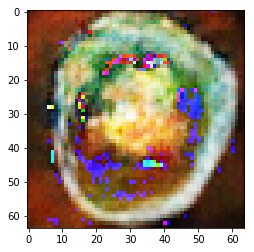

tensor(0.3743, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4274, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


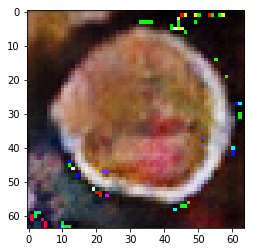

tensor(0.6150, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2035, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


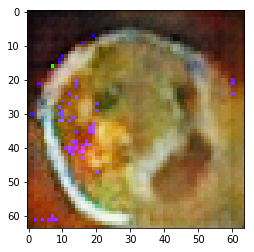

tensor(1.1352, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2319, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


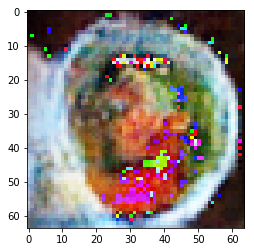

tensor(0.5388, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3709, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


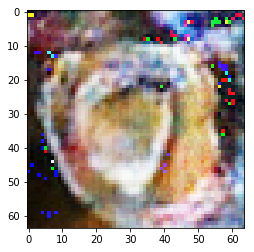

tensor(0.4414, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2098, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


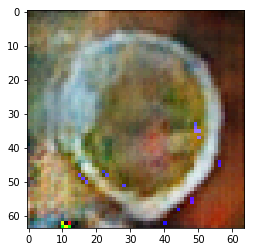

tensor(0.3331, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2534, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


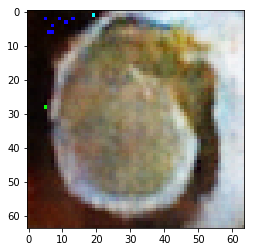

tensor(1.2417, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3773, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


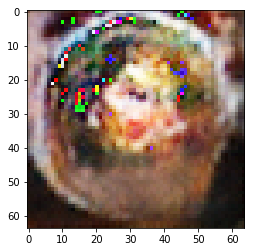

tensor(0.5024, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0436, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


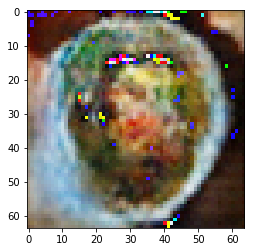

tensor(1.0839, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3645, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


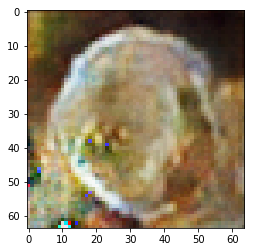

tensor(0.8220, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4689, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


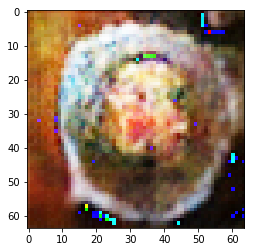

tensor(0.1876, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1408, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


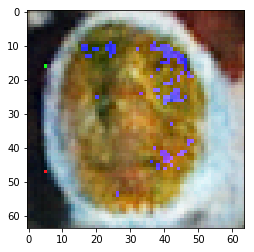

tensor(-0.0467, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2428, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


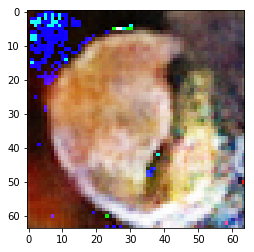

tensor(0.4489, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9769, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


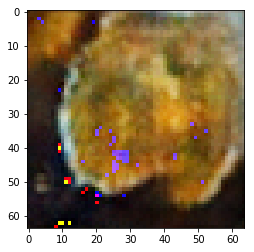

tensor(0.3023, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2349, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


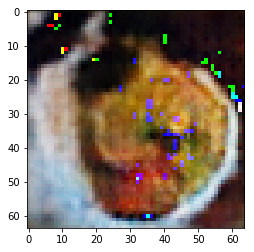

tensor(0.1157, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4919, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


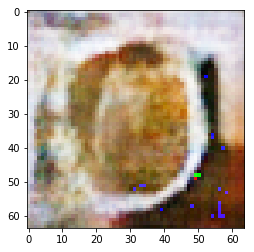

tensor(0.2274, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1150, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


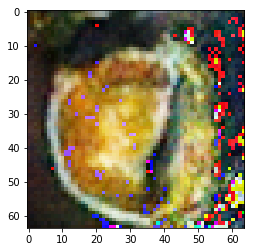

tensor(-0.3208, device='cuda:0', grad_fn=<NegBackward>) tensor(1.6177, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


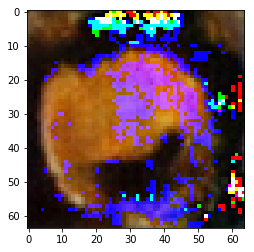

tensor(0.6481, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1147, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


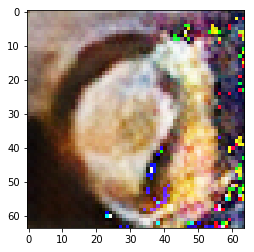

tensor(0.3889, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2325, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


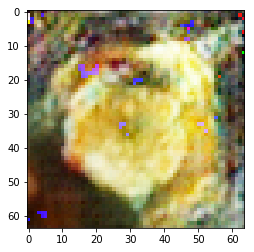

tensor(1.4418, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4929, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


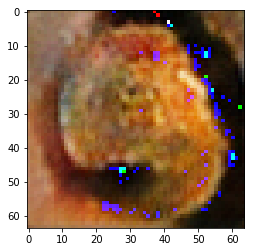

tensor(0.6877, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0668, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


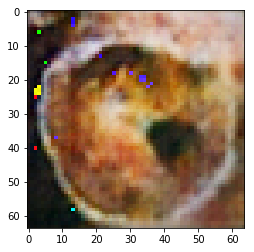

tensor(0.2839, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0136, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


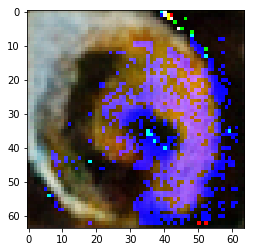

tensor(0.2163, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0881, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


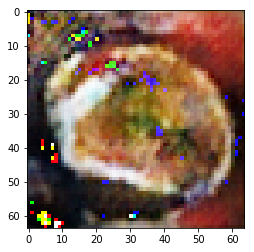

tensor(0.6434, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3150, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


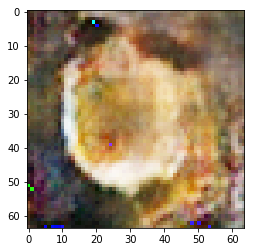

tensor(0.5347, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0124, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


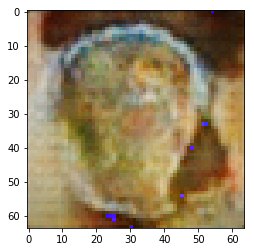

tensor(0.9187, device='cuda:0', grad_fn=<NegBackward>) tensor(0.7632, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


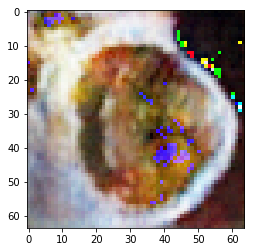

tensor(-0.0514, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5699, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


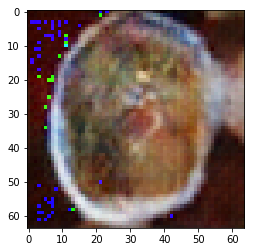

tensor(1.0323, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0388, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


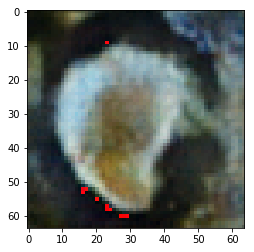

tensor(0.3374, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0089, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


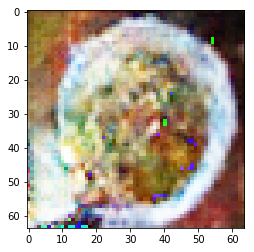

tensor(1.0414, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9281, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


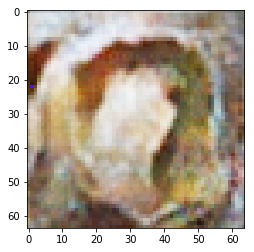

tensor(0.6720, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2213, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


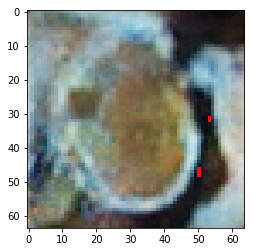

tensor(0.7928, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1508, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


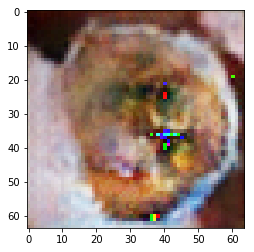

tensor(0.7560, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2449, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


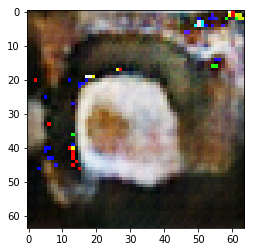

tensor(0.5886, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4161, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


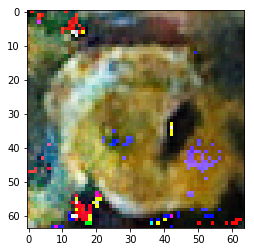

tensor(-0.8226, device='cuda:0', grad_fn=<NegBackward>) tensor(1.8391, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


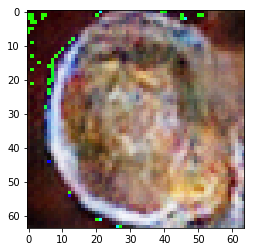

tensor(0.9835, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4778, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


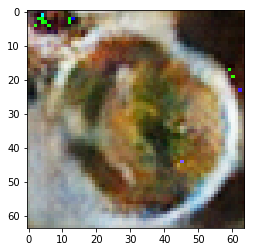

tensor(0.6345, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2914, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


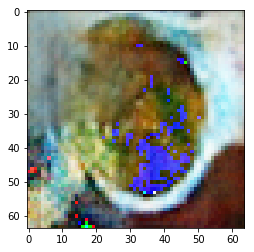

tensor(0.2360, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1370, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


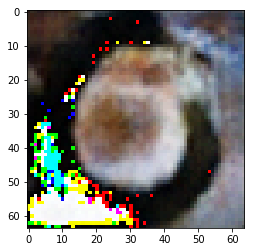

tensor(0.8768, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3325, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


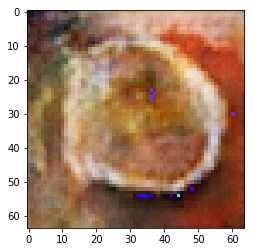

tensor(0.0224, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2047, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


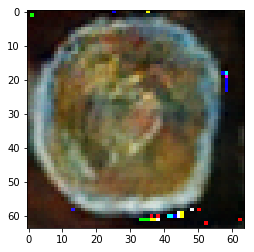

tensor(0.9301, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2310, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


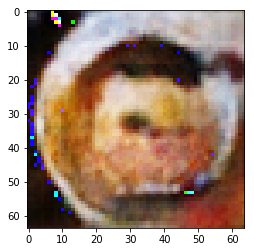

tensor(0.4958, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4725, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


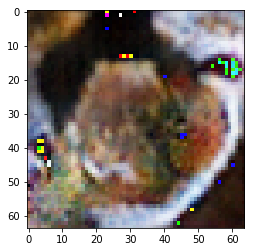

tensor(0.6765, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9201, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


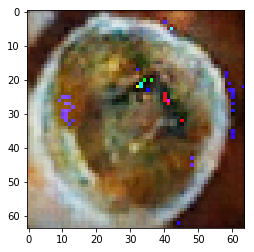

tensor(0.1326, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0305, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


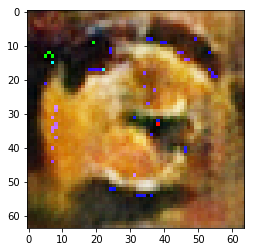

tensor(1.4051, device='cuda:0', grad_fn=<NegBackward>) tensor(2.0988, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


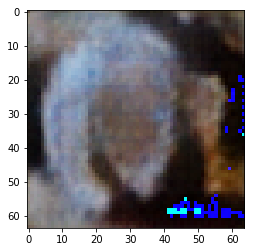

tensor(0.4256, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2765, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


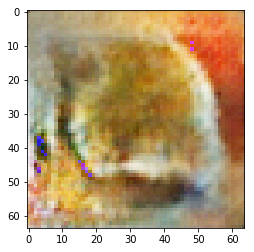

tensor(-0.2104, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4061, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


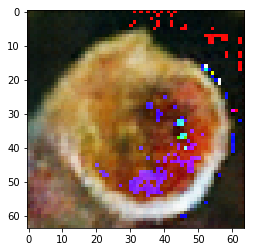

tensor(0.1046, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3531, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


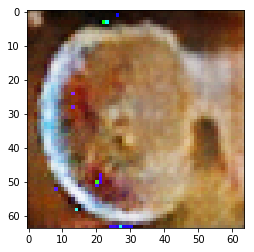

tensor(0.2731, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1410, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


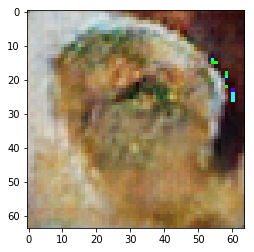

tensor(0.6905, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1752, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


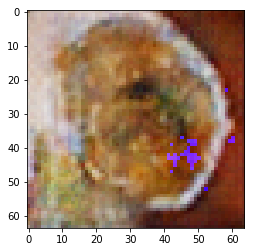

tensor(0.7626, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9929, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


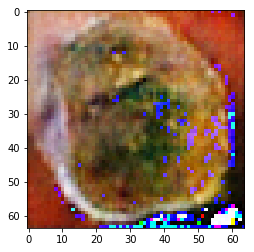

tensor(0.2121, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3724, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


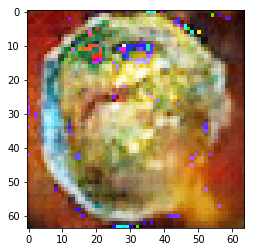

tensor(1.0172, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0330, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


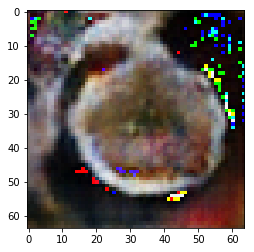

tensor(0.8788, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0867, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


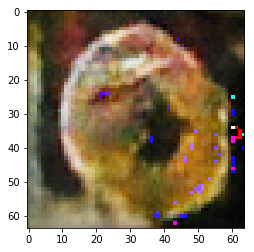

tensor(0.1539, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1177, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


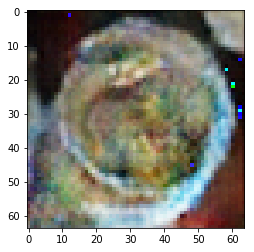

tensor(0.5311, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1412, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


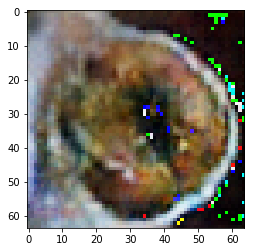

tensor(0.5118, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0267, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


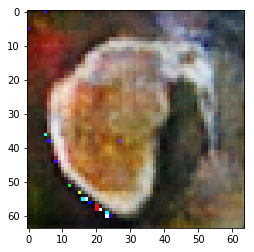

tensor(0.1976, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2853, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


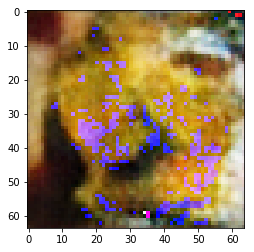

tensor(0.6896, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9558, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


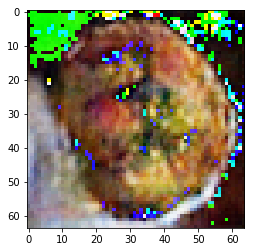

tensor(0.6457, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4514, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


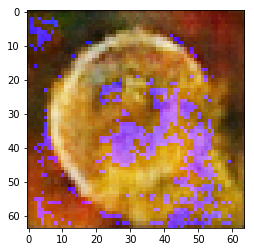

tensor(0.0377, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3747, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


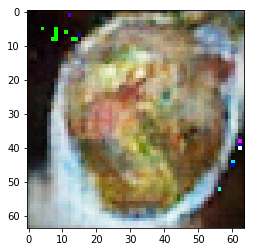

tensor(0.5953, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1381, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


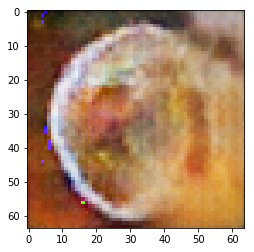

tensor(0.2532, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3943, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


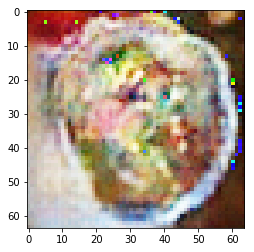

tensor(-0.9752, device='cuda:0', grad_fn=<NegBackward>) tensor(1.9905, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


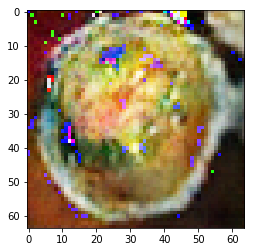

tensor(0.8578, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0356, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


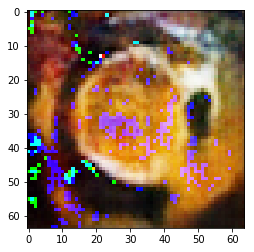

tensor(0.8998, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1182, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


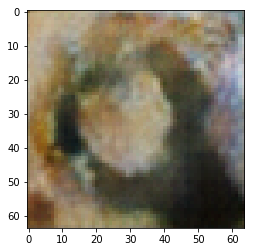

tensor(0.4767, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2999, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


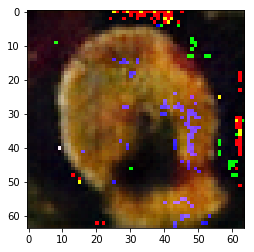

tensor(0.0162, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1910, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


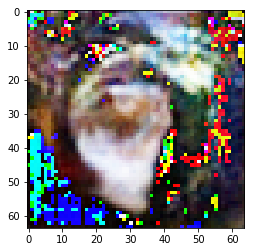

tensor(0.4064, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2801, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


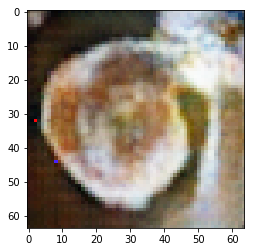

tensor(0.1690, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1739, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


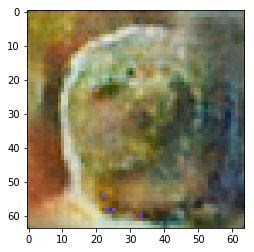

tensor(0.4922, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2042, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


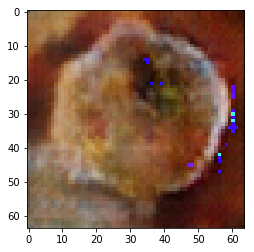

tensor(0.5444, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2836, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


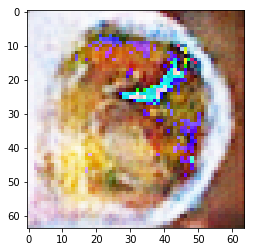

tensor(0.6689, device='cuda:0', grad_fn=<NegBackward>) tensor(0.8907, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


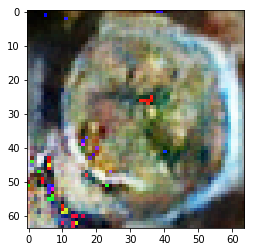

tensor(0.3745, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2015, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


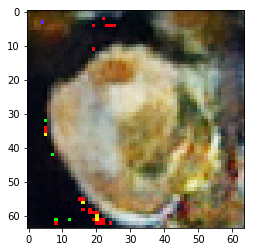

tensor(0.4455, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9873, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


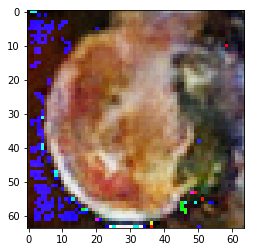

tensor(0.5228, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1495, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


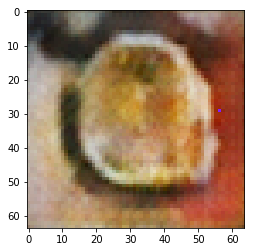

tensor(0.2091, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5567, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


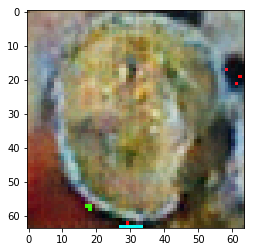

tensor(0.1283, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0482, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


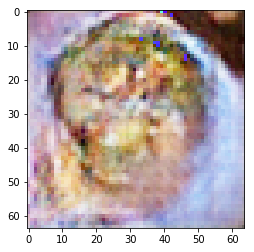

tensor(1.2784, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4780, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


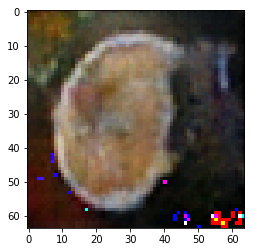

tensor(-0.0443, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2825, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


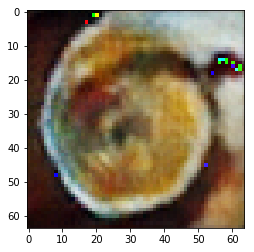

tensor(0.8801, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0818, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


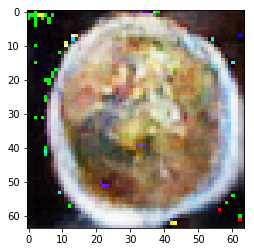

tensor(0.1982, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2165, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


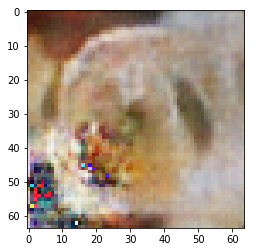

tensor(0.8535, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3089, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


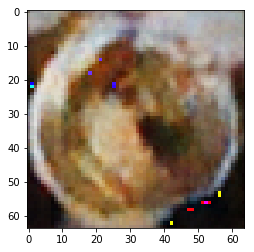

tensor(0.6403, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4557, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


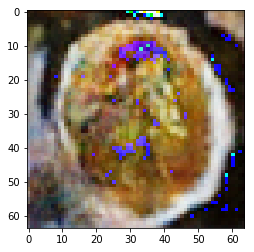

tensor(0.8538, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3701, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


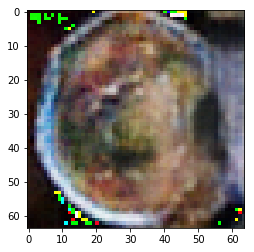

tensor(0.7914, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1716, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


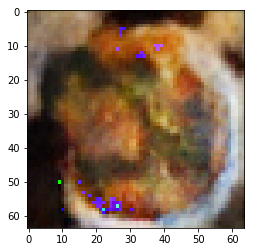

tensor(0.9539, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4119, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


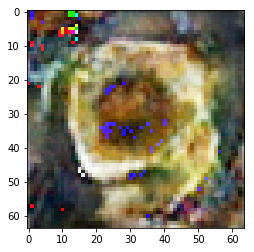

tensor(0.4436, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3241, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


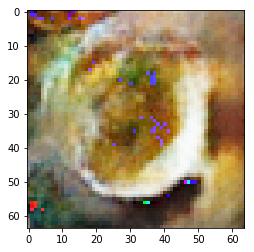

tensor(0.2345, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4118, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


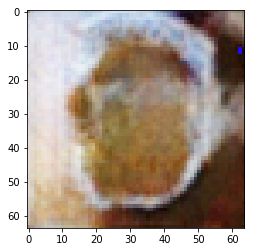

tensor(0.1248, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3764, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


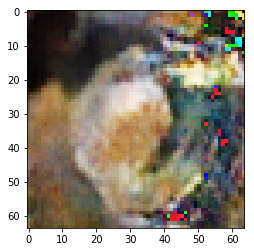

tensor(0.4227, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2579, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


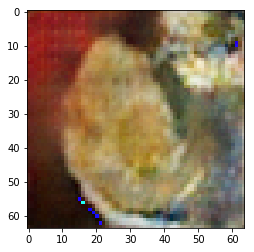

tensor(0.5053, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1368, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


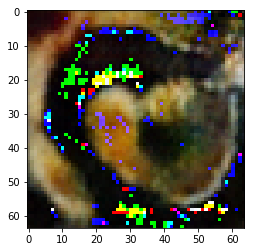

tensor(0.7724, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9768, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


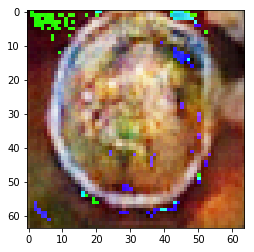

tensor(0.8139, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2934, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


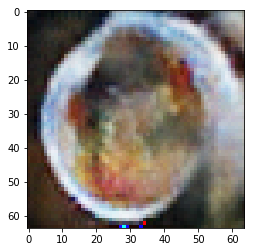

tensor(0.6099, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0551, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


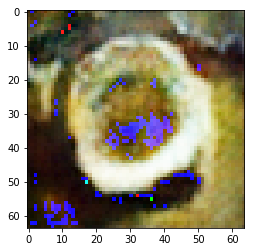

tensor(0.0112, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2982, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


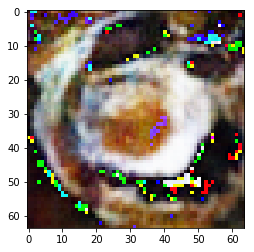

tensor(0.9406, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1591, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


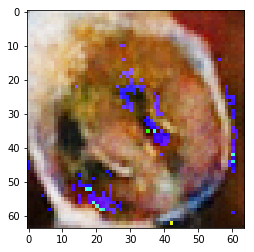

tensor(0.6182, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0343, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


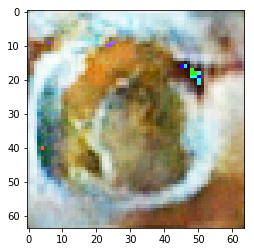

tensor(0.5173, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3717, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


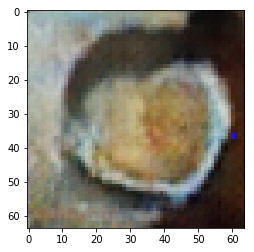

tensor(-0.3371, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3951, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


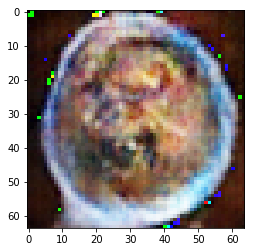

tensor(0.7456, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4275, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


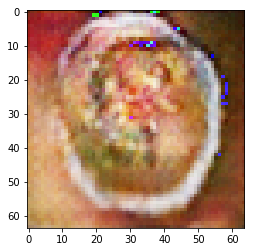

tensor(0.4409, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1188, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


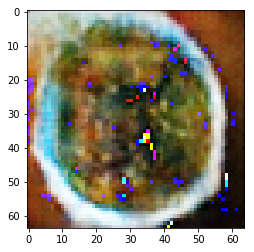

tensor(0.5316, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4585, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


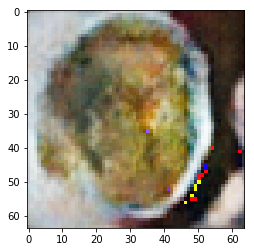

tensor(0.4954, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1424, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


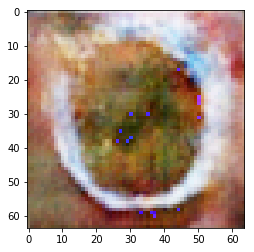

tensor(1.0515, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0320, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


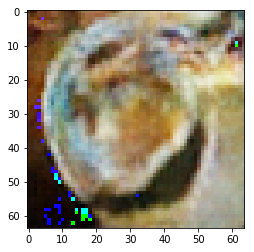

tensor(0.2749, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2484, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


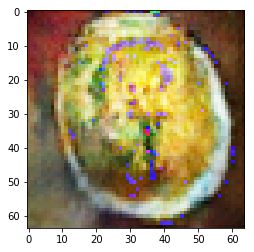

tensor(0.5738, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1356, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


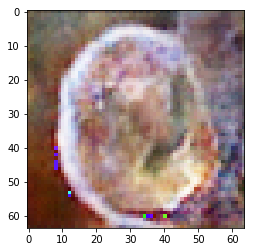

tensor(0.6916, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2103, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


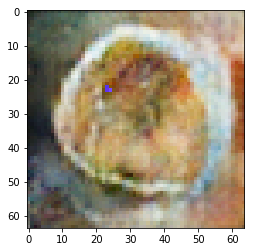

tensor(0.6013, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4733, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


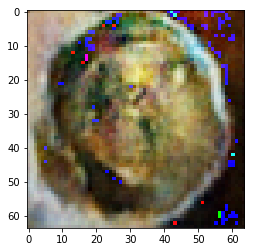

tensor(0.7304, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2145, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


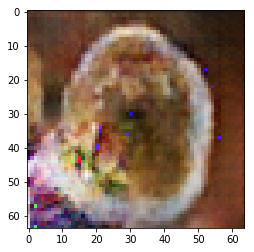

tensor(-0.1974, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2139, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


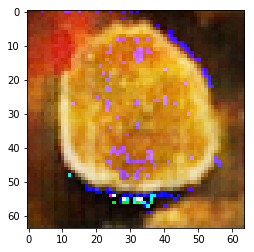

tensor(0.2786, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0756, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


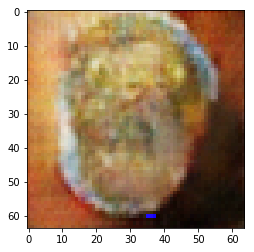

tensor(0.7919, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2514, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


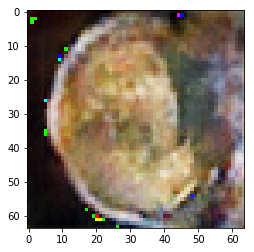

tensor(0.1891, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2521, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


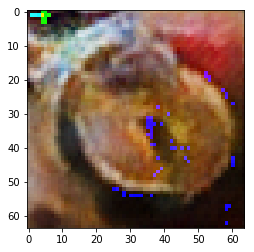

tensor(0.2081, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0849, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


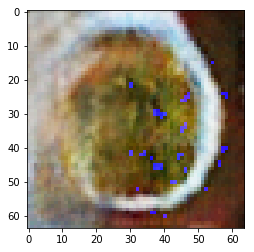

tensor(0.4183, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5158, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


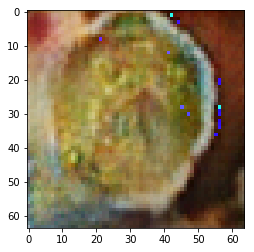

tensor(0.5561, device='cuda:0', grad_fn=<NegBackward>) tensor(0.8478, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


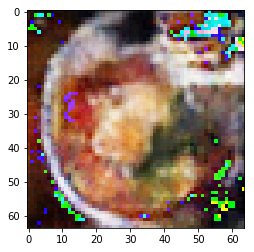

tensor(-0.3260, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3661, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


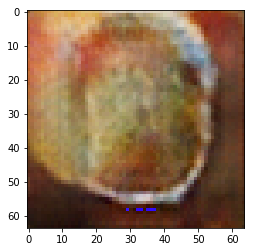

tensor(0.2336, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3572, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


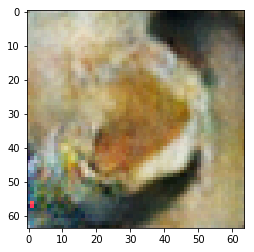

tensor(0.3195, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3090, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


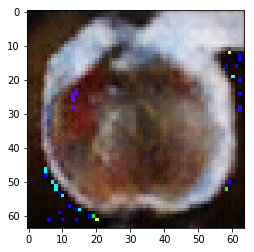

tensor(1.1732, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3984, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


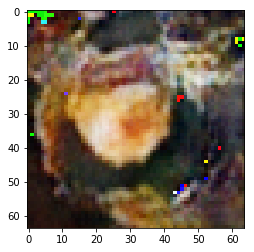

tensor(0.6759, device='cuda:0', grad_fn=<NegBackward>) tensor(1.5055, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


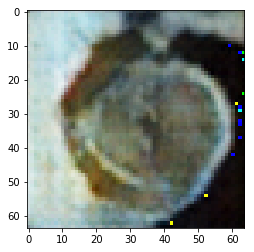

tensor(0.8309, device='cuda:0', grad_fn=<NegBackward>) tensor(0.6507, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


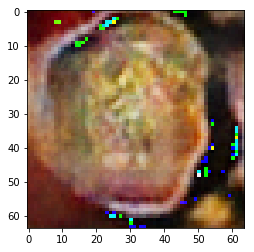

tensor(0.2109, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0418, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


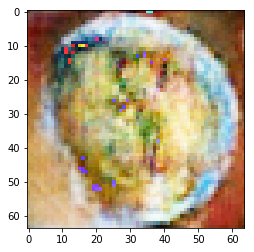

tensor(0.4769, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2721, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


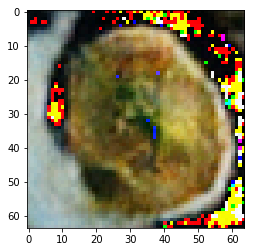

tensor(-0.0144, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3828, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


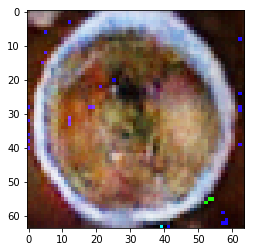

tensor(0.8884, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2478, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


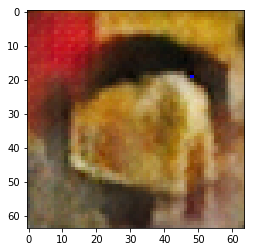

tensor(1.2076, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2276, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


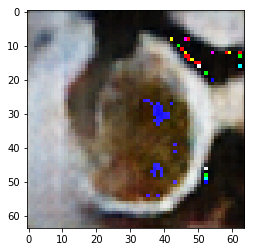

tensor(0.7704, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4215, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


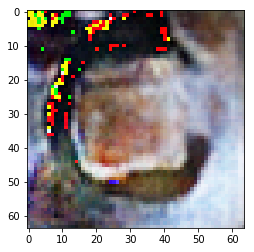

tensor(0.6432, device='cuda:0', grad_fn=<NegBackward>) tensor(0.8619, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


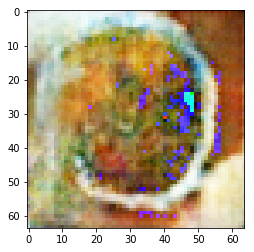

tensor(0.0930, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2260, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


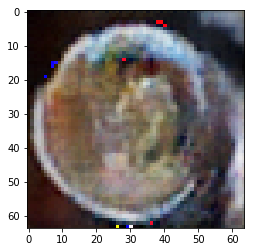

tensor(0.8096, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2310, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


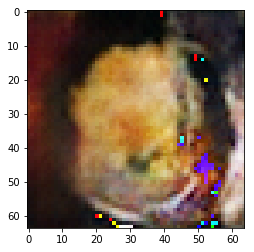

tensor(0.4867, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0425, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


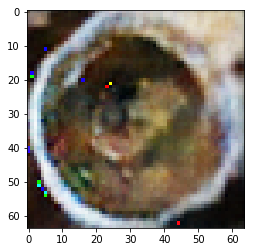

tensor(0.3022, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9790, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


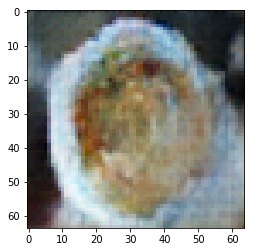

tensor(0.5612, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2558, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


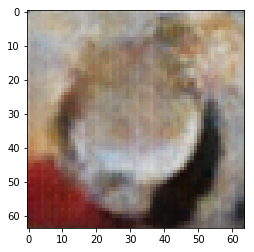

tensor(0.9178, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0871, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


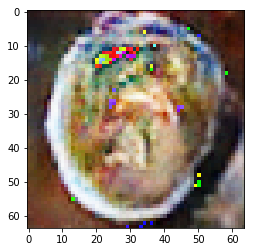

tensor(0.4707, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9196, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


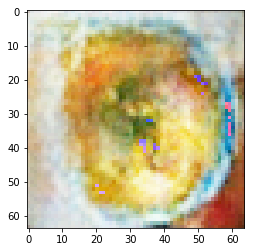

tensor(1.5433, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4975, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


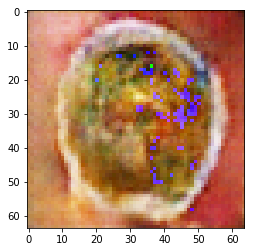

tensor(0.8409, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9704, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


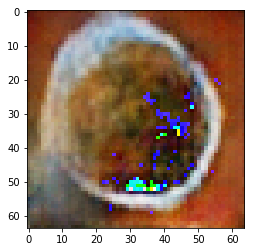

tensor(0.5785, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1762, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


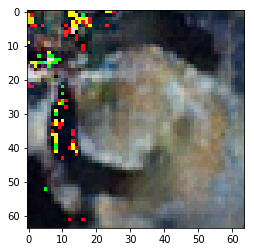

tensor(-0.3268, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4398, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


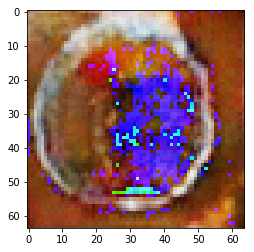

tensor(0.9179, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9905, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


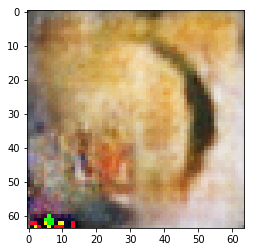

tensor(1.3565, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3834, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


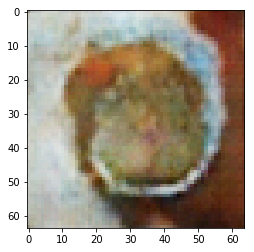

tensor(0.0805, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2421, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


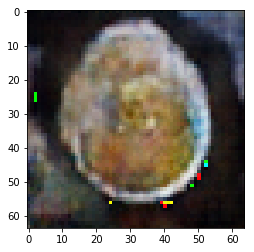

tensor(0.6903, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4339, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


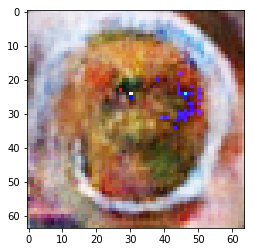

tensor(1.1342, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9553, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


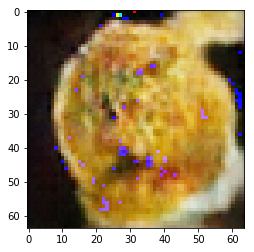

tensor(0.9574, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0933, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


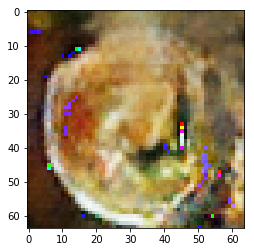

tensor(0.4384, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2752, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


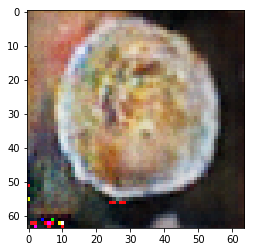

tensor(0.0896, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1993, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


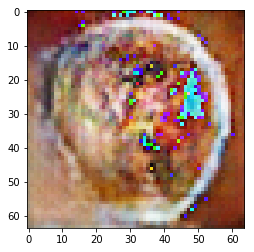

tensor(-0.2810, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4549, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


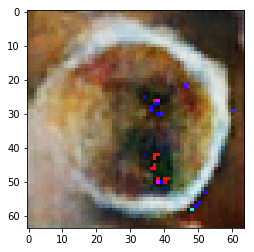

tensor(0.5489, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2599, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


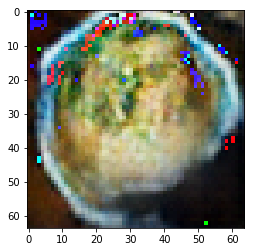

tensor(0.3669, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9157, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


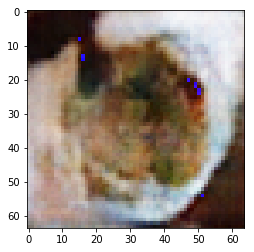

tensor(1.0789, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9991, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


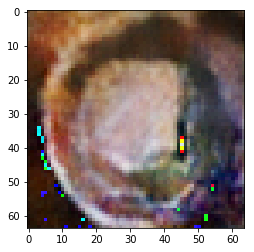

tensor(-0.0136, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2957, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


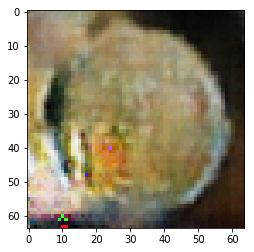

tensor(0.4108, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9921, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


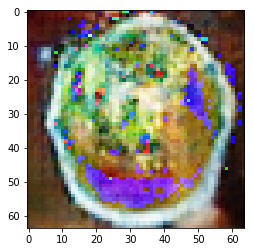

tensor(0.7409, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0003, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


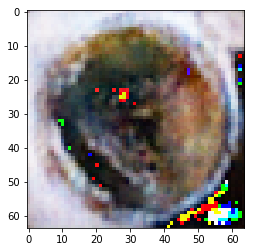

tensor(0.8782, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3272, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


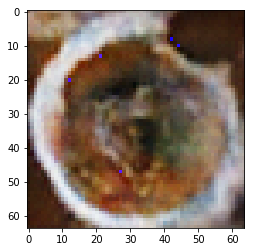

tensor(0.4411, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2296, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


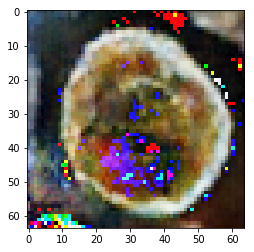

tensor(0.3909, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1171, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


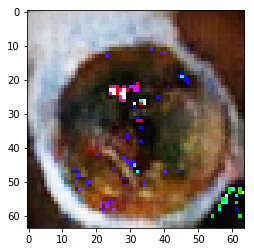

tensor(0.5317, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0581, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


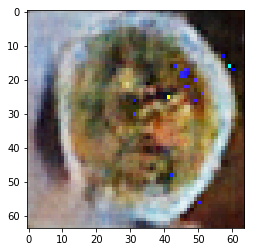

tensor(0.3626, device='cuda:0', grad_fn=<NegBackward>) tensor(0.8603, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


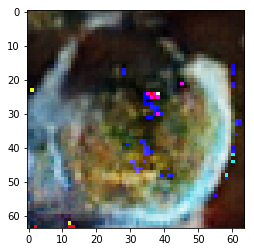

tensor(0.4778, device='cuda:0', grad_fn=<NegBackward>) tensor(0.8485, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


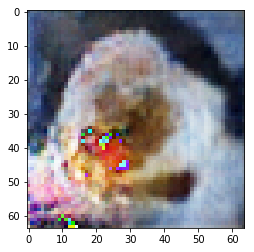

tensor(0.7462, device='cuda:0', grad_fn=<NegBackward>) tensor(0.8929, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


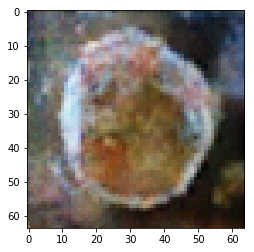

tensor(0.6849, device='cuda:0', grad_fn=<NegBackward>) tensor(0.8894, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


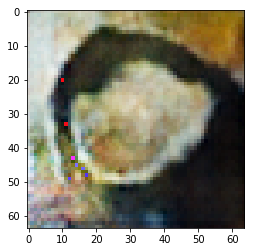

tensor(1.1284, device='cuda:0', grad_fn=<NegBackward>) tensor(0.7013, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


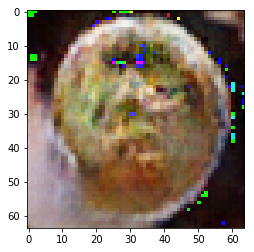

tensor(0.6864, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2863, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


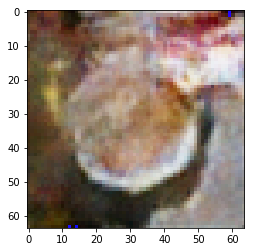

tensor(0.9928, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2561, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


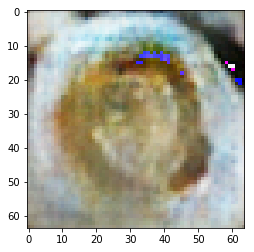

tensor(0.8208, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3442, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


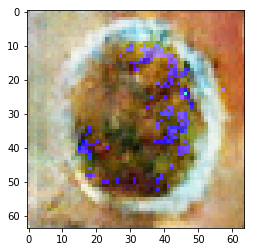

tensor(0.5936, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0867, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


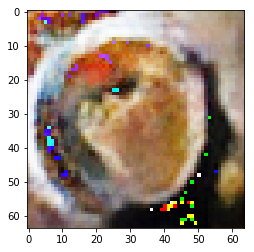

tensor(0.2460, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2185, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


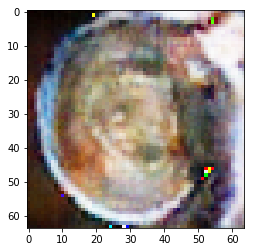

tensor(0.1138, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1209, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


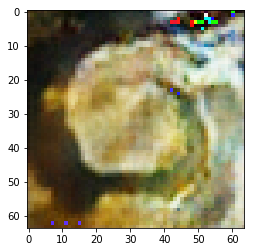

tensor(1.2387, device='cuda:0', grad_fn=<NegBackward>) tensor(1.4916, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


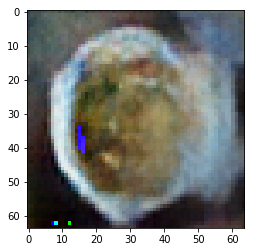

tensor(0.3535, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0838, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


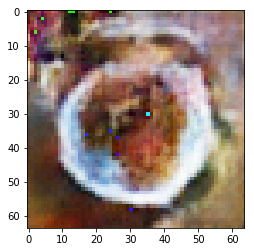

tensor(0.7546, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0038, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


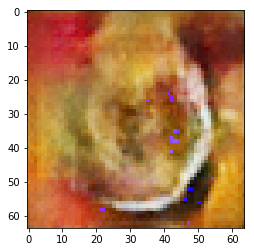

tensor(0.7144, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1007, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


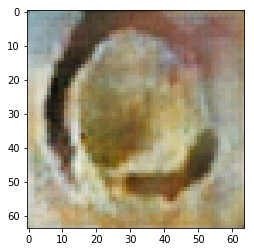

tensor(0.4472, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0151, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


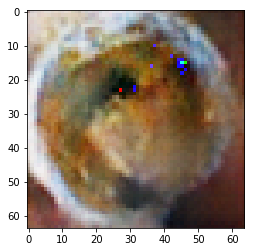

tensor(0.3530, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1714, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


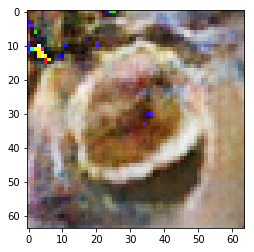

tensor(0.0711, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1824, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


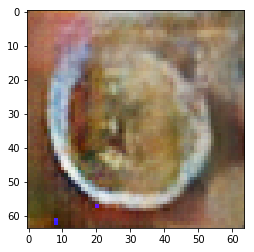

tensor(0.4737, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2244, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


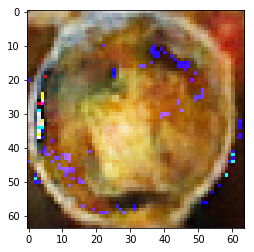

tensor(0.6485, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9378, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


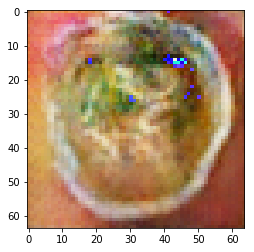

tensor(0.1013, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9597, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


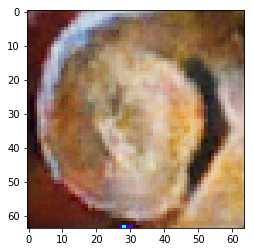

tensor(0.4956, device='cuda:0', grad_fn=<NegBackward>) tensor(0.8713, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


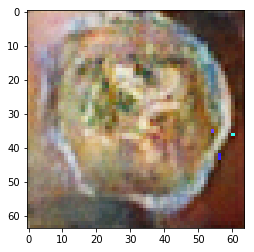

tensor(0.4088, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1844, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


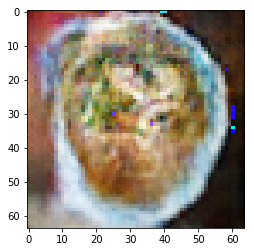

tensor(0.0591, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3509, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


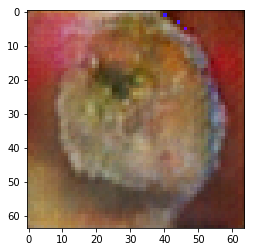

tensor(0.4809, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1936, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


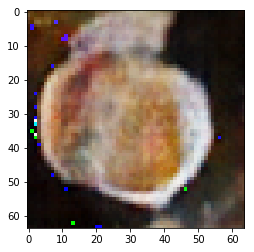

tensor(0.2296, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2210, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


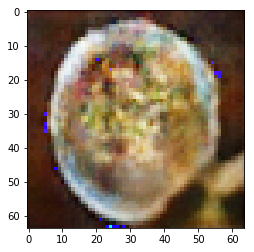

tensor(0.6050, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9742, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


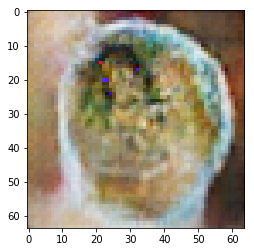

tensor(0.7807, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9045, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


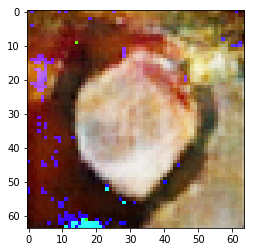

tensor(0.0205, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1650, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


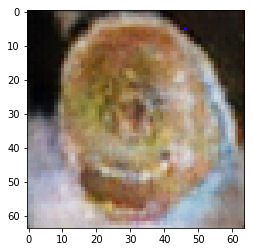

tensor(0.4395, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1620, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


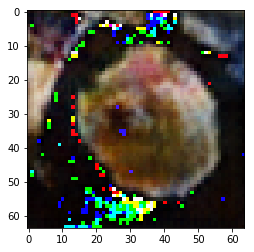

tensor(0.9165, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0871, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


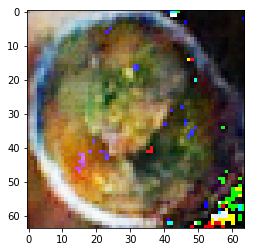

tensor(0.6281, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0534, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


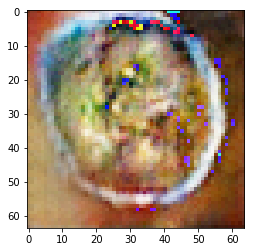

tensor(0.5176, device='cuda:0', grad_fn=<NegBackward>) tensor(0.8643, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


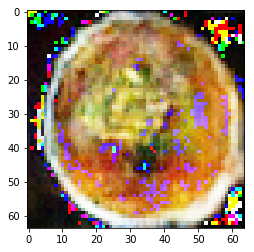

tensor(0.3310, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9121, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


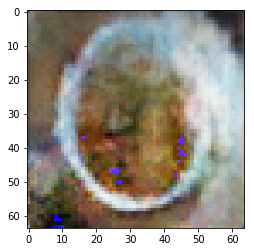

tensor(0.2822, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1963, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


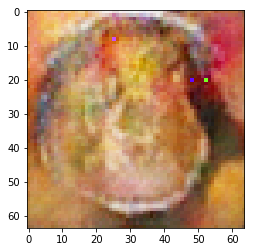

tensor(0.3610, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1330, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


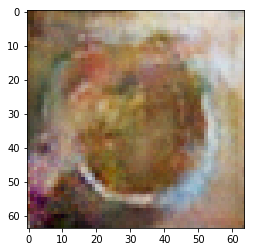

tensor(0.8542, device='cuda:0', grad_fn=<NegBackward>) tensor(0.8485, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


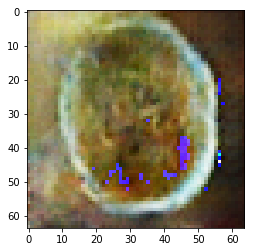

tensor(0.6858, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9860, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


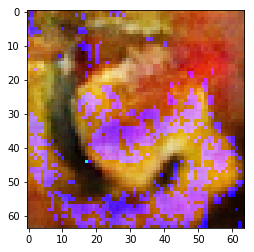

tensor(0.7737, device='cuda:0', grad_fn=<NegBackward>) tensor(0.8228, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


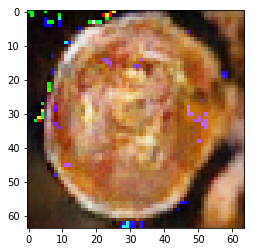

tensor(0.7436, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0507, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


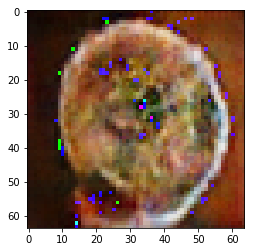

tensor(1.2135, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0462, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


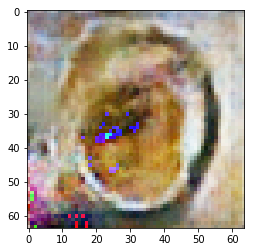

tensor(0.7325, device='cuda:0', grad_fn=<NegBackward>) tensor(1.0682, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


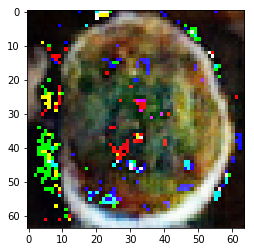

tensor(-0.0214, device='cuda:0', grad_fn=<NegBackward>) tensor(1.2905, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


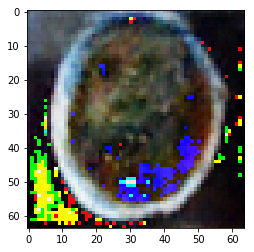

tensor(0.7237, device='cuda:0', grad_fn=<NegBackward>) tensor(0.9372, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


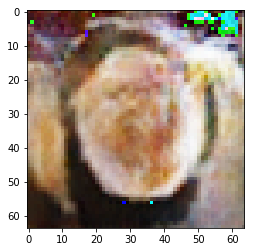

tensor(0.3867, device='cuda:0', grad_fn=<NegBackward>) tensor(1.3200, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


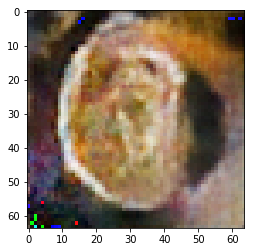

tensor(0.3967, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1700, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


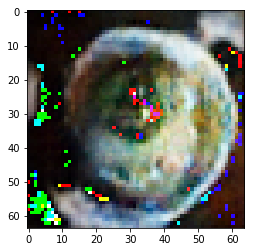

tensor(-0.0563, device='cuda:0', grad_fn=<NegBackward>) tensor(1.1775, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


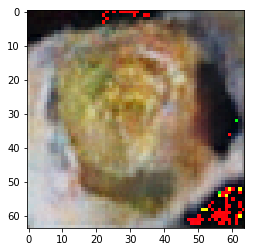

tensor(-0.7099, device='cuda:0', grad_fn=<NegBackward>) tensor(1.7253, device='cuda:0', grad_fn=<MeanBackward0>)
torch.Size([16, 3, 64, 64])


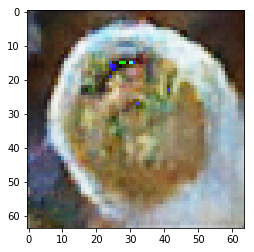

In [113]:
import matplotlib.pyplot as plt
d=Discriminator()
g=Generator()
#d_opt = opt.Adam(params=d.parameters())#
g_opt = opt.Adam(g.parameters(),lr=0.0002, betas=(0.5, 0.999))
d_opt = opt.Adam(d.parameters(),lr=0.0002, betas=(0.5, 0.999))
device = "cuda"
d.to(device)
g.to(device)
batch_size=16
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size, shuffle=True)
a=torch.ones((batch_size),dtype=torch.long).to(device)
zero_tensor=torch.zeros((batch_size)).to(device)
#a=torch.cat((aa,bb),axis=1)
#b=torch.cat((bb,aa),axis=1)
for ep in range(1000):
    for (real,i) in zip(dataloader,range(len(dataloader))):
        if(real.shape[0] != batch_size):
            continue
        real = Variable(real.to(device))
        fake = g(torch.randn((batch_size,100,1,1)).to(device))
        #print(d(fake).shape)
        g_loss = - torch.mean(d(fake))
        g_opt.zero_grad()
        g_loss.backward()
        g_opt.step()
        
        
        d_opt.zero_grad()
        #fake = g(Variable(torch.randn((batch_size,100,1,1))).to(device))
        d_loss = torch.mean(-torch.min(zero_tensor,-1 + d(real)) - torch.min(zero_tensor,-1-d(fake.detach())))
        d_loss.backward()
        d_opt.step()
        if i % 1000 == 0:
            print(g_loss,d_loss)
            trans = transforms.ToPILImage(mode='RGB')
            print(fake.shape)
            plt.imshow(np.array(trans(fake.to("cpu")[0].squeeze())))
            plt.show()
    